<a href="https://colab.research.google.com/github/Pallavi5775/text-gen/blob/main/revised_generator_optimized.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%env CUDA_LAUNCH_BLOCKING=1

env: CUDA_LAUNCH_BLOCKING=1


In [ ]:
!pip install torch torchvision tensorflow keras numpy matplotlib opencv-python


In [1]:
import cv2
import os
import numpy as np
from google.colab import files
import matplotlib.pyplot as plt

In [2]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
!cd "/content/drive/My Drive/image_parts" && ls -lh


total 913M
-rw------- 1 root root 913M Dec 31 18:44 images.zip


In [ ]:
!unzip -tq "/content/drive/Shared with me/images.zip"


unzip:  cannot find or open /content/drive/Shared with me/images.zip, /content/drive/Shared with me/images.zip.zip or /content/drive/Shared with me/images.zip.ZIP.


In [3]:
!unzip "/content/drive/My Drive/image_parts/images.zip" -d "/content/dataset"


Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/images/3_0_2_20161219141852353.jpg  
  inflating: /content/dataset/images/3_0_2_20161219142321097.jpg  
  inflating: /content/dataset/images/3_0_2_20161219142512185.jpg  
  inflating: /content/dataset/images/3_0_2_20161219142551561.jpg  
  inflating: /content/dataset/images/3_0_2_20161219142553649.jpg  
  inflating: /content/dataset/images/3_0_2_20161219151511755.jpg  
  inflating: /content/dataset/images/3_0_2_20161219151938084.jpg  
  inflating: /content/dataset/images/3_0_2_20161219153035532.jpg  
  inflating: /content/dataset/images/3_0_2_20161219154525565.jpg  
  inflating: /content/dataset/images/3_0_2_20161219160003893.jpg  
  inflating: /content/dataset/images/3_0_2_20161219160259510.jpg  
  inflating: /content/dataset/images/3_0_2_20161219160753533.jpg  
  inflating: /content/dataset/images/3_0_2_20161219160801053.jpg  
  inflating: /content/dataset/images/3_0_2_20161219161653119.jpg  
  inflating

In [4]:
import torch
# from torch.utils.data import DataLoader, TensorDataset

# # Define device (use GPU if available)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# device = torch.device('cuda')


In [5]:
def preprocess_images_in_batches(image_dir, output_size=(128, 128), batch_size=64, augment=False):
    """
    Preprocess images in batches to reduce memory usage.

    Parameters:
    - image_dir: Directory containing the images.
    - output_size: Desired size for all images (width, height).
    - batch_size: Number of images to process in one batch.
    - augment: Whether to apply data augmentation.

    Yields:
    - Batch of preprocessed images and labels.
    """
    images, labels = [], []
    valid_extensions = ('.jpg', '.jpeg', '.png')

    for file_name in os.listdir(image_dir):
        if not file_name.lower().endswith(valid_extensions):
            continue

        file_path = os.path.join(image_dir, file_name)
        img = cv2.imread(file_path)
        if img is not None:
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            img = cv2.resize(img, output_size)
            img = img / 127.5 - 1

            try:
                age = int(file_name.split('_')[0])
                age_group = age // 10
                images.append(img)
                labels.append(age_group)

                # Data augmentation (optional)
                if augment:
                    flipped_img = np.fliplr(img)
                    images.append(flipped_img)
                    labels.append(age_group)

                # Yield batch when batch size is reached
                if len(images) >= batch_size:
                    yield np.array(images), np.array(labels)
                    images, labels = [], []  # Reset for the next batch
            except ValueError:
                print(f"Skipping file {file_name}: Unable to extract age")

    # Yield the final batch if any images are left
    if images:
        yield np.array(images), np.array(labels)



In [6]:
import cv2
import os
import numpy as np
from collections import Counter
from sklearn.utils import resample
def balance_dataset_in_batches(images, labels, batch_size=64):
    """
    Balance the dataset in batches.

    Parameters:
    - images: Array of images.
    - labels: Array of labels corresponding to images.
    - batch_size: Number of samples per batch.

    Yields:
    - Balanced batch of images and labels.
    """
    unique_labels = np.unique(labels)

    # Calculate the maximum number of samples per label for the batch
    min_samples_per_batch = batch_size // len(unique_labels)

    # Split into batches
    for start_idx in range(0, len(labels), batch_size):
        end_idx = start_idx + batch_size
        batch_images, batch_labels = images[start_idx:end_idx], labels[start_idx:end_idx]

        # Balance the batch
        balanced_images, balanced_labels = [], []
        label_indices = {label: np.where(batch_labels == label)[0] for label in unique_labels}

        for label in unique_labels:
            indices = label_indices[label]
            sampled_indices = resample(indices, n_samples=min_samples_per_batch, random_state=42)
            balanced_images.extend(batch_images[sampled_indices])
            balanced_labels.extend(batch_labels[sampled_indices])

        yield np.array(balanced_images), np.array(balanced_labels)

In [7]:
import os
import numpy as np
from sklearn.model_selection import train_test_split
image_dir = "/content/dataset/images"
# Directories for saving training and validation data
train_dir = "/content/dataset/train"
val_dir = "/content/dataset/val"
os.makedirs(train_dir, exist_ok=True)
os.makedirs(val_dir, exist_ok=True)

# Counter for naming batches
train_counter, val_counter = 0, 0

# Preprocess, balance, and split batches
for images_batch, labels_batch in preprocess_images_in_batches(image_dir, batch_size=64, augment=True):
    print(f"Processed batch of {len(images_batch)} images.")

    # Balance each batch
    for balanced_images_batch, balanced_labels_batch in balance_dataset_in_batches(images_batch, labels_batch, batch_size=64):
        print(f"Balanced batch of {len(balanced_images_batch)} images.")

        # Split balanced batch into training and validation
        X_train, X_val, y_train, y_val = train_test_split(
            balanced_images_batch, balanced_labels_batch, test_size=0.2, random_state=42
        )

        # Save training data
        train_images_path = os.path.join(train_dir, f"images_batch_{train_counter}.npy")
        train_labels_path = os.path.join(train_dir, f"labels_batch_{train_counter}.npy")
        np.save(train_images_path, X_train)
        np.save(train_labels_path, y_train)
        train_counter += 1

        # Save validation data
        val_images_path = os.path.join(val_dir, f"images_batch_{val_counter}.npy")
        val_labels_path = os.path.join(val_dir, f"labels_batch_{val_counter}.npy")
        np.save(val_images_path, X_val)
        np.save(val_labels_path, y_val)
        val_counter += 1

print(f"Saved {train_counter} training batches and {val_counter} validation batches.")






Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 64 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 64 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 64 images.
Processed batch of 64 images.
Balanced batch of 60 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 64 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 63 images.
Processed batch of 64 images.
Balanced batch of 64 images.
Processed batch of 64 images.
Balanced batch of 63 image

In [8]:
train_dir = "/content/dataset/train"
val_dir = "/content/dataset/val"

def load_batches_from_disk(batch_dir):
    """
    Generator to load saved batches of images and labels from disk.

    Parameters:
    - batch_dir: Directory containing the saved batches.

    Yields:
    - images: Loaded images for the batch.
    - labels: Loaded labels for the batch.
    """
    batch_files = sorted(os.listdir(batch_dir))
    images_files = [f for f in batch_files if "images_batch" in f]
    labels_files = [f for f in batch_files if "labels_batch" in f]

    for img_file, lbl_file in zip(images_files, labels_files):
        images = np.load(os.path.join(batch_dir, img_file))
        labels = np.load(os.path.join(batch_dir, lbl_file))
        yield images, labels


In [9]:
import torch.nn as nn

def reinitialize_weights(module, gradient_threshold=1e-3, gradient_map=None):
    """
    Reinitialize weights of a module selectively if their gradients are too small.
    """
    if gradient_map is not None:
        # Skip reinitialization for layers with sufficient gradients
        layer_name = module._get_name()
        if layer_name in gradient_map and gradient_map[layer_name] > gradient_threshold:
            return

    if isinstance(module, (nn.Conv2d, nn.ConvTranspose2d)):
        # Use Kaiming Initialization for convolutional layers
        nn.init.kaiming_normal_(module.weight, mode='fan_out', nonlinearity='leaky_relu')
        if module.bias is not None:
            nn.init.constant_(module.bias, 0)
    elif isinstance(module, nn.Linear):
        # Use Xavier Initialization for fully connected layers
        nn.init.xavier_uniform_(module.weight)
        if module.bias is not None:
            nn.init.constant_(module.bias, 0)
    elif isinstance(module, nn.BatchNorm2d):
        # Initialize BatchNorm layers
        nn.init.constant_(module.weight, 1)
        nn.init.constant_(module.bias, 0)
    elif isinstance(module, nn.GroupNorm):
        # Initialize GroupNorm layers
        nn.init.constant_(module.weight, 1)
        nn.init.constant_(module.bias, 0)



In [10]:
import torch.nn.functional as F

def preprocess_labels(labels, num_classes, image_size):
    """
    Converts scalar labels to one-hot encoded spatial labels.
    Args:
        labels (torch.Tensor): Scalar labels of shape (batch_size,)
        num_classes (int): Number of classes
        image_size (tuple): (height, width)
    Returns:
        torch.Tensor: One-hot encoded labels with spatial dimensions
    """
    batch_size = labels.size(0)
    # Convert scalar labels to one-hot encoding
    one_hot = F.one_hot(labels.long(), num_classes=num_classes).float()  # Shape: (batch_size, num_classes)
    # Add spatial dimensions
    one_hot = one_hot.unsqueeze(-1).unsqueeze(-1)  # Shape: (batch_size, num_classes, 1, 1)
    # Expand to match image dimensions
    one_hot = one_hot.expand(-1, -1, image_size[0], image_size[1])  # Shape: (batch_size, num_classes, height, width)
    return one_hot


In [11]:
import torch
import torch.nn as nn
import torch.nn.functional as F

class ResidualBlock(nn.Module):
    def __init__(self, in_channels, out_channels, downsample=False, norm_type="SpectralNorm"):
        super(ResidualBlock, self).__init__()
        if norm_type == "BatchNorm":
            norm_layer = nn.BatchNorm2d(out_channels)
        elif norm_type == "GroupNorm":
            norm_layer = nn.GroupNorm(num_groups=min(8, out_channels // 4), num_channels=out_channels)
        elif norm_type == "InstanceNorm":
            norm_layer = nn.InstanceNorm2d(out_channels, affine=True)
        else:  # Default to SpectralNorm
            norm_layer = nn.Identity()

        self.conv1 = nn.utils.spectral_norm(
            nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=1, padding=1)
        )
        self.conv2 = nn.utils.spectral_norm(
            nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1 if not downsample else 2, padding=1)
        )
        self.skip = nn.utils.spectral_norm(
            nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=1 if not downsample else 2)
        )
        self.norm = norm_layer
        self.dropout = nn.Dropout(0.3)  # Add dropout with a probability of 0.3
        self.relu = nn.LeakyReLU(0.2, inplace=True)

    def forward(self, x):
        residual = self.conv1(x)
        residual = self.relu(residual)
        residual = self.conv2(residual)
        residual = self.dropout(self.norm(residual))  # Apply dropout
        skip = self.skip(x)
        out = residual + skip
        return self.relu(out)
class Discriminator(nn.Module):
    def __init__(self, image_channels, num_classes):
        super(Discriminator, self).__init__()

        input_channels = image_channels + num_classes

        # Initial convolution block
        self.initial_conv = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=4, stride=2, padding=1),  # 64x64 -> 32x32
            nn.LeakyReLU(0.2, inplace=True),
        )

        # Residual blocks for downsampling
        self.residual_blocks = nn.Sequential(
            ResidualBlock(64, 128, downsample=True),  # 32x32 -> 16x16
            ResidualBlock(128, 256, downsample=True),  # 16x16 -> 8x8
            ResidualBlock(256, 512, downsample=True),  # 8x8 -> 4x4
        )

        # Minibatch discrimination
        self.minibatch_discrimination = nn.Sequential(
            nn.Flatten(),
            nn.Linear(512 * 4 * 4, 128),  # Adjust for 64x64 inputs
            nn.ReLU(inplace=True),
            nn.Linear(128, 64),
        )

        # Shared feature extractor
        self.shared_out = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, stride=1, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3),  # Add Dropout here
            nn.Conv2d(256, 128, kernel_size=3, stride=1, padding=1),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Dropout2d(0.3),  # Add Dropout here
        )

        # Outputs
        self.patch_out = nn.Sequential(
            nn.Conv2d(128, 1, kernel_size=3, stride=1, padding=1),
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Flatten(),
        )

        self.aux_classifier = nn.Sequential(
            nn.Conv2d(128, num_classes, kernel_size=3, stride=1, padding=1),
            nn.Dropout2d(0.3),  # Add Dropout for spatial features
            nn.AdaptiveAvgPool2d((1, 1)),
            nn.Flatten(),
            nn.Dropout(0.3),  # Add Dropout for fully connected layers
        )

    def forward(self, images, labels):
        print("Inside Discriminator ..............................")

        # Preprocess Labels
        label_channels = self.aux_classifier[0].out_channels
        labels = preprocess_labels(labels, label_channels, images.shape[2:])
        labels = labels.clone()  # Clone to avoid shared memory issues
        labels += torch.normal(0, 0.1, labels.shape).to(labels.device)  # Add Gaussian noise
        labels = torch.clamp(labels, 0, 1)  # Clamp values between 0 and 1

        print("Shape of images:", images.shape)
        print("Shape of labels:", labels.shape)

        # Concatenate images and labels
        x = torch.cat([images, labels], dim=1)
        print("Input Shape to initial_conv:", x.shape)

        # Forward pass
        out = self.initial_conv(x)
        out = self.residual_blocks(out)
        minibatch_features = self.minibatch_discrimination(out)
        out = self.shared_out(out)

        # Outputs
        validity = self.patch_out(out)
        aux_pred = self.aux_classifier(out)

        print("Validity Shape:", validity.shape)
        print("Auxiliary Prediction Shape:", aux_pred.shape)

        return validity, aux_pred



In [12]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.checkpoint import checkpoint

class ScaledResidualBlock(nn.Module):
    def __init__(self, channels, scale=0.1, norm_type="GroupNorm"):
        super(ScaledResidualBlock, self).__init__()
        self.scale = scale
        if norm_type == "BatchNorm":
            norm_layer = nn.BatchNorm2d(channels)
        elif norm_type == "InstanceNorm":
            norm_layer = nn.InstanceNorm2d(channels, affine=True)
        else:  # Default to GroupNorm
            norm_layer = nn.GroupNorm(num_groups=min(8, channels // 4), num_channels=channels)

        self.block = nn.Sequential(
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1),
            norm_layer,
            nn.Dropout(0.3),  # Add dropout with a probability of 0.3
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(channels, channels, kernel_size=3, stride=1, padding=1),
            norm_layer,
        )

    def forward(self, x):
        residual = self.block(x)
        return x + self.scale * residual



class AttentionBlock(nn.Module):
    def __init__(self, channels):
        super(AttentionBlock, self).__init__()
        self.attention = nn.Conv2d(channels, 1, kernel_size=1)

    def forward(self, x):
        attention_map = torch.sigmoid(self.attention(x))
        return x * attention_map

class Generator(nn.Module):
    def __init__(self, noise_dim, output_dim, label_dim, height=64, width=64):
        super(Generator, self).__init__()
        self.noise_dim = noise_dim
        self.label_dim = label_dim
        self.height = height
        self.width = width

        # Label embedding
        self.label_embedding = nn.Linear(label_dim, noise_dim)

        # Fully connected layers
        self.fc = nn.Sequential(
            nn.Linear(noise_dim * 2, 256 * 4 * 4),  # Input dimension matches combined noise and label size
            nn.LayerNorm([256 * 4 * 4]),
            nn.LeakyReLU(0.2, inplace=True),
        )

        # Add a downsampling layer to reduce channels from 256 to 128
        self.downsample = nn.Conv2d(256, 128, kernel_size=1, stride=1)

        # Residual blocks
        self.res_blocks = nn.Sequential(
            ScaledResidualBlock(128),
            ScaledResidualBlock(128),
        )

        # Attention block
        self.attention = AttentionBlock(128)

        # Deconvolution layers for \(64 \times 64\) output
        self.deconv = nn.Sequential(
            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),  # 4x4 -> 8x8
            nn.Conv2d(128, 64, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),  # 8x8 -> 16x16
            nn.Conv2d(64, 32, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(32),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),  # 16x16 -> 32x32
            nn.Conv2d(32, 16, kernel_size=3, stride=1, padding=1),
            nn.BatchNorm2d(16),
            nn.LeakyReLU(0.2, inplace=True),

            nn.Upsample(scale_factor=2, mode='bilinear', align_corners=False),  # 32x32 -> 64x64
            nn.Conv2d(16, output_dim, kernel_size=3, stride=1, padding=1),
            nn.Tanh(),
        )


    def forward(self, noise, labels_one_hot):

        print("Inside Generator .............................")
        # Embed labels and concatenate with noise
        print("Shape of labels before processing:", labels_one_hot.shape)
        assert labels_one_hot.size(1) == self.label_dim, "Label dimension mismatch!"
        print("Label embedding input shape:", labels_one_hot.shape)
        embedded_labels = self.label_embedding(labels_one_hot.float())


        print("Shape after embedded_labels:", embedded_labels.shape)
        combined = torch.cat([noise, embedded_labels], dim=1)
        print("Shape of combined (noise + embedded labels):", combined.shape)  # [51, 200]
        # Fully connected layers
        out = self.fc(combined)
        print("Shape after self.fc:", out.shape)
        batch_size = out.size(0)
        out = out.view(batch_size, 256, 4, 4)

        print("Shape after reshaping out:", out.shape)


        out = self.downsample(out)  # Reduce channels to 128

        print("Shape after downsampling out:", out.shape)

        # Residual blocks with global skip connection
        residual = out
        out = self.res_blocks(out)
        out += residual

        print("Shape after residual block:", out.shape)

        # Attention block
        out = self.attention(out)

        print("Shape after Attention block:", out.shape)

        # Noise injection
        noise_injection = torch.randn_like(out) * 0.1
        out += noise_injection

        print("Shape after Noise injection:", out.shape)

        print("Shape before deconvolution:", out.shape)

        # Deconvolution layers
        out = self.deconv(out)

        print("Final shape deconvolution:", out.shape)

        print("Min pixel value:", out.min().item())
        print("Max pixel value:", out.max().item())

        print("Shape after Deconvolution layers:", out.shape)

        return out


In [13]:
class PerceptualLoss(nn.Module):
    def __init__(self, feature_extractor):
        super(PerceptualLoss, self).__init__()
        self.feature_extractor = feature_extractor.eval()  # Freeze VGG
        for param in self.feature_extractor.parameters():
            param.requires_grad = False

    def forward(self, input, target):
        # Match batch sizes
        min_batch_size = min(input.size(0), target.size(0))
        input = input[:min_batch_size]
        target = target[:min_batch_size]

        # Ensure input and target have the same spatial dimensions
        if input.size(2) != target.size(2) or input.size(3) != target.size(3):
            target = F.interpolate(target, size=(input.size(2), input.size(3)), mode='bilinear', align_corners=False)

        # Debug shapes
        print(f"Input shape: {input.shape}, Target shape: {target.shape}")

        # Extract features
        input_features = self.feature_extractor(input)
        target_features = self.feature_extractor(target)

        # Debug feature shapes
        print(f"Input features shape: {input_features.shape}, Target features shape: {target_features.shape}")

        # Compute MSE loss between features
        return F.mse_loss(input_features, target_features)




In [14]:
def age_consistency_loss(predicted_ages, target_ages):
    # Flatten predictions to [batch_size * height * width, num_classes]
    batch_size, num_classes, height, width = predicted_ages.size()
    predicted_ages = predicted_ages.permute(0, 2, 3, 1).reshape(-1, num_classes)

    # Expand target to match [batch_size * height * width]
    target_ages = target_ages.unsqueeze(1).unsqueeze(2).expand(-1, height, width).reshape(-1)

    # Compute cross-entropy loss
    return F.cross_entropy(predicted_ages, target_ages)


In [15]:
def train_discriminator(real_images, labels, device, lambda_gp, all_labels, discriminator, generator, real_labels, accumulation_steps, optimizer_discriminator, mean_real_data, std_real_data,epoch, max_epochs):
    """
    Train the discriminator dynamically with optimized memory usage.
    """



    num_classes = all_labels
    print(f"all_labels------------------------>{all_labels}")
    print(f"labels------------------------>{labels}")
    real_images = real_images.to(device).float() / 127.5 - 1.0

    # Apply Instance Noise to Real Images
    noise_std = 0.1  * (1 - epoch / max_epochs)
    real_images_noisy = real_images + torch.randn_like(real_images) * noise_std
    print(f"Shape of Real Images (with Noise): {real_images_noisy.shape}")

    # Forward Pass for Real Images
    real_validity, real_aux_pred = discriminator(real_images_noisy, labels)
    real_validity = real_validity / 10.0  # Normalize validity scores

    print("Validity Shape:", real_validity.shape)  # Output for patch-level validity
    print("Auxiliary Prediction Shape:", real_aux_pred.shape)  # Output for auxiliary classification

    adversarial_loss = nn.BCEWithLogitsLoss()  # Combines sigmoid and BCE for numerical stability

    # Label Smoothing for Real Labels
    real_label_tensor = torch.full(real_validity.size(), 0.9).to(device)  # Real labels = 0.9 (smoothed)
    adv_loss_real = adversarial_loss(real_validity, real_label_tensor)

    # Classification Loss for Real Images
    classification_loss = nn.CrossEntropyLoss()
    aux_loss_real = classification_loss(real_aux_pred, real_labels)

    # Generate Fake Images
    z = torch.randn(real_images.size(0), 100).to(device) * std_real_data + mean_real_data
    labels_one_hot = F.one_hot(labels.long(), num_classes).to(device)
    fake_images = generator(z, labels_one_hot)

    print(f"Min pixel value: {fake_images.min().item()}, Max pixel value: {fake_images.max().item()}")
    print("Shape of real images:", real_images.shape)
    print("Shape of fake images:", fake_images.shape)

    # Apply Instance Noise to Fake Images
    fake_images_noisy = fake_images + torch.randn_like(fake_images) * noise_std
    print(f"Shape of Fake Images (with Noise): {fake_images_noisy.shape}")

    # Forward Pass for Fake Images
    fake_validity, fake_aux_pred = discriminator(fake_images_noisy.detach(), labels)
    fake_validity = fake_validity / 10.0  # Normalize validity scores

    # Adversarial Loss for Fake Images
    fake_label_tensor = torch.full(fake_validity.size(), 0.1).to(device)  # Fake labels = 0.1 (smoothed)
    adv_loss_fake = adversarial_loss(fake_validity, fake_label_tensor)

    # Classification Loss for Fake Images
    aux_loss_fake = classification_loss(fake_aux_pred, labels)

    # Combine Losses
    d_loss_adv = (adv_loss_real + adv_loss_fake) / 2  # Adversarial loss for real and fake
    d_loss_aux = (aux_loss_real + aux_loss_fake) / 2  # Auxiliary classification loss

    # Total Discriminator Loss
    aux_weight = 0.5  # Adjust weight as needed
    d_loss = d_loss_adv + aux_weight * d_loss_aux

    # Optional: Gradient Penalty (for WGAN-GP)
    if lambda_gp > 0:
        alpha = torch.rand(real_images.size(0), 1, 1, 1).to(device)
        interpolates = (alpha * real_images + (1 - alpha) * fake_images).requires_grad_(True)
        interpolates_labels = labels[:real_images.size(0)]  # Align labels
        interpolates_validity, _ = discriminator(interpolates, interpolates_labels)
        gradients = torch.autograd.grad(
            outputs=interpolates_validity,
            inputs=interpolates,
            grad_outputs=torch.ones(interpolates_validity.size()).to(device),
            create_graph=True,
            retain_graph=True,
            only_inputs=True,
        )[0]
        gradients = gradients.view(gradients.size(0), -1)
        gradient_penalty_weight = lambda_gp if lambda_gp > 0 else 0.1
        gradient_penalty = gradient_penalty_weight * ((gradients.norm(2, dim=1) - 1) ** 2).mean()
        d_loss += gradient_penalty

        print(f"Gradient Norm: {gradients.norm(2, dim=1).mean().item()}")

    # Normalize Loss for Accumulation Steps (if using gradient accumulation)
    d_loss = d_loss / accumulation_steps

    # Backward Pass and Update Discriminator
    d_loss.backward()
    torch.nn.utils.clip_grad_norm_(discriminator.parameters(), max_norm=1.0)

    for name, param in discriminator.named_parameters():
        if param.grad is not None:
            print(f"Discriminator Gradient Norm for {name}: {param.grad.norm().item()}")
    optimizer_discriminator.step()

    del generator, discriminator, z, labels, labels_one_hot, fake_images

    # Log Losses
    print(f"Adversarial Loss (Real): {adv_loss_real.item():.4f}")
    print(f"Adversarial Loss (Fake): {adv_loss_fake.item():.4f}")
    print(f"Auxiliary Loss (Real): {aux_loss_real.item():.4f}")
    print(f"Auxiliary Loss (Fake): {aux_loss_fake.item():.4f}")
    torch.cuda.empty_cache()

    return d_loss


In [16]:
import torch
from torchvision.models import inception_v3
from torchvision.transforms import Resize
from scipy.linalg import sqrtm
import numpy as np

def calculate_fid(real_images, fake_images, device):
    # Load the InceptionV3 model
    real_features = inception_v3(pretrained=True).eval().to(device)
    fake_features = inception_v3(pretrained=True).eval().to(device)

    # Reshape images to match InceptionV3 input
    resize = Resize((299, 299))  # Define resizing transformation
    real_images = resize(real_images)
    fake_images = resize(fake_images)

    # Move images to the same device as the model
    real_images = real_images.to(device)
    fake_images = fake_images.to(device)

    # Extract features
    with torch.no_grad():  # Disable gradient computation
        real_outputs = real_features(real_images)
        fake_outputs = fake_features(fake_images)

    # Calculate mean and covariance
    real_mu = real_outputs.mean(dim=0)
    real_sigma = torch.cov(real_outputs.T)

    fake_mu = fake_outputs.mean(dim=0)
    fake_sigma = torch.cov(fake_outputs.T)

    # Calculate FID
    diff = real_mu.cpu().numpy() - fake_mu.cpu().numpy()
    cov_mean = sqrtm(real_sigma.cpu().numpy() @ fake_sigma.cpu().numpy())
    if np.iscomplexobj(cov_mean):
        cov_mean = cov_mean.real
    fid = diff.dot(diff) + np.trace(real_sigma.cpu().numpy() + fake_sigma.cpu().numpy() - 2 * cov_mean)
    return fid


In [17]:
import torchvision
import matplotlib.pyplot as plt
from torch.nn.functional import cosine_similarity
def train_generator(device, labels, real_images, num_classes, perceptual_loss_fn, discriminator, generator,epoch,batch_idx, generator_optimizer,epochs):
    """
    Train the generator dynamically with optimized memory usage.
    """
    fid_threshold=50
    eval_interval=5
    enable_perceptual_loss=False
    # Initial setup and noise generation
    output_dim = real_images.size(1)  # Number of channels in real images
    noise_dim = 100  # Dimension of latent space


    # Generate noise and labels
    noise = torch.randn(real_images.size(0), noise_dim, device=device) * 2

    # labels = torch.randint(0, num_classes, (real_images.size(0),), device=device)
    labels_generator = F.one_hot(labels.long(), num_classes=num_classes).float()

    # Generate fake images
    fake_images = generator(noise, labels_generator)


    print(f"Min pixel value: {fake_images.min()}, Max pixel value: {fake_images.max()}")


    validity_fake, age_fake_pred = discriminator(fake_images, labels)

    print(f"Discriminator output for fake images (validity_fake): {validity_fake.mean().item()}")

    print(f"Shape of age_fake_pred_pooled: {age_fake_pred.shape}")
    print(f"Shape of labels: {labels.shape}")
    # Adversarial loss (WGAN)
    adv_loss = -validity_fake.mean() / 1000.0  # Normalize validity

    print(f"Shape of labels for aux_loss: {labels.shape}")  # Expected: [batch_size]
    print(f"Labels range for aux_loss: {labels.min().item()} to {labels.max().item()}")  # Should be within [0, num_classes-1]

    aux_loss = F.cross_entropy(age_fake_pred, labels)
    print(f"Auxiliary loss: {aux_loss.item()}")


    # Prepare label maps for real and fake images
    label_channels = discriminator.aux_classifier[0].out_channels  # Number of classes
    labels_one_hot = F.one_hot(labels.long(), num_classes).to(fake_images.device)  # [batch_size, num_classes]
    labels_one_hot = labels_one_hot.unsqueeze(-1).unsqueeze(-1)  # Add height and width dimensions
    labels_one_hot = labels_one_hot.expand(-1, -1, real_images.size(2), real_images.size(3))  # Match image dimensions

    # Concatenate label maps with real and fake images
    real_images_with_labels = torch.cat([real_images, labels_one_hot], dim=1)
    fake_images_with_labels = torch.cat([fake_images, labels_one_hot], dim=1)


    real_features = discriminator.initial_conv(real_images_with_labels)
    real_features = discriminator.residual_blocks(real_features)
    real_features = discriminator.shared_out(real_features)

    fake_features = discriminator.initial_conv(fake_images_with_labels)
    fake_features = discriminator.residual_blocks(fake_features)
    fake_features = discriminator.shared_out(fake_features)

    # Calculate feature matching loss
    feature_matching_loss = F.mse_loss(fake_features, real_features)
    # Diversity loss
    noise1 = torch.randn_like(noise)
    noise2 = torch.randn_like(noise)
    fake_images1 = generator(noise1, labels_generator)
    fake_images2 = generator(noise2, labels_generator)
    # Compute diversity loss using cosine similarity
    diversity_loss = -torch.mean(
    F.cosine_similarity(fake_images1.flatten(1), fake_images2.flatten(1), dim=1)
)


    # Total generator loss
    perceptual_loss = (
    perceptual_loss_fn(fake_images, real_images)
    if perceptual_loss_fn is not None
    else torch.tensor(0.0, requires_grad=True, device=device)
)
    diversity_weight = 0.2
    # With perceptual loss
    if epoch < 5:  # First 10 epochs focus on adversarial loss
        g_loss = adv_loss
    else:
        g_loss = (
    0.6 * adv_loss +
    0.1 * aux_loss +
    0.2 * feature_matching_loss +
    0.2 * diversity_weight * diversity_loss
)

            # Evaluate and check for FID
    if (epoch >= 5 ):
        with torch.no_grad():
            fid_score = calculate_fid(real_images, fake_images,device)
            print(f"FID Score at Epoch {epoch + 1}: {fid_score}")
            if fid_score < fid_threshold and not enable_perceptual_loss:
                enable_perceptual_loss = True
                print(f"Perceptual Loss enabled at Epoch {epoch + 1}")

    if enable_perceptual_loss:
        print(f"Adding perceptual loss: {perceptual_loss.item() * perceptual_weight:.4f}")
        perceptual_weight = 0.05
        g_loss += perceptual_weight * perceptual_loss

    print(f"adv_loss requires_grad: {adv_loss.requires_grad}")
    print(f"aux_loss requires_grad: {aux_loss.requires_grad}")
    print(f"feature_matching_loss requires_grad: {feature_matching_loss.requires_grad}")
    print(f"diversity_loss requires_grad: {diversity_loss.requires_grad}")
    print(f"g_loss requires_grad: {g_loss.requires_grad}")

    print(f"Epoch {epoch}")
    print(f"Adversarial Loss: {adv_loss.item():.4f}")
    print(f"Auxiliary Loss: {aux_loss.item():.4f}")
    print(f"Feature Matching Loss: {feature_matching_loss.item():.4f}")
    print(f"Diversity Loss: {diversity_loss.item():.4f}")
    if enable_perceptual_loss:
        print(f"Perceptual Loss: {perceptual_loss.item():.4f}")


    # Backpropagation and optimizer step
    generator_optimizer.zero_grad()
    g_loss.backward()
    torch.nn.utils.clip_grad_norm_(generator.parameters(), max_norm=1.0)

    # Log gradient statistics

    for name, param in generator.named_parameters():
      if param.grad is not None:
          print(f"Generator Gradient Norm for {name}: {param.grad.norm().item()}")

    # Monitor gradients of label_embedding
    for name, param in generator.named_parameters():
        if "label_embedding" in name and param.grad is not None:
            print(f"Label Embedding Gradient Norm: {param.grad.norm().item()}")
    generator_optimizer.step()

    # Clear memory
    del generator, discriminator, noise, labels, labels_generator, fake_images
    torch.cuda.empty_cache()

    return g_loss


In [18]:
def get_num_classes(loader):
    """
    Determine the number of unique classes from a DataLoader.

    Parameters:
    - loader: A DataLoader object containing the dataset.

    Returns:
    - num_classes: The total number of unique classes in the dataset.
    """
    unique_labels = set()

    for _, labels in loader:
        print(f"unique_labels---->{labels.unique().tolist()}")
        unique_labels.update(labels.unique().tolist())
    print(f"unique_labels---->{unique_labels}")
    return len(unique_labels)


In [24]:
    sum_pixels = 0
    sum_squared_pixels = 0
    num_pixels = 0

    for images, _ in train_loader:  # Only need images, ignore labels
        # Flatten the image tensors
        images = images.reshape(images.size(0), -1) # [batch_size, H*W*C]
        sum_pixels += images.sum(dim=1).sum().item()
        sum_squared_pixels += (images ** 2).sum(dim=1).sum().item()
        num_pixels += images.numel()  # Total number of pixels in the batch

    mean_real_data = sum_pixels / num_pixels
    std_real_data = (sum_squared_pixels / num_pixels - mean_real_data ** 2) ** 0.5

    print(f"Mean: {mean_real_data}, Std: {std_real_data}")

Mean: 0.49553951943295416, Std: 0.2609178445555172


In [20]:
import torch
import torch.profiler
import time
from tqdm import tqdm  # Progress bar
import matplotlib.pyplot as plt
from torchvision.models import vgg19
import numpy as np

import os
import psutil
import matplotlib.pyplot as plt
import torchvision.utils as vutils
import gc

def train_gan(mean_real_data, std_real_data, train_loader, val_loader, epochs, device=None, lambda_gp=10, generator_steps=3, patience=5, accumulation_steps=4):
    if device is None:
        device = torch.device("cuda")
    print(f"Using device: {device}")

    # Initialize Discriminator and Generator models
    # num_classes = get_num_classes(train_loader)
    num_classes = len(torch.unique(train_dataset.targets))
    print(f"Number of classes: {num_classes}")

    # Initialize the generator
    noise_dim = 100  # Dimension of latent space (e.g., noise vector)
    output_dim = 3  # Number of output image channels (e.g., RGB)



    print("Testing Generator Initialization...")
    try:
        generator = Generator(noise_dim=noise_dim, output_dim=output_dim, label_dim=num_classes).to(device)
        generator.apply(reinitialize_weights)
        print("Generator Initialized Successfully.")
    except Exception as e:
        print(f"Error Initializing Generator: {e}")


    # label_dim = len(unique_labels)  # Dynamically determined from dataset
    # generator = Generator(noise_dim=100, output_dim=3, label_dim=label_dim).to(device)
    # discriminator = Discriminator(image_channels=3, label_channels=label_dim).to(device)

    print(f"Generator Initiallized")

    # Initialize the discriminator
    image_channels = output_dim  # Input image channels (e.g., RGB)
    label_channels = num_classes  # Number of label channels (for concatenation or conditioning)
    print("Testing Discriminator Initialization...")
    try:
        image_channels = 3      # Number of channels in the input image (e.g., RGB images have 3 channels)
       # Number of classes for auxiliary classification

        # Initialize the model
        discriminator = Discriminator(image_channels, num_classes).to(device)
        discriminator.apply(reinitialize_weights)
        print("Discriminator Initialized Successfully.")
    except Exception as e:
        print(f"Error Initializing Discriminator: {e}")

    print(f"Discriminator Initiallized")

    discriminator_optimizer = torch.optim.AdamW(
    [
        {'params': discriminator.shared_out.parameters(), 'lr': 1e-4},  # Shared feature extractor
        {'params': discriminator.aux_classifier.parameters(), 'lr': 2e-4},  # Auxiliary classifier
        {'params': discriminator.patch_out.parameters(), 'lr': 2e-4},  # Patch validity
        {'params': discriminator.residual_blocks.parameters(), 'lr': 2.5e-5},  # Residual blocks (reduced)
        {'params': discriminator.initial_conv.parameters(), 'lr': 5e-5},  # Initial convolution
    ],
    betas=(0.5, 0.999),
    weight_decay=1e-4
)

    generator_optimizer = torch.optim.AdamW(
    [
        {'params': generator.res_blocks.parameters(), 'lr': 1e-4},  # Increase initial LR
        {'params': generator.attention.parameters(), 'lr': 3e-4},   # Higher initial LR
        {'params': generator.deconv.parameters(), 'lr': 2e-4},
        {'params': generator.label_embedding.parameters(), 'lr': 1.5e-4},
        {'params': generator.fc.parameters(), 'lr': 1e-4},
    ],
    betas=(0.5, 0.999),
    weight_decay=1e-4
)



    scheduler_discriminator = torch.optim.lr_scheduler.ReduceLROnPlateau(
        discriminator_optimizer, mode='min', factor=0.5, patience=5, verbose=True
    )
    scheduler_generator = torch.optim.lr_scheduler.ReduceLROnPlateau(
        generator_optimizer, mode='min', factor=0.5, patience=5, verbose=True
    )

    print(f"Optimizers Initiallized")

    # Preload the pre-trained VGG for perceptual loss
    pretrained_vgg = vgg19(pretrained=True).features[:16].to(device)
    perceptual_loss_fn = PerceptualLoss(pretrained_vgg).to(device)

    d_losses, g_losses, val_d_losses, val_g_losses = [], [], [], []
    best_d_loss, best_g_loss = float("inf"), float("inf")
    epochs_without_improvement = 0
    threshold = 0.01

    print(f"Starting epoch training")





    observed_classes = set()

    for epoch in range(epochs):
        print(f"Epoch {epoch + 1}/{epochs}")
        d_loss_epoch, g_loss_epoch = 0.0, 0.0
        # Initialize d_loss to a small tensor
        d_loss = torch.tensor(0.0, device=device)


            # Optionally freeze discriminator every 5 epochs
        if (epoch + 1) % 5 == 0:
            print("Freezing Discriminator for this epoch...")
            for param in discriminator.parameters():
                param.requires_grad = False
        else:
            for param in discriminator.parameters():
                param.requires_grad = True

        # Training Phase
        for step, (real_images, labels) in enumerate(tqdm(train_loader, desc=f"Training Epoch {epoch + 1}")):
            batch_classes, counts = torch.unique(labels, return_counts=True)
            print(f"Batch Classes: {torch.unique(labels).tolist()}, Counts: {counts.tolist()}")
            batch_classes_list = torch.unique(labels).tolist()
            observed_classes.update(batch_classes_list)

            print(f"Observed unique classes: {len(observed_classes)}")


            if step >= 60:  # Limit to the first two batches for testing purposes
                break
            d_loss = torch.tensor(0.0, device=device)
            real_images = real_images.to(device, dtype=torch.float32)
            labels = labels.to(device, dtype=torch.long)
            print(".......................................................")
            print("Training Discrimnator")
            print(".......................................................")
            if step % 2 == 0 and discriminator.parameters().__next__().requires_grad:
             # 1. Set models to training mode

                  discriminator.train()
                  # Train Discrimnator
                  d_loss = train_discriminator(real_images,
                                              labels,
                                              device,
                                              lambda_gp,
                                              num_classes,
                                              discriminator,
                                              generator,
                                              labels,
                                              accumulation_steps,
                                              discriminator_optimizer,
                                              mean_real_data,
                                              std_real_data,
                                              epoch,
                                              epochs
                                              )
                  d_loss = d_loss / accumulation_steps  # Normalize loss for accumulation

                  if (step + 1) % accumulation_steps == 0:
                      discriminator_optimizer.step()
                      discriminator_optimizer.zero_grad()

                  d_loss_epoch += d_loss * accumulation_steps  # Accumulate full loss
            else:
                  # Retain the previous d_loss value if discriminator is frozen
                  print(f"Discriminator frozen. Retaining previous d_loss: {d_loss.item()}")


            print(".......................................................")
            print("Training Generator...............")

            print(".......................................................")
            # Perform multiple generator updates
            generator.train()
            for g_step in range(generator_steps):  # Perform 'generator_steps' updates for each discriminator step
                g_loss = train_generator(
                    device,labels, real_images, num_classes, perceptual_loss_fn, discriminator, generator, epoch, step, generator_optimizer,epochs
                )
                g_loss = g_loss / accumulation_steps  # Normalize loss for accumulation

                if (step + 1) % accumulation_steps == 0:
                    generator_optimizer.step()
                    generator_optimizer.zero_grad()

                g_loss_epoch += g_loss * accumulation_steps  # Accumulate full loss for all generator steps
            print(f"Epoch {epoch}, G Loss: {g_loss.item()}, D Loss: {d_loss.item()}")

            # Visualize generated images after generator updates
            if step % 10 == 0:  # Visualize every 10 steps
                generator.eval()
                discriminator.eval()
                with torch.no_grad():
                    noise = torch.randn(real_images.size(0), noise_dim, device=device)
                    labels_generator = torch.randint(0, num_classes, (real_images.size(0),), device=device)
                    labels_one_hot = F.one_hot(labels_generator, num_classes=num_classes).float()
                    fake_images = generator(noise, labels_one_hot)

                    fake_images = torch.clamp(fake_images, min=-1.0, max=1.0)  # Clamp to [-1, 1]
                    fake_images = (fake_images + 1) / 2  # Normalize to [0, 1]
                    fake_images = (fake_images * 255).to(torch.uint8)  # Convert to [0, 255]

                    # Visualize the first generated image
                    plt.imshow(fake_images[0].cpu().detach().numpy().transpose(1, 2, 0))
                    plt.show()

                    generator.train()  # Switch back to training mode
            # Free memory explicitly
            del real_images, labels, g_loss, d_loss
            gc.collect()

        # Record average losses
        d_losses.append(d_loss_epoch / len(train_loader))
        g_losses.append(g_loss_epoch / (len(train_loader) * generator_steps))  # Normalize by total generator steps

        scheduler_discriminator.step(d_loss_epoch)
        scheduler_generator.step(g_loss_epoch)
        # 5. Save the Model
        torch.save(generator.state_dict(), "generator.pth")
        torch.save(discriminator.state_dict(), "discriminator.pth")

    return d_losses, g_losses, val_d_losses, val_g_losses











In [21]:
import numpy as np

# Check a few saved batches
for idx in range(3):
    train_images = np.load(f"/content/dataset/train/images_batch_{idx}.npy")
    train_labels = np.load(f"/content/dataset/train/labels_batch_{idx}.npy")
    print(f"Train Batch {idx} - Images Shape: {train_images.shape}, Labels Shape: {train_labels.shape}")

    val_images = np.load(f"/content/dataset/val/images_batch_{idx}.npy")
    val_labels = np.load(f"/content/dataset/val/labels_batch_{idx}.npy")
    print(f"Val Batch {idx} - Images Shape: {val_images.shape}, Labels Shape: {val_labels.shape}")

Train Batch 0 - Images Shape: (50, 128, 128, 3), Labels Shape: (50,)
Val Batch 0 - Images Shape: (13, 128, 128, 3), Labels Shape: (13,)
Train Batch 1 - Images Shape: (50, 128, 128, 3), Labels Shape: (50,)
Val Batch 1 - Images Shape: (13, 128, 128, 3), Labels Shape: (13,)
Train Batch 2 - Images Shape: (51, 128, 128, 3), Labels Shape: (51,)
Val Batch 2 - Images Shape: (13, 128, 128, 3), Labels Shape: (13,)


In [22]:
import os
import cv2
import numpy as np
from torch.utils.data import Dataset
import torchvision.transforms as transforms


class ImageDataset(Dataset):
    def __init__(self, data_dir, target_size=(64, 64)):
        """
        Dataset for loading image and label batches stored as .npy files in the directory.

        Args:
            data_dir (str): Path to the directory containing the image and label .npy files.
            target_size (tuple): Desired size for resizing images (H, W).
        """
        self.image_paths = sorted([os.path.join(data_dir, f) for f in os.listdir(data_dir) if 'images_batch' in f])
        self.label_paths = sorted([os.path.join(data_dir, f) for f in os.listdir(data_dir) if 'labels_batch' in f])
        assert len(self.image_paths) == len(self.label_paths), "Mismatch in number of image and label files."

        # Load all labels to compute unique classes
        self.targets = []
        for label_path in self.label_paths:
            self.targets.extend(np.load(label_path))  # Flatten all labels into a single list
        self.targets = torch.tensor(self.targets, dtype=torch.long)

        # Define resizing transform
        self.transform = transforms.Compose([
            transforms.ToPILImage(),             # Convert to PIL Image for resizing
            transforms.Resize(target_size),      # Resize to target size
            transforms.ToTensor()               # Convert back to Tensor
        ])

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        try:
            # Load images and labels
            images = np.load(self.image_paths[idx])  # Shape: [batch_size, H, W, C]
            labels = np.load(self.label_paths[idx])  # Shape: [batch_size]

            # Apply transform to each image in the batch
            resized_images = torch.stack([
                self.transform(image) for image in images
            ])  # Resized to [batch_size, C, target_H, target_W]

            labels = torch.tensor(labels, dtype=torch.long)
            return resized_images, labels
        except Exception as e:
            print(f"Error loading file {self.image_paths[idx]} or {self.label_paths[idx]}: {e}")
            return None, None


def custom_collate_fn(batch):
    """
    Custom collate function to handle None values in the dataset.
    """
    batch = [(images, labels) for images, labels in batch if images is not None and labels is not None]
    if len(batch) == 0:
        return torch.empty(0), torch.empty(0)

    images, labels = zip(*batch)
    images = torch.cat(images, dim=0)  # Concatenate along batch dimension
    labels = torch.cat(labels, dim=0)  # Concatenate labels
    return images, labels





In [23]:
from torch.utils.data import DataLoader
# Directories
train_dir = "/content/dataset/train"
val_dir = "/content/dataset/val"

train_dataset = ImageDataset(train_dir)
val_dataset = ImageDataset(val_dir)

train_loader = DataLoader(
    train_dataset, batch_size=1, shuffle=True, num_workers=4, collate_fn=custom_collate_fn
)
val_loader = DataLoader(
    val_dataset, batch_size=1, shuffle=False, num_workers=4, collate_fn=custom_collate_fn
)

print(f"Training batches: {len(train_dataset)}")
print(f"Validation batches: {len(val_dataset)}")

unique_classes = len(set(train_dataset.targets.numpy()))  # For datasets like MNIST
print(f"Number of unique classes: {unique_classes}")

# Verify the dataset
for images, labels in train_loader:
    print(f"Batch Image Shape: {images.shape}")  # Should be [batch_size, 3, 64, 64]
    print(f"Batch Labels: {labels.shape}")
    break


Training batches: 377
Validation batches: 377
Number of unique classes: 12


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:617: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Batch Image Shape: torch.Size([50, 3, 64, 64])
Batch Labels: torch.Size([50])


Using device: cuda
Number of classes: 12
Testing Generator Initialization...
Generator Initialized Successfully.
Generator Initiallized
Testing Discriminator Initialization...
Discriminator Initialized Successfully.
Discriminator Initiallized
Optimizers Initiallized


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg19-dcbb9e9d.pth" to /root/.cache/torch/hub/checkpoints/vgg19-dcbb9e9d.pth
100%|██████████| 548M/548M [00:03<00:00, 161MB/s]


Starting epoch training
Epoch 1/50


Training Epoch 1:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 8
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 4, 8, 6, 4, 3, 6, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels befo

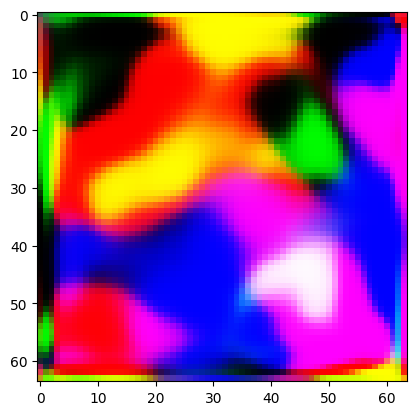

Training Epoch 1:   0%|          | 1/377 [00:05<35:18,  5.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 1:   1%|          | 2/377 [00:06<17:05,  2.73s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 1:   1%|          | 3/377 [00:07<12:00,  1.93s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:   1%|          | 4/377 [00:08<08:58,  1.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 1:   1%|▏         | 5/377 [00:08<07:49,  1.26s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:   2%|▏         | 6/377 [00:09<06:34,  1.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 1:   2%|▏         | 7/377 [00:10<06:20,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 1:   2%|▏         | 8/377 [00:11<05:38,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:   2%|▏         | 9/377 [00:12<05:44,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:   3%|▎         | 10/377 [00:12<05:14,  1.17it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

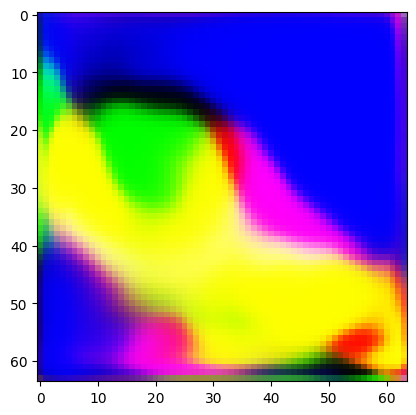

Training Epoch 1:   3%|▎         | 11/377 [00:14<06:07,  1.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:   3%|▎         | 12/377 [00:15<05:41,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 1:   3%|▎         | 13/377 [00:16<06:09,  1.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 1:   4%|▎         | 14/377 [00:17<05:52,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:   4%|▍         | 15/377 [00:18<06:13,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:   4%|▍         | 16/377 [00:19<05:51,  1.03it/s]

Generator Gradient Norm for label_embedding.weight: 7.884988735895604e-05
Generator Gradient Norm for label_embedding.bias: 6.42303639324382e-05
Generator Gradient Norm for fc.0.weight: 0.0070969718508422375
Generator Gradient Norm for fc.0.bias: 0.00027975431294180453
Generator Gradient Norm for fc.1.weight: 0.00014553742948919535
Generator Gradient Norm for fc.1.bias: 0.00013009653775952756
Generator Gradient Norm for downsample.weight: 0.00791594386100769
Generator Gradient Norm for downsample.bias: 0.0007776779821142554
Generator Gradient Norm for res_blocks.0.block.0.weight: 0.0001387614756822586
Generator Gradient Norm for res_blocks.0.block.0.bias: 2.649731641213293e-06
Generator Gradient Norm for res_blocks.0.block.1.weight: 7.918893061287235e-06
Generator Gradient Norm for res_blocks.0.block.1.bias: 6.314166967058554e-06
Generator Gradient Norm for res_blocks.0.block.4.weight: 0.00013947438856121153
Generator Gradient Norm for res_blocks.0.block.4.bias: 3.3196870390383992e-06


Training Epoch 1:   5%|▍         | 17/377 [00:20<05:49,  1.03it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 2.704193115234375
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 8
Auxiliary loss: 2.463534355163574
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape aft

Training Epoch 1:   5%|▍         | 18/377 [00:20<05:26,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 7, 0, 2, 0, 9, 4, 4, 2, 7, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:   5%|▌         | 19/377 [00:21<05:33,  1.07it/s]

Batch Classes: [0, 2, 3, 4, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 1:   5%|▌         | 20/377 [00:22<05:07,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

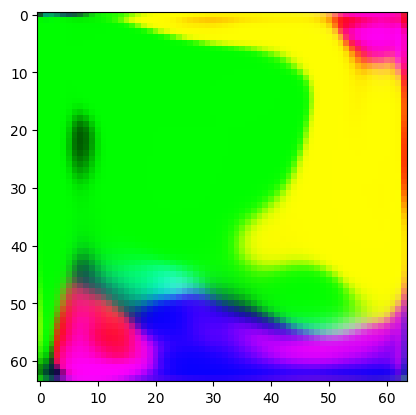

Training Epoch 1:   6%|▌         | 21/377 [00:23<05:37,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 1:   6%|▌         | 22/377 [00:24<05:08,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:   6%|▌         | 23/377 [00:25<05:16,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:   6%|▋         | 24/377 [00:26<04:55,  1.19it/s]

Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise injection: torch.Size([51, 128, 4, 4])
Shape before deconvolution: torch.Size([51, 128, 4, 4])
Final shape deconvolution: torch.Size([51, 3, 64, 64])
Min pixel value: -1.0
Max pixel value: 1.0
Shape after Deconvolution layers: torch.Size([51, 3, 64, 64])
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torc

Training Epoch 1:   7%|▋         | 25/377 [00:26<05:07,  1.14it/s]

Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 8.177539825439453
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 8
Auxiliary loss: 2.438098669052124
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: torch.Size([50, 128, 4, 4])
Shape before deconvolution: torch.Size([50, 

Training Epoch 1:   7%|▋         | 26/377 [00:27<04:48,  1.22it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 1:   7%|▋         | 27/377 [00:28<05:02,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 1:   7%|▋         | 28/377 [00:29<04:52,  1.19it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 1:   8%|▊         | 29/377 [00:30<05:23,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 1:   8%|▊         | 30/377 [00:31<05:04,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

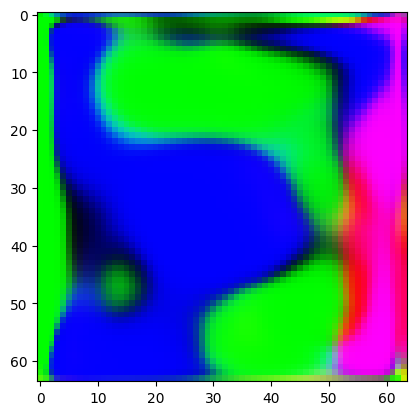

Training Epoch 1:   8%|▊         | 31/377 [00:32<06:02,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 1:   8%|▊         | 32/377 [00:33<05:39,  1.02it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 1:   9%|▉         | 33/377 [00:34<05:52,  1.02s/it]

Epoch 0, G Loss: -0.001545438077300787, D Loss: 0.1355239897966385
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 1:   9%|▉         | 34/377 [00:35<05:31,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 6, 1, 0, 0, 5, 0, 5, 1, 3, 6, 2, 6, 1, 2, 0, 3, 2, 1, 2, 6, 1, 3,
        6, 5, 3, 2, 5, 0, 2, 0, 5, 3, 3, 2, 5, 1, 2, 1, 6, 2, 0, 5, 1, 2, 6, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 1:   9%|▉         | 35/377 [00:36<05:36,  1.02it/s]

Generator Gradient Norm for label_embedding.weight: 0.00031030431273393333
Generator Gradient Norm for label_embedding.bias: 0.00028788435156457126
Generator Gradient Norm for fc.0.weight: 0.020105082541704178
Generator Gradient Norm for fc.0.bias: 0.0011767486575990915
Generator Gradient Norm for fc.1.weight: 0.0005095225642435253
Generator Gradient Norm for fc.1.bias: 0.0005061086267232895
Generator Gradient Norm for downsample.weight: 0.042554035782814026
Generator Gradient Norm for downsample.bias: 0.006265677511692047
Generator Gradient Norm for res_blocks.0.block.0.weight: 0.00034381027217023075
Generator Gradient Norm for res_blocks.0.block.0.bias: 7.252504929056158e-06
Generator Gradient Norm for res_blocks.0.block.1.weight: 2.5551617000019178e-05
Generator Gradient Norm for res_blocks.0.block.1.bias: 2.3669419533689506e-05
Generator Gradient Norm for res_blocks.0.block.4.weight: 0.00036303914384916425
Generator Gradient Norm for res_blocks.0.block.4.bias: 1.1744184121198487e-0

Training Epoch 1:  10%|▉         | 36/377 [00:37<05:07,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 1:  10%|▉         | 37/377 [00:38<05:09,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  10%|█         | 38/377 [00:38<04:46,  1.18it/s]

Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Discriminator output for fake images (validity_fake): 6.840511798858643
Shape of age_fake_pred_pooled: torch.Size([51, 12])
Shape of labels: torch.Size([51])
Shape of labels for aux_loss: torch.Size([51])
Labels range for aux_loss: 0 to 7
Auxiliary loss: 2.347437858581543
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise injection: torch.Size([51, 128, 4, 4])
Shape before deconvolution: torch.Size([51, 

Training Epoch 1:  10%|█         | 39/377 [00:39<04:58,  1.13it/s]


Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 8.399633407592773
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 9
Auxiliary loss: 2.460991621017456
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 

Training Epoch 1:  11%|█         | 40/377 [00:40<04:38,  1.21it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 10
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

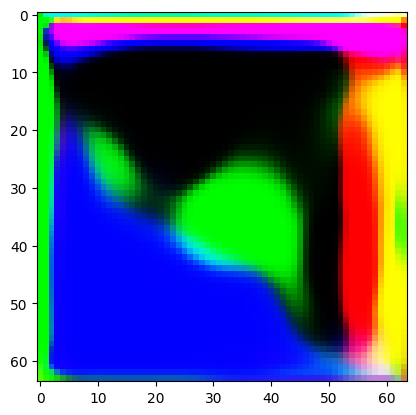

Training Epoch 1:  11%|█         | 41/377 [00:41<05:13,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise

Training Epoch 1:  11%|█         | 42/377 [00:42<04:47,  1.17it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 1:  11%|█▏        | 43/377 [00:43<04:58,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  12%|█▏        | 44/377 [00:44<04:40,  1.19it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 1:  12%|█▏        | 45/377 [00:45<04:53,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 1:  12%|█▏        | 46/377 [00:45<04:34,  1.21it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 1:  12%|█▏        | 47/377 [00:46<05:02,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  13%|█▎        | 48/377 [00:47<04:55,  1.11it/s]

Epoch 0, G Loss: -0.0019342718878760934, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gen

Training Epoch 1:  13%|█▎        | 49/377 [00:48<05:22,  1.02it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  13%|█▎        | 50/377 [00:49<05:10,  1.05it/s]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 1, 7, 0, 0, 5, 0, 7, 2, 7, 6, 8, 5, 5, 8, 8, 1, 5, 2, 2, 7,
        1, 5, 8, 6, 6, 5, 7, 0, 2, 0, 7, 6, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1, 5,
        7, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

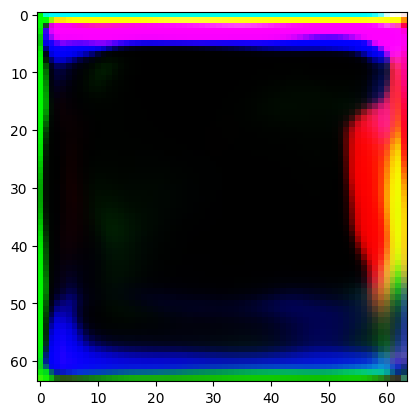

Training Epoch 1:  14%|█▎        | 51/377 [00:51<05:56,  1.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  14%|█▍        | 52/377 [00:52<05:34,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:  14%|█▍        | 53/377 [00:53<05:31,  1.02s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  14%|█▍        | 54/377 [00:53<05:00,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:  15%|█▍        | 55/377 [00:54<05:05,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  15%|█▍        | 56/377 [00:55<04:42,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 1:  15%|█▌        | 57/377 [00:56<04:50,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 1:  15%|█▌        | 58/377 [00:57<04:30,  1.18it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 1:  16%|█▌        | 59/377 [00:58<04:44,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 1:  16%|█▌        | 60/377 [00:59<04:28,  1.18it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 7.38444185256958
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 8
Auxiliary loss: 2.19174861907959
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after

Training Epoch 1:  16%|█▌        | 60/377 [00:59<05:12,  1.01it/s]


Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
Epoch 2/50


Training Epoch 2:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

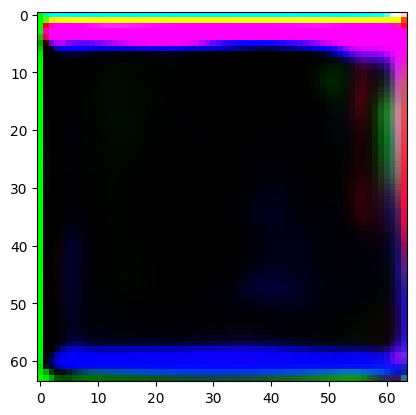

Training Epoch 2:   0%|          | 1/377 [00:01<11:33,  1.85s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:   1%|          | 2/377 [00:02<07:19,  1.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 2:   1%|          | 3/377 [00:03<07:07,  1.14s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:   1%|          | 4/377 [00:04<06:18,  1.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   1%|▏         | 5/377 [00:05<06:35,  1.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:   2%|▏         | 6/377 [00:06<06:08,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 2:   2%|▏         | 7/377 [00:07<06:23,  1.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:   2%|▏         | 8/377 [00:08<06:04,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   2%|▏         | 9/377 [00:09<06:28,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:   3%|▎         | 10/377 [00:10<05:47,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

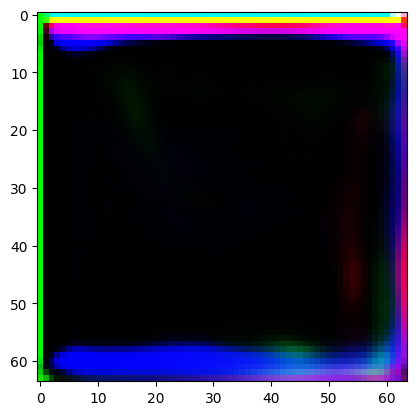

Training Epoch 2:   3%|▎         | 11/377 [00:11<06:15,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:   3%|▎         | 12/377 [00:12<05:39,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   3%|▎         | 13/377 [00:13<05:46,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:   4%|▎         | 14/377 [00:14<05:20,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 2:   4%|▍         | 15/377 [00:15<05:32,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:   4%|▍         | 16/377 [00:15<05:12,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 2:   5%|▍         | 17/377 [00:16<05:28,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:   5%|▍         | 18/377 [00:17<05:09,  1.16it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 8.867701530456543
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 6
Auxiliary loss: 1.680843472480774
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape aft

Training Epoch 2:   5%|▌         | 19/377 [00:18<05:27,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:   5%|▌         | 20/377 [00:19<05:07,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

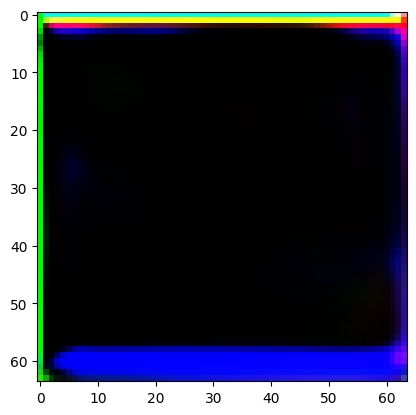

Training Epoch 2:   6%|▌         | 21/377 [00:20<06:07,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:   6%|▌         | 22/377 [00:21<05:43,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   6%|▌         | 23/377 [00:22<06:02,  1.02s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:   6%|▋         | 24/377 [00:23<05:43,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 2:   7%|▋         | 25/377 [00:24<06:09,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:   7%|▋         | 26/377 [00:25<05:45,  1.02it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   7%|▋         | 27/377 [00:26<06:07,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 2:   7%|▋         | 28/377 [00:27<05:33,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 2:   8%|▊         | 29/377 [00:28<05:37,  1.03it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 9.90744686126709
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 7
Auxiliary loss: 1.4353431463241577
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape aft

Training Epoch 2:   8%|▊         | 30/377 [00:29<05:10,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

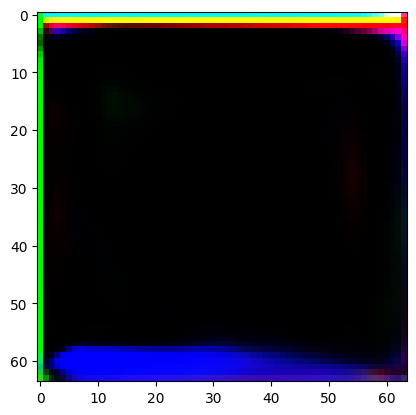

Training Epoch 2:   8%|▊         | 31/377 [00:30<05:44,  1.00it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:   8%|▊         | 32/377 [00:31<05:11,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   9%|▉         | 33/377 [00:32<05:20,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:   9%|▉         | 34/377 [00:32<04:57,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:   9%|▉         | 35/377 [00:33<05:10,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  10%|▉         | 36/377 [00:34<04:52,  1.17it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 8.132882118225098
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 9
Auxiliary loss: 1.6520071029663086
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 2:  10%|▉         | 37/377 [00:35<05:05,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise

Training Epoch 2:  10%|█         | 38/377 [00:36<04:45,  1.19it/s]

Batch Classes: [0, 1, 2, 3, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 7, 0, 1, 7, 0, 0, 3, 0, 7, 2, 7, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 7,
        1, 3, 8, 5, 5, 3, 7, 0, 2, 0, 7, 5, 3, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 2:  10%|█         | 39/377 [00:37<05:13,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:  11%|█         | 40/377 [00:38<05:05,  1.10it/s]

Batch Classes: [0, 2, 3, 5, 7, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 0, 0, 7, 0, 7, 2, 5, 8, 3, 8, 2, 3, 0, 5, 3, 2, 3, 8, 2, 5,
        8, 7, 5, 3, 7, 0, 3, 0, 7, 5, 5, 3, 7, 2, 3, 2, 8, 3, 0, 7, 2, 3, 8, 5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

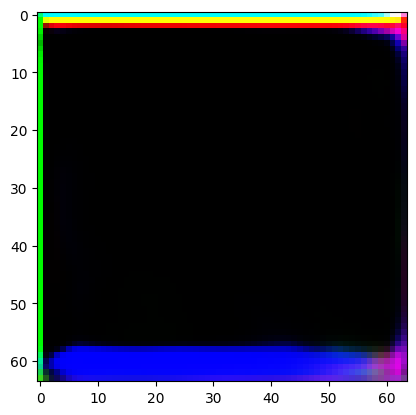

Training Epoch 2:  11%|█         | 41/377 [00:39<05:51,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:  11%|█         | 42/377 [00:40<05:32,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 2:  11%|█▏        | 43/377 [00:41<05:46,  1.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  12%|█▏        | 44/377 [00:42<05:23,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:  12%|█▏        | 45/377 [00:43<05:50,  1.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  12%|█▏        | 46/377 [00:44<05:26,  1.01it/s]


Generator Gradient Norm for res_blocks.0.block.4.bias: 1.0756416202184482e-07
Generator Gradient Norm for res_blocks.1.block.0.weight: 5.636532023345353e-06
Generator Gradient Norm for res_blocks.1.block.0.bias: 1.088864607368123e-07
Generator Gradient Norm for res_blocks.1.block.1.weight: 5.546943953049777e-07
Generator Gradient Norm for res_blocks.1.block.1.bias: 3.0457863431365695e-07
Generator Gradient Norm for res_blocks.1.block.4.weight: 5.219131253397791e-06
Generator Gradient Norm for res_blocks.1.block.4.bias: 9.520476851321291e-08
Generator Gradient Norm for attention.attention.weight: 5.66647895539063e-06
Generator Gradient Norm for attention.attention.bias: 5.0400515760884446e-08
Generator Gradient Norm for deconv.1.weight: 7.319494034163654e-05
Generator Gradient Norm for deconv.1.bias: 3.188548058398466e-13
Generator Gradient Norm for deconv.2.weight: 8.057968443608843e-06
Generator Gradient Norm for deconv.2.bias: 5.960007456451422e-06
Generator Gradient Norm for deconv

Training Epoch 2:  12%|█▏        | 47/377 [00:45<05:27,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 11
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  13%|█▎        | 48/377 [00:46<05:01,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 5,  0,  9,  2,  1,  1,  6,  0,  8,  3,  5, 10,  4, 10,  2,  4,  1,  5,
         4,  2,  4, 10,  1,  5,  9,  6,  6,  4,  8,  0,  3,  0,  8,  6,  5,  3,
         9,  1,  3,  3, 10,  3,  1,  8,  2,  4,  9,  6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generat

Training Epoch 2:  13%|█▎        | 49/377 [00:47<05:06,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  13%|█▎        | 50/377 [00:48<04:46,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

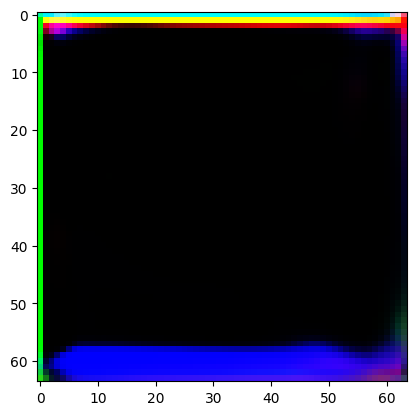

Training Epoch 2:  14%|█▎        | 51/377 [00:49<05:21,  1.02it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:  14%|█▍        | 52/377 [00:50<04:56,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 2:  14%|█▍        | 53/377 [00:51<05:06,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 2:  14%|█▍        | 54/377 [00:51<04:46,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 8, 1, 0, 4, 0, 5, 2, 8, 5, 8, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 8, 0, 2, 0, 9, 4, 4, 2, 8, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 8, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 2:  15%|█▍        | 55/377 [00:52<04:59,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  15%|█▍        | 56/377 [00:53<04:40,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 2:  15%|█▌        | 57/377 [00:54<04:58,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 2:  15%|█▌        | 58/377 [00:55<04:51,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 2:  16%|█▌        | 59/377 [00:56<05:14,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 2:  16%|█▌        | 60/377 [00:57<05:05,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12


Training Epoch 2:  16%|█▌        | 60/377 [00:57<05:05,  1.04it/s]


Epoch 3/50


Training Epoch 3:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 2, 3, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([2, 5, 7, 0, 3, 7, 2, 0, 5, 0, 6, 3, 7, 6, 7, 4, 4, 8, 8, 2, 4, 4, 4, 6,
        2, 5, 8, 6, 5, 4, 6, 7, 0, 3, 0, 8, 5, 5, 3, 7, 2, 3, 3, 8, 3, 0, 6, 2,
        4, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

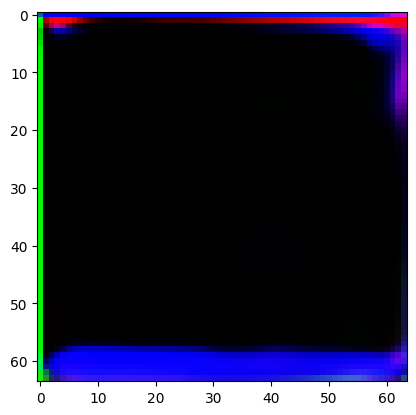

Training Epoch 3:   0%|          | 1/377 [00:02<14:42,  2.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   1%|          | 2/377 [00:03<09:09,  1.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 3:   1%|          | 3/377 [00:04<08:14,  1.32s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   1%|          | 4/377 [00:05<06:47,  1.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:   1%|▏         | 5/377 [00:06<06:41,  1.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   2%|▏         | 6/377 [00:06<05:56,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:   2%|▏         | 7/377 [00:07<06:05,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   2%|▏         | 8/377 [00:08<05:37,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:   2%|▏         | 9/377 [00:09<05:47,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   3%|▎         | 10/377 [00:10<05:20,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

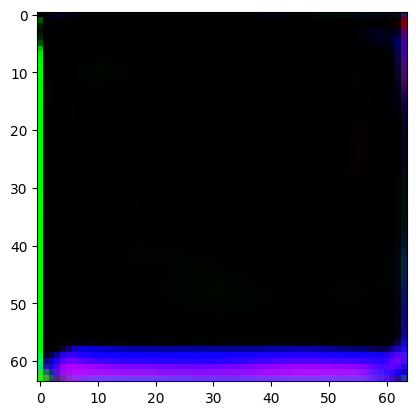

Training Epoch 3:   3%|▎         | 11/377 [00:11<06:03,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 3:   3%|▎         | 12/377 [00:12<05:34,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:   3%|▎         | 13/377 [00:13<05:45,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   4%|▎         | 14/377 [00:14<05:26,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:   4%|▍         | 15/377 [00:15<05:58,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   4%|▍         | 16/377 [00:16<05:42,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 3:   5%|▍         | 17/377 [00:17<06:08,  1.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   5%|▍         | 18/377 [00:18<05:57,  1.00it/s]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 7, 2, 0, 0, 6, 0, 6, 2, 5, 7, 3, 7, 2, 3, 0, 5, 3, 2, 3, 7, 2, 5,
        7, 6, 5, 3, 6, 0, 3, 0, 6, 5, 5, 3, 6, 2, 3, 2, 7, 3, 0, 6, 2, 3, 7, 5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 3:   5%|▌         | 19/377 [00:19<06:12,  1.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 3:   5%|▌         | 20/377 [00:20<05:49,  1.02it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

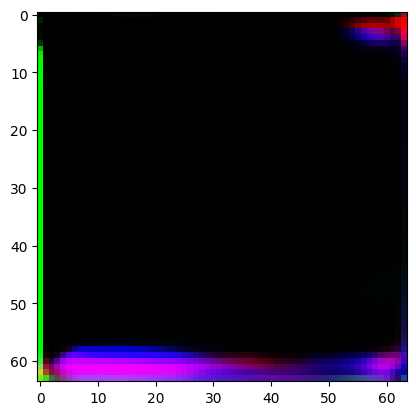

Training Epoch 3:   6%|▌         | 21/377 [00:21<06:29,  1.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 3:   6%|▌         | 22/377 [00:22<05:50,  1.01it/s]

Min pixel value: -1.0
Max pixel value: 0.9984163045883179
Shape after Deconvolution layers: torch.Size([51, 3, 64, 64])
Min pixel value: -1.0, Max pixel value: 0.9984163045883179
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Discriminator output for fake images (validity_fake): 9.964554786682129
Shape of age_fake_pred_pooled: torch.Size([51, 12])
Shape of labels: torch.Size([51])
Shape of labels for aux_loss: torch.Size([51])
Labels range for aux_loss: 0 to 8
Auxiliary loss: 0.18840929865837097
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size(

Training Epoch 3:   6%|▌         | 23/377 [00:23<05:54,  1.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 3:   6%|▋         | 24/377 [00:24<05:27,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 3:   7%|▋         | 25/377 [00:25<05:35,  1.05it/s]

Generator Gradient Norm for label_embedding.weight: 8.303539289045148e-06
Generator Gradient Norm for label_embedding.bias: 9.603558282833546e-06
Generator Gradient Norm for fc.0.weight: 0.0005606440827250481
Generator Gradient Norm for fc.0.bias: 2.8804704925278202e-05
Generator Gradient Norm for fc.1.weight: 1.1237796570640057e-05
Generator Gradient Norm for fc.1.bias: 1.2107029760954902e-05
Generator Gradient Norm for downsample.weight: 0.08781341463327408
Generator Gradient Norm for downsample.bias: 0.015739670023322105
Generator Gradient Norm for res_blocks.0.block.0.weight: 6.28152838544338e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 1.3293048084506154e-07
Generator Gradient Norm for res_blocks.0.block.1.weight: 5.272227667774132e-07
Generator Gradient Norm for res_blocks.0.block.1.bias: 5.351355412130943e-07
Generator Gradient Norm for res_blocks.0.block.4.weight: 6.2313920352607965e-06
Generator Gradient Norm for res_blocks.0.block.4.bias: 2.1467744204528572e-07


Training Epoch 3:   7%|▋         | 26/377 [00:26<05:11,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:   7%|▋         | 27/377 [00:27<05:22,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 3:   7%|▋         | 28/377 [00:27<05:00,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 3:   8%|▊         | 29/377 [00:28<05:16,  1.10it/s]

Generator Gradient Norm for label_embedding.weight: 4.62156413050252e-06
Generator Gradient Norm for label_embedding.bias: 5.011137091059936e-06
Generator Gradient Norm for fc.0.weight: 0.0002799140347633511
Generator Gradient Norm for fc.0.bias: 1.2606502423295751e-05
Generator Gradient Norm for fc.1.weight: 6.168255822558422e-06
Generator Gradient Norm for fc.1.bias: 5.361701823858311e-06
Generator Gradient Norm for downsample.weight: 0.08783186227083206
Generator Gradient Norm for downsample.bias: 0.015741098672151566
Generator Gradient Norm for res_blocks.0.block.0.weight: 3.3481987884442788e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 5.844638550911441e-08
Generator Gradient Norm for res_blocks.0.block.1.weight: 2.419129430109024e-07
Generator Gradient Norm for res_blocks.0.block.1.bias: 1.7925441397892428e-07
Generator Gradient Norm for res_blocks.0.block.4.weight: 2.8341214601823594e-06
Generator Gradient Norm for res_blocks.0.block.4.bias: 5.1211234364245684e-08
G

Training Epoch 3:   8%|▊         | 30/377 [00:29<04:54,  1.18it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

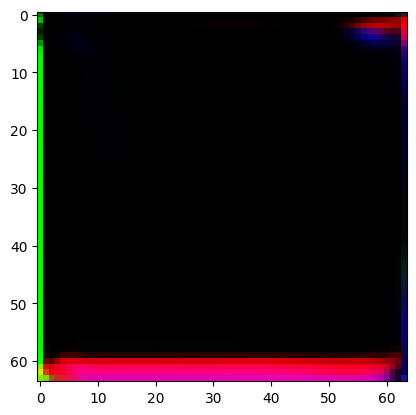

Training Epoch 3:   8%|▊         | 31/377 [00:30<05:29,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   8%|▊         | 32/377 [00:31<05:13,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:   9%|▉         | 33/377 [00:32<05:44,  1.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:   9%|▉         | 34/377 [00:33<05:30,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:   9%|▉         | 35/377 [00:34<06:00,  1.05s/it]

Epoch 2, G Loss: -0.0022530104033648968, D Loss: 0.08603154122829437
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after 

Training Epoch 3:  10%|▉         | 36/377 [00:35<05:41,  1.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:  10%|▉         | 37/377 [00:36<06:01,  1.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:  10%|█         | 38/377 [00:37<05:44,  1.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:  10%|█         | 39/377 [00:38<05:52,  1.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:  11%|█         | 40/377 [00:39<05:23,  1.04it/s]

Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: torch.Size([50, 128, 4, 4])
Shape before deconvolution: torch.Size([50, 128, 4, 4])
Final shape deconvolution: torch.Size([50, 3, 64, 64])
Min pixel value: -1.0
Max pixel value: 0.9983099699020386
Shape after Deconvolution layers: torch.Size([50, 3, 64, 64])
Min pixel value: -1.0, Max pixel value: 0.9983099699020386
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 12.89205265045166
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 8
Auxiliary loss:

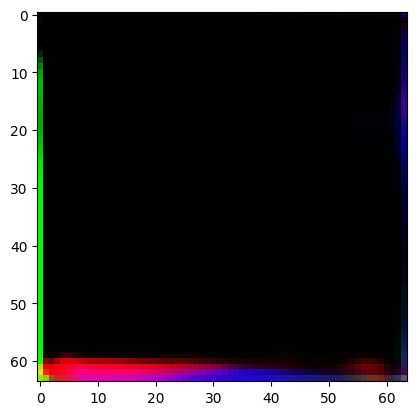

Training Epoch 3:  11%|█         | 41/377 [00:40<05:50,  1.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 3:  11%|█         | 42/377 [00:41<05:13,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:  11%|█▏        | 43/377 [00:42<05:20,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 3:  12%|█▏        | 44/377 [00:43<04:57,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:  12%|█▏        | 45/377 [00:44<05:10,  1.07it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 11.34463882446289
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 9
Auxiliary loss: 1.1342313289642334
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 3:  12%|█▏        | 46/377 [00:45<04:51,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:  12%|█▏        | 47/377 [00:46<05:05,  1.08it/s]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 3:  13%|█▎        | 48/377 [00:46<04:47,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:  13%|█▎        | 49/377 [00:47<05:02,  1.08it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:  13%|█▎        | 50/377 [00:48<04:50,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

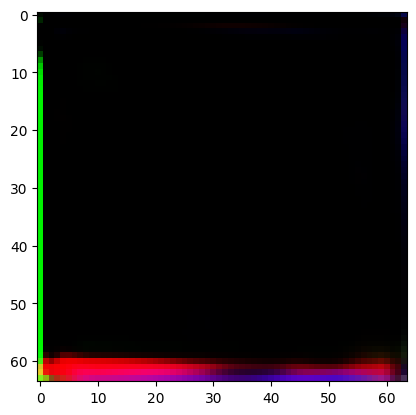

Training Epoch 3:  14%|█▎        | 51/377 [00:50<05:40,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 3:  14%|█▍        | 52/377 [00:51<05:21,  1.01it/s]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 4, 4, 8, 8, 1, 4, 4, 4, 6,
        1, 5, 8, 6, 5, 4, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        4, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:  14%|█▍        | 53/377 [00:52<05:50,  1.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:  14%|█▍        | 54/377 [00:53<05:33,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:  15%|█▍        | 55/377 [00:54<05:52,  1.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 3:  15%|█▍        | 56/377 [00:55<05:30,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 3:  15%|█▌        | 57/377 [00:56<05:42,  1.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 3:  15%|█▌        | 58/377 [00:57<05:23,  1.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 3:  16%|█▌        | 59/377 [00:58<05:32,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 7, 8, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 3:  16%|█▌        | 60/377 [00:59<05:01,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12


Training Epoch 3:  16%|█▌        | 60/377 [00:59<05:14,  1.01it/s]


Epoch 4/50


Training Epoch 4:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

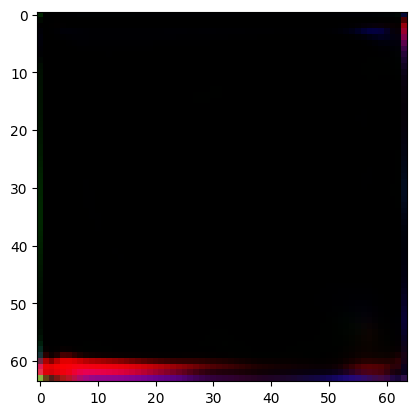

Training Epoch 4:   0%|          | 1/377 [00:02<12:33,  2.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   1%|          | 2/377 [00:02<07:46,  1.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   1%|          | 3/377 [00:03<07:10,  1.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:   1%|          | 4/377 [00:04<06:11,  1.00it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   1%|▏         | 5/377 [00:05<06:14,  1.01s/it]

Generator Gradient Norm for label_embedding.weight: 7.121379439922748e-06
Generator Gradient Norm for label_embedding.bias: 7.5681673479266465e-06
Generator Gradient Norm for fc.0.weight: 0.00042920629493892193
Generator Gradient Norm for fc.0.bias: 2.1275562176015228e-05
Generator Gradient Norm for fc.1.weight: 9.03048839973053e-06
Generator Gradient Norm for fc.1.bias: 9.01525254448643e-06
Generator Gradient Norm for downsample.weight: 0.08881164342164993
Generator Gradient Norm for downsample.bias: 0.015951596200466156
Generator Gradient Norm for res_blocks.0.block.0.weight: 5.3342732826422434e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 9.069753303947437e-08
Generator Gradient Norm for res_blocks.0.block.1.weight: 3.7447318845806876e-07
Generator Gradient Norm for res_blocks.0.block.1.bias: 2.3480195920910774e-07
Generator Gradient Norm for res_blocks.0.block.4.weight: 4.48395940111368e-06
Generator Gradient Norm for res_blocks.0.block.4.bias: 7.270758572985869e-08
Ge

Training Epoch 4:   2%|▏         | 6/377 [00:06<05:35,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:   2%|▏         | 7/377 [00:07<05:51,  1.05it/s]

Batch Classes: [0, 2, 3, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   2%|▏         | 8/377 [00:08<05:25,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   2%|▏         | 9/377 [00:09<05:59,  1.02it/s]

Batch Classes: [0, 1, 2, 3, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 4:   3%|▎         | 10/377 [00:10<05:40,  1.08it/s]

Epoch 3, G Loss: -0.0021834205836057663, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Genera

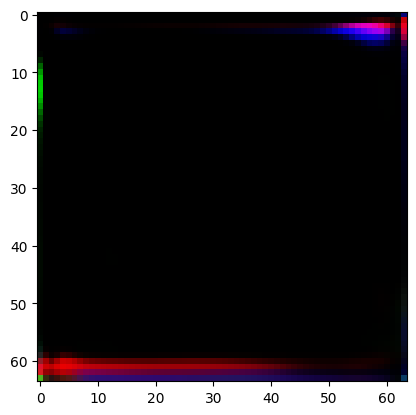

Training Epoch 4:   3%|▎         | 11/377 [00:11<06:45,  1.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   3%|▎         | 12/377 [00:12<06:13,  1.02s/it]

Batch Classes: [0, 1, 2, 3, 5, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 8, 1, 0, 0, 5, 0, 5, 1, 3, 8, 2, 8, 1, 2, 0, 3, 2, 1, 2, 8, 1, 3,
        8, 5, 3, 2, 5, 0, 2, 0, 5, 3, 3, 2, 5, 1, 2, 1, 8, 2, 0, 5, 1, 2, 8, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 4:   3%|▎         | 13/377 [00:13<06:31,  1.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:   4%|▎         | 14/377 [00:14<06:15,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:   4%|▍         | 15/377 [00:15<06:38,  1.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:   4%|▍         | 16/377 [00:16<06:11,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 4, 8, 6, 4, 3, 6, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   5%|▍         | 17/377 [00:17<06:11,  1.03s/it]

Generator Gradient Norm for res_blocks.1.block.0.weight: 8.672804142406676e-06
Generator Gradient Norm for res_blocks.1.block.0.bias: 1.68183206028516e-07
Generator Gradient Norm for res_blocks.1.block.1.weight: 7.939341344354034e-07
Generator Gradient Norm for res_blocks.1.block.1.bias: 7.511251283176534e-07
Generator Gradient Norm for res_blocks.1.block.4.weight: 9.035908988153096e-06
Generator Gradient Norm for res_blocks.1.block.4.bias: 2.9082517016831844e-07
Generator Gradient Norm for attention.attention.weight: 1.0911885510722641e-05
Generator Gradient Norm for attention.attention.bias: 3.3424223033762246e-07
Generator Gradient Norm for deconv.1.weight: 6.20604187133722e-05
Generator Gradient Norm for deconv.1.bias: 3.4370095203066497e-13
Generator Gradient Norm for deconv.2.weight: 6.841521098976955e-06
Generator Gradient Norm for deconv.2.bias: 4.9788050091592595e-06
Generator Gradient Norm for deconv.5.weight: 9.890538058243692e-05
Generator Gradient Norm for deconv.5.bias: 3

Training Epoch 4:   5%|▍         | 18/377 [00:18<05:38,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:   5%|▌         | 19/377 [00:19<05:44,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   5%|▌         | 20/377 [00:20<05:25,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

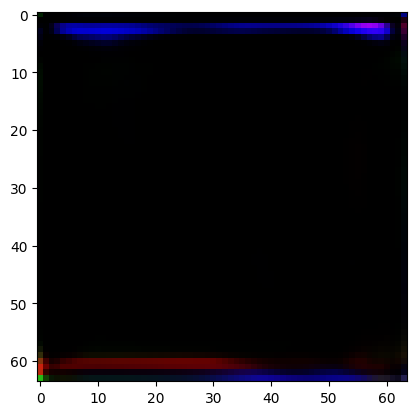

Training Epoch 4:   6%|▌         | 21/377 [00:21<06:03,  1.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   6%|▌         | 22/377 [00:22<05:36,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 4:   6%|▌         | 23/377 [00:23<05:43,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:   6%|▋         | 24/377 [00:24<05:16,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   7%|▋         | 25/377 [00:25<05:32,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:   7%|▋         | 26/377 [00:25<05:11,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:   7%|▋         | 27/377 [00:26<05:35,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   7%|▋         | 28/377 [00:27<05:26,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   8%|▊         | 29/377 [00:29<06:00,  1.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:   8%|▊         | 30/377 [00:30<05:47,  1.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 7, 0, 2, 0, 9, 4, 4, 2, 7, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

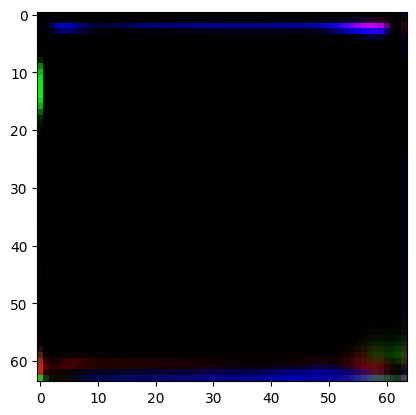

Training Epoch 4:   8%|▊         | 31/377 [00:31<06:51,  1.19s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:   8%|▊         | 32/377 [00:32<06:11,  1.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   9%|▉         | 33/377 [00:33<06:24,  1.12s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 4:   9%|▉         | 34/377 [00:34<06:00,  1.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:   9%|▉         | 35/377 [00:35<05:58,  1.05s/it]

Generator Gradient Norm for res_blocks.1.block.1.bias: 4.033532547964569e-07
Generator Gradient Norm for res_blocks.1.block.4.weight: 6.28737143415492e-06
Generator Gradient Norm for res_blocks.1.block.4.bias: 1.0555645246768108e-07
Generator Gradient Norm for attention.attention.weight: 8.512359272572212e-06
Generator Gradient Norm for attention.attention.bias: 7.591702910758613e-08
Generator Gradient Norm for deconv.1.weight: 8.592964877607301e-05
Generator Gradient Norm for deconv.1.bias: 3.820984327551624e-13
Generator Gradient Norm for deconv.2.weight: 7.447197276633233e-06
Generator Gradient Norm for deconv.2.bias: 4.860829903918784e-06
Generator Gradient Norm for deconv.5.weight: 9.388425678480417e-05
Generator Gradient Norm for deconv.5.bias: 3.2280231005571425e-12
Generator Gradient Norm for deconv.6.weight: 1.4020895832800306e-05
Generator Gradient Norm for deconv.6.bias: 1.0568616744421888e-05
Generator Gradient Norm for deconv.9.weight: 0.00012751609028782696
Generator Grad

Training Epoch 4:  10%|▉         | 36/377 [00:36<05:26,  1.04it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:  10%|▉         | 37/377 [00:37<05:31,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  10%|█         | 38/377 [00:38<05:05,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 10], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 5,  0,  8,  2,  1,  1,  6,  0,  7,  3,  5, 10,  4, 10,  2,  4,  1,  5,
         4,  2,  4, 10,  1,  5,  8,  6,  6,  4,  7,  0,  3,  0,  7,  6,  5,  3,
         8,  1,  3,  3, 10,  3,  1,  7,  2,  4,  8,  6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generat

Training Epoch 4:  10%|█         | 39/377 [00:39<05:16,  1.07it/s]

Generator Gradient Norm for deconv.10.bias: 5.5143907957244664e-05
Generator Gradient Norm for deconv.13.weight: 0.00012233774759806693
Generator Gradient Norm for deconv.13.bias: 1.4044235285837203e-05
Label Embedding Gradient Norm: 1.4571622159564868e-05
Label Embedding Gradient Norm: 1.7374703020323068e-05
Epoch 3, G Loss: -0.002231634920462966, D Loss: 0.13314026594161987
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torc

Training Epoch 4:  11%|█         | 40/377 [00:39<04:59,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 5, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 7, 1, 0, 0, 5, 0, 5, 1, 3, 7, 2, 7, 1, 2, 0, 3, 2, 1, 2, 7, 1, 3,
        7, 5, 3, 2, 5, 0, 2, 0, 5, 3, 3, 2, 5, 1, 2, 1, 7, 2, 0, 5, 1, 2, 7, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

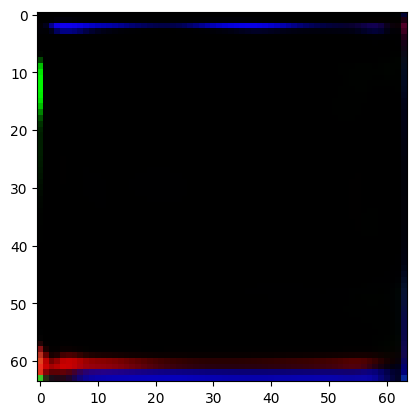

Training Epoch 4:  11%|█         | 41/377 [00:41<05:34,  1.01it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 4:  11%|█         | 42/377 [00:41<05:04,  1.10it/s]

Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Discriminator output for fake images (validity_fake): 9.486068725585938
Shape of age_fake_pred_pooled: torch.Size([51, 12])
Shape of labels: torch.Size([51])
Shape of labels for aux_loss: torch.Size([51])
Labels range for aux_loss: 0 to 9
Auxiliary loss: 0.10551662743091583
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape a

Training Epoch 4:  11%|█▏        | 43/377 [00:42<05:18,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  12%|█▏        | 44/377 [00:43<04:57,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:  12%|█▏        | 45/377 [00:44<05:12,  1.06it/s]

Generator Gradient Norm for label_embedding.weight: 1.1787368748628069e-05
Generator Gradient Norm for label_embedding.bias: 1.2599361980392132e-05
Generator Gradient Norm for fc.0.weight: 0.0006437604315578938
Generator Gradient Norm for fc.0.bias: 2.743167533481028e-05
Generator Gradient Norm for fc.1.weight: 1.3456212400342338e-05
Generator Gradient Norm for fc.1.bias: 1.2188961591164116e-05
Generator Gradient Norm for downsample.weight: 0.0930999368429184
Generator Gradient Norm for downsample.bias: 0.016844287514686584
Generator Gradient Norm for res_blocks.0.block.0.weight: 7.679033842578065e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 1.3652997665758448e-07
Generator Gradient Norm for res_blocks.0.block.1.weight: 6.122518811935151e-07
Generator Gradient Norm for res_blocks.0.block.1.bias: 3.778101813622925e-07
Generator Gradient Norm for res_blocks.0.block.4.weight: 6.896234481246211e-06
Generator Gradient Norm for res_blocks.0.block.4.bias: 1.7424439135993453e-07


Training Epoch 4:  12%|█▏        | 46/377 [00:45<05:03,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 4:  12%|█▏        | 47/377 [00:46<05:19,  1.03it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  13%|█▎        | 48/377 [00:47<05:14,  1.05it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 4:  13%|█▎        | 49/377 [00:48<05:47,  1.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  13%|█▎        | 50/377 [00:49<05:32,  1.02s/it]

Batch Classes: [0, 2, 3, 4, 5, 7, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([2, 5, 8, 0, 3, 8, 2, 0, 5, 0, 7, 3, 8, 7, 8, 4, 4, 9, 9, 2, 4, 4, 4, 7,
        2, 5, 9, 7, 5, 4, 7, 8, 0, 3, 0, 9, 5, 5, 3, 8, 2, 3, 3, 9, 3, 0, 7, 2,
        4, 8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

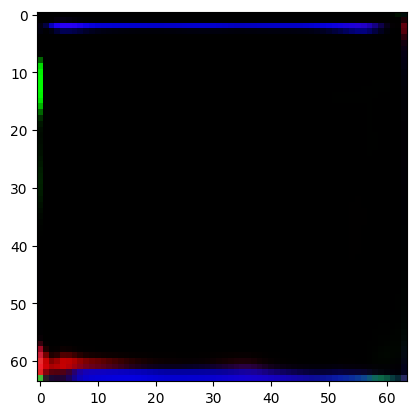

Training Epoch 4:  14%|█▎        | 51/377 [00:51<06:19,  1.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 11], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise injec

Training Epoch 4:  14%|█▍        | 52/377 [00:52<05:50,  1.08s/it]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 1, 7, 0, 0, 5, 0, 7, 2, 7, 6, 8, 5, 5, 8, 8, 1, 5, 2, 2, 7,
        1, 5, 8, 6, 6, 5, 7, 0, 2, 0, 7, 6, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1, 5,
        7, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 4:  14%|█▍        | 53/377 [00:53<06:06,  1.13s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  14%|█▍        | 54/377 [00:54<05:33,  1.03s/it]

Generator Gradient Norm for deconv.1.bias: 3.8976463658142724e-13
Generator Gradient Norm for deconv.2.weight: 9.101227988139726e-06
Generator Gradient Norm for deconv.2.bias: 9.199053238262422e-06
Generator Gradient Norm for deconv.5.weight: 0.00013222635607235134
Generator Gradient Norm for deconv.5.bias: 2.3156717429001494e-12
Generator Gradient Norm for deconv.6.weight: 1.9224173229304142e-05
Generator Gradient Norm for deconv.6.bias: 1.5465397154912353e-05
Generator Gradient Norm for deconv.9.weight: 0.00020465283887460828
Generator Gradient Norm for deconv.9.bias: 1.1761815479904847e-11
Generator Gradient Norm for deconv.10.weight: 5.2210696594556794e-05
Generator Gradient Norm for deconv.10.bias: 7.584480772493407e-05
Generator Gradient Norm for deconv.13.weight: 0.0001534865441499278
Generator Gradient Norm for deconv.13.bias: 2.3691491151112132e-05
Label Embedding Gradient Norm: 4.2624353227438405e-05
Label Embedding Gradient Norm: 4.74651824333705e-05
Epoch 3, G Loss: -0.0038

Training Epoch 4:  15%|█▍        | 55/377 [00:55<05:32,  1.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  15%|█▍        | 56/377 [00:55<05:01,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 4:  15%|█▌        | 57/377 [00:57<05:09,  1.03it/s]

Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Discriminator output for fake images (validity_fake): 8.223955154418945
Shape of age_fake_pred_pooled: torch.Size([51, 12])
Shape of labels: torch.Size([51])
Shape of labels for aux_loss: torch.Size([51])
Labels range for aux_loss: 0 to 8
Auxiliary loss: 0.9726136326789856
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape af

Training Epoch 4:  15%|█▌        | 58/377 [00:57<04:47,  1.11it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 1,  4,  8,  0,  2,  6,  1,  0,  4,  0,  6,  2,  8,  5,  8,  4,  4, 11,
        11,  2,  3,  3,  3,  6,  1,  4, 11,  6,  5,  4,  6,  0,  3,  0,  8,  5,
         5,  3,  8,  1,  3,  2, 11,  2,  1,  6,  2,  4,  8,  5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Insid

Training Epoch 4:  16%|█▌        | 59/377 [00:58<04:58,  1.06it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 4:  16%|█▌        | 60/377 [00:59<05:15,  1.00it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Epoch 5/50
Freezing Discriminator for this epoch...


Training Epoch 5:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

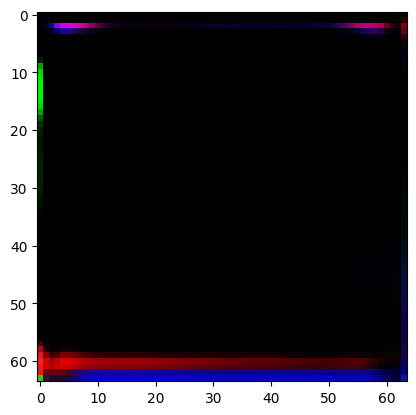

Training Epoch 5:   0%|          | 1/377 [00:01<10:00,  1.60s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   1%|          | 2/377 [00:02<06:41,  1.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   1%|          | 3/377 [00:03<05:39,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   1%|          | 4/377 [00:03<05:15,  1.18it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   1%|▏         | 5/377 [00:04<05:06,  1.21it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   2%|▏         | 6/377 [00:05<05:01,  1.23it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 5:   2%|▏         | 7/377 [00:06<05:00,  1.23it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   2%|▏         | 8/377 [00:07<05:05,  1.21it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   2%|▏         | 9/377 [00:07<05:08,  1.19it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   3%|▎         | 10/377 [00:08<05:15,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

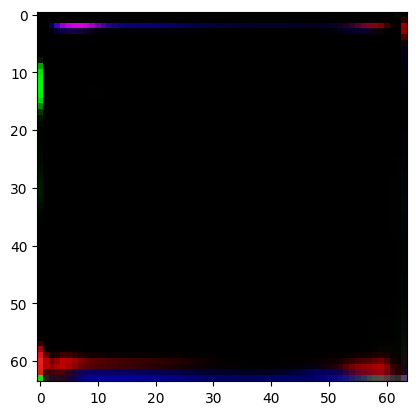

Training Epoch 5:   3%|▎         | 11/377 [00:09<05:43,  1.07it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:   3%|▎         | 12/377 [00:10<05:34,  1.09it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:   3%|▎         | 13/377 [00:11<05:29,  1.10it/s]

Epoch 4, G Loss: -0.001974263461306691, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: 

Training Epoch 5:   4%|▎         | 14/377 [00:12<05:18,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   4%|▍         | 15/377 [00:13<05:11,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:   4%|▍         | 16/377 [00:14<05:07,  1.17it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   5%|▍         | 17/377 [00:14<04:51,  1.24it/s]

Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Discriminator output for fake images (validity_fake): 8.123575210571289
Shape of age_fake_pred_pooled: torch.Size([50, 12])
Shape of labels: torch.Size([50])
Shape of labels for aux_loss: torch.Size([50])
Labels range for aux_loss: 0 to 8
Auxiliary loss: 0.032726138830184937
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape 

Training Epoch 5:   5%|▍         | 18/377 [00:15<04:38,  1.29it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:   5%|▌         | 19/377 [00:16<04:30,  1.32it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   5%|▌         | 20/377 [00:16<04:23,  1.35it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

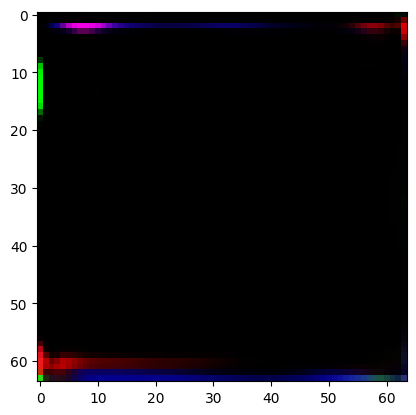

Training Epoch 5:   6%|▌         | 21/377 [00:17<04:37,  1.28it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:   6%|▌         | 22/377 [00:18<04:26,  1.33it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 5:   6%|▌         | 23/377 [00:19<04:16,  1.38it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:   6%|▋         | 24/377 [00:19<04:15,  1.38it/s]

Batch Classes: [0, 1, 2, 3, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 5:   7%|▋         | 25/377 [00:20<04:04,  1.44it/s]

Adversarial Loss: -0.0085
Auxiliary Loss: 0.0314
Feature Matching Loss: 0.0506
Diversity Loss: -0.9976
Generator Gradient Norm for label_embedding.weight: 9.565217624185607e-06
Generator Gradient Norm for label_embedding.bias: 1.5310968592530116e-05
Generator Gradient Norm for fc.0.weight: 0.00034598386264406145
Generator Gradient Norm for fc.0.bias: 2.1184350771363825e-05
Generator Gradient Norm for fc.1.weight: 8.004280971363187e-06
Generator Gradient Norm for fc.1.bias: 8.720099685888272e-06
Generator Gradient Norm for downsample.weight: 0.09650121629238129
Generator Gradient Norm for downsample.bias: 0.01752709038555622
Generator Gradient Norm for res_blocks.0.block.0.weight: 3.880527856381377e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 6.852677358892834e-08
Generator Gradient Norm for res_blocks.0.block.1.weight: 4.2801306676665263e-07
Generator Gradient Norm for res_blocks.0.block.1.bias: 3.8347147324202524e-07
Generator Gradient Norm for res_blocks.0.block.4.weigh

Training Epoch 5:   7%|▋         | 26/377 [00:21<03:59,  1.46it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   7%|▋         | 27/377 [00:21<04:03,  1.44it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   7%|▋         | 28/377 [00:22<04:01,  1.44it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:   8%|▊         | 29/377 [00:23<04:05,  1.42it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:   8%|▊         | 30/377 [00:24<04:12,  1.38it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

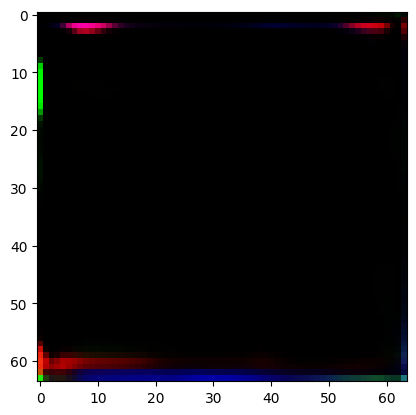

Training Epoch 5:   8%|▊         | 31/377 [00:25<04:56,  1.17it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   8%|▊         | 32/377 [00:26<04:57,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 5:   9%|▉         | 33/377 [00:26<04:56,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:   9%|▉         | 34/377 [00:27<04:57,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:   9%|▉         | 35/377 [00:28<04:58,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  10%|▉         | 36/377 [00:29<04:49,  1.18it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  10%|▉         | 37/377 [00:30<04:52,  1.16it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  10%|█         | 38/377 [00:31<04:56,  1.14it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:  10%|█         | 39/377 [00:32<04:59,  1.13it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  11%|█         | 40/377 [00:33<05:02,  1.12it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

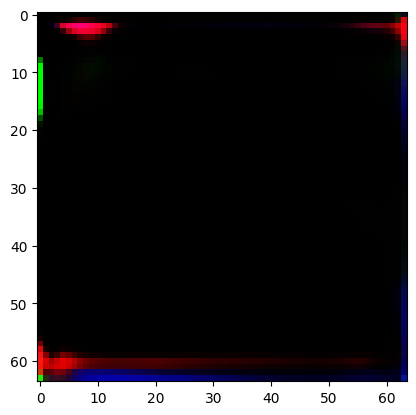

Training Epoch 5:  11%|█         | 41/377 [00:34<05:06,  1.10it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  11%|█         | 42/377 [00:34<04:42,  1.19it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  11%|█▏        | 43/377 [00:35<04:24,  1.26it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  12%|█▏        | 44/377 [00:36<04:12,  1.32it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:  12%|█▏        | 45/377 [00:36<04:05,  1.35it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  12%|█▏        | 46/377 [00:37<04:00,  1.38it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 11], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise injec

Training Epoch 5:  12%|█▏        | 47/377 [00:38<04:01,  1.36it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  13%|█▎        | 48/377 [00:38<03:57,  1.38it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  13%|█▎        | 49/377 [00:39<03:55,  1.39it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 5:  13%|█▎        | 50/377 [00:40<03:54,  1.39it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

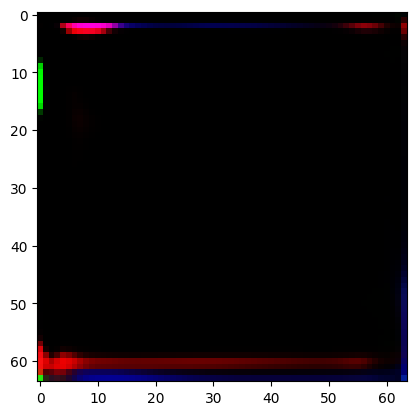

Training Epoch 5:  14%|█▎        | 51/377 [00:41<04:19,  1.26it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  14%|█▍        | 52/377 [00:42<04:08,  1.31it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  14%|█▍        | 53/377 [00:42<04:05,  1.32it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  14%|█▍        | 54/377 [00:43<04:10,  1.29it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  15%|█▍        | 55/377 [00:44<04:18,  1.24it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  15%|█▍        | 56/377 [00:45<04:22,  1.22it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  15%|█▌        | 57/377 [00:46<04:25,  1.21it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  15%|█▌        | 58/377 [00:47<04:31,  1.18it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 5:  16%|█▌        | 59/377 [00:47<04:30,  1.17it/s]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 5:  16%|█▌        | 60/377 [00:48<04:36,  1.15it/s]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12


Training Epoch 5:  16%|█▌        | 60/377 [00:49<04:20,  1.22it/s]


Epoch 6/50


Training Epoch 6:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth

  0%|          | 0.00/104M [00:00<?, ?B/s]
  1%|          | 1.00M/104M [00:00<00:10, 9.86MB/s]
  6%|▌         | 5.75M/104M [00:00<00:03, 32.5MB/s]
 15%|█▌        | 15.9M/104M [00:00<00:01, 65.4MB/s]
 26%|██▌       | 26.8M/104M [00:00<00:00, 83.9MB/s]
 37%|███▋      | 38.5M/104M [00:00<00:00, 97.6MB/s]
 46%|████▌     | 48.0M/104M [00:00<00:00, 98.0MB/s]
 58%|█████▊    | 60.1M/104M [00:00<00:00, 107MB/s] 
 69%|██████▉   | 71.6M/104

FID Score at Epoch 6: 1222.189697265625
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 5
Adversarial Loss: -0.0080
Auxiliary Loss: 0.9591
Feature Matching Loss: 0.1085
Diversity Loss: -0.9970
Generator Gradient Norm for label_embedding.weight: 4.628008173312992e-05
Generator Gradient Norm for label_embedding.bias: 5.8941968745784834e-05
Generator Gradient Norm for fc.0.weight: 0.0022370247170329094
Generator Gradient Norm for fc.0.bias: 0.00018988354713656008
Generator Gradient Norm for fc.1.weight: 5.3724070312455297e-05
Generator Gradient Norm for fc.1.bias: 5.952504579909146e-05
Generator Gradient Norm for downsample.weight: 0.09917851537466049
Generator Gradient Norm for downsample.bias: 0.018069913610816002
Generator Gradient Norm for res_blocks.0.block.0.weight: 2.882975786633324e-05
Generator Gradient Norm for res_blocks.0.block.0.bias: 5.927379902459506e-07
G

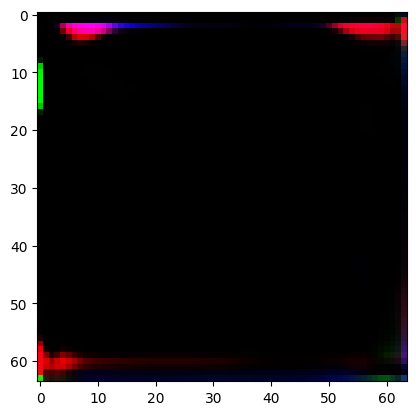

Training Epoch 6:   0%|          | 1/377 [00:19<2:04:28, 19.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   1%|          | 2/377 [00:28<1:23:00, 13.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 6:   1%|          | 3/377 [00:41<1:23:01, 13.32s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 6:   1%|          | 4/377 [00:56<1:25:40, 13.78s/it]

Epoch 5, G Loss: 0.014057966880500317, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .......

Training Epoch 6:   1%|▏         | 5/377 [01:05<1:15:01, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:   2%|▏         | 6/377 [01:18<1:15:38, 12.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   2%|▏         | 7/377 [01:30<1:16:33, 12.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   2%|▏         | 8/377 [01:39<1:09:56, 11.37s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   2%|▏         | 9/377 [01:54<1:15:17, 12.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:   3%|▎         | 10/377 [02:05<1:13:25, 12.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

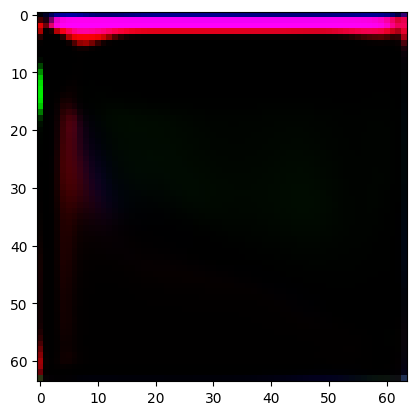

Training Epoch 6:   3%|▎         | 11/377 [02:15<1:09:22, 11.37s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 6:   3%|▎         | 12/377 [02:28<1:12:57, 11.99s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   3%|▎         | 13/377 [02:40<1:12:19, 11.92s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   4%|▎         | 14/377 [02:52<1:11:11, 11.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   4%|▍         | 15/377 [03:06<1:16:15, 12.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   4%|▍         | 16/377 [03:18<1:13:51, 12.27s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   5%|▍         | 17/377 [03:27<1:08:47, 11.46s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   5%|▍         | 18/377 [03:41<1:13:20, 12.26s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   5%|▌         | 19/377 [03:53<1:11:34, 12.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   5%|▌         | 20/377 [04:03<1:07:57, 11.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

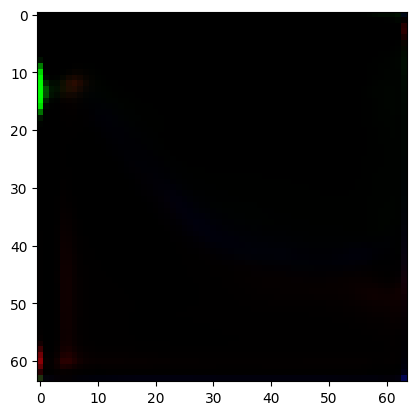

Training Epoch 6:   6%|▌         | 21/377 [04:16<1:11:25, 12.04s/it]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:   6%|▌         | 22/377 [04:26<1:06:24, 11.22s/it]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 1, 7, 0, 0, 5, 0, 7, 2, 7, 6, 8, 5, 5, 8, 8, 1, 5, 2, 2, 7,
        1, 5, 8, 6, 6, 5, 7, 0, 2, 0, 7, 6, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1, 5,
        7, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 6:   6%|▌         | 23/377 [04:40<1:11:02, 12.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:   6%|▋         | 24/377 [04:52<1:12:20, 12.30s/it]

Epoch 5, G Loss: 0.009824035689234734, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 6:   7%|▋         | 25/377 [05:02<1:07:28, 11.50s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 6:   7%|▋         | 26/377 [05:16<1:10:45, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 6:   7%|▋         | 27/377 [05:29<1:12:17, 12.39s/it]

Epoch 5, G Loss: 0.016337059438228607, D Loss: 0.0807419940829277
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Att

Training Epoch 6:   7%|▋         | 28/377 [05:38<1:06:05, 11.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   8%|▊         | 29/377 [05:52<1:11:15, 12.29s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 6:   8%|▊         | 30/377 [06:05<1:11:50, 12.42s/it]

Epoch 5, G Loss: 0.01520961057394743, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator

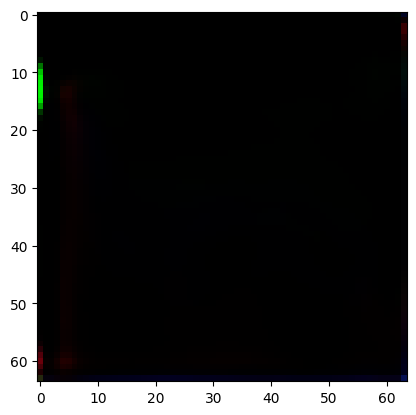

Training Epoch 6:   8%|▊         | 31/377 [06:15<1:06:51, 11.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after

Training Epoch 6:   8%|▊         | 32/377 [06:28<1:10:18, 12.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 6:   9%|▉         | 33/377 [06:42<1:11:59, 12.56s/it]

Epoch 5, G Loss: 0.007090134546160698, D Loss: 0.08925673365592957
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 6:   9%|▉         | 34/377 [06:50<1:05:35, 11.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:   9%|▉         | 35/377 [07:03<1:07:49, 11.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  10%|▉         | 36/377 [07:17<1:11:16, 12.54s/it]

Epoch 5, G Loss: 0.012301620095968246, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 6:  10%|▉         | 37/377 [07:27<1:05:49, 11.62s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 6:  10%|█         | 38/377 [07:39<1:06:01, 11.69s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 6:  10%|█         | 39/377 [07:50<1:04:51, 11.51s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  11%|█         | 40/377 [08:00<1:01:37, 10.97s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

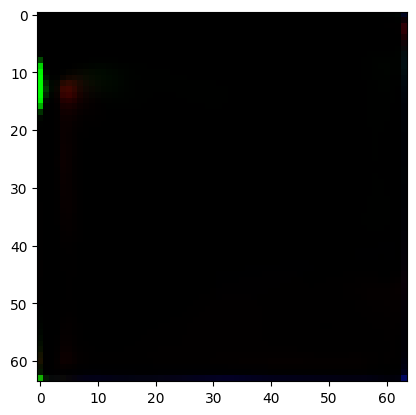

Training Epoch 6:  11%|█         | 41/377 [08:13<1:05:43, 11.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 6:  11%|█         | 42/377 [08:24<1:04:51, 11.62s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 6:  11%|█▏        | 43/377 [08:35<1:03:09, 11.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  12%|█▏        | 44/377 [08:48<1:04:45, 11.67s/it]

FID Score at Epoch 6: 1347.937255859375
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 5
Adversarial Loss: -0.0044
Auxiliary Loss: 1.0611
Feature Matching Loss: 0.0357
Diversity Loss: -1.0000
Generator Gradient Norm for label_embedding.weight: 2.6463974336365936e-06
Generator Gradient Norm for label_embedding.bias: 3.6728213217429584e-06
Generator Gradient Norm for fc.0.weight: 0.00010816529538715258
Generator Gradient Norm for fc.0.bias: 7.88522811490111e-06
Generator Gradient Norm for fc.1.weight: 2.746436393863405e-06
Generator Gradient Norm for fc.1.bias: 3.2385933081968687e-06
Generator Gradient Norm for downsample.weight: 0.12324834614992142
Generator Gradient Norm for downsample.bias: 0.02253858558833599
Generator Gradient Norm for res_blocks.0.block.0.weight: 1.0996260471074493e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 2.0304216974409428e-08


Training Epoch 6:  12%|█▏        | 45/377 [08:57<1:00:32, 10.94s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  12%|█▏        | 46/377 [09:09<1:01:59, 11.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 5, 1, 0, 0, 4, 0, 4, 1, 3, 5, 2, 5, 1, 2, 0, 3, 2, 1, 2, 5, 1, 3,
        5, 4, 3, 2, 4, 0, 2, 0, 4, 3, 3, 2, 4, 1, 2, 1, 5, 2, 0, 4, 1, 2, 5, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 6:  12%|█▏        | 47/377 [09:21<1:03:07, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  13%|█▎        | 48/377 [09:30<59:32, 10.86s/it]  

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 6:  13%|█▎        | 49/377 [09:45<1:05:56, 12.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  13%|█▎        | 50/377 [09:56<1:03:56, 11.73s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

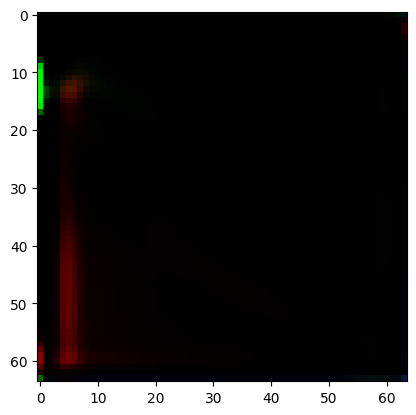

Training Epoch 6:  14%|█▎        | 51/377 [10:07<1:02:56, 11.58s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 6:  14%|█▍        | 52/377 [10:21<1:05:42, 12.13s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 7, 3, 3, 7, 7, 1, 3, 2, 2, 6,
        1, 3, 7, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 6:  14%|█▍        | 53/377 [10:33<1:05:23, 12.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 6:  14%|█▍        | 54/377 [10:43<1:02:28, 11.60s/it]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 6, 1, 0, 0, 5, 0, 5, 1, 3, 6, 2, 6, 1, 2, 0, 3, 2, 1, 2, 6, 1, 3,
        6, 5, 3, 2, 5, 0, 2, 0, 5, 3, 3, 2, 5, 1, 2, 1, 6, 2, 0, 5, 1, 2, 6, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 6:  15%|█▍        | 55/377 [10:56<1:04:05, 11.94s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 10], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: 

Training Epoch 6:  15%|█▍        | 56/377 [11:04<58:24, 10.92s/it]  

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 6:  15%|█▌        | 57/377 [11:17<1:00:16, 11.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 6:  15%|█▌        | 58/377 [11:28<59:30, 11.19s/it]  

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 6:  16%|█▌        | 59/377 [11:38<58:09, 10.97s/it]

Batch Classes: [0, 1, 2, 3, 7, 8, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 6:  16%|█▌        | 60/377 [11:50<1:00:00, 11.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12


Training Epoch 6:  16%|█▌        | 60/377 [11:51<1:02:37, 11.85s/it]


Epoch 7/50


Training Epoch 7:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

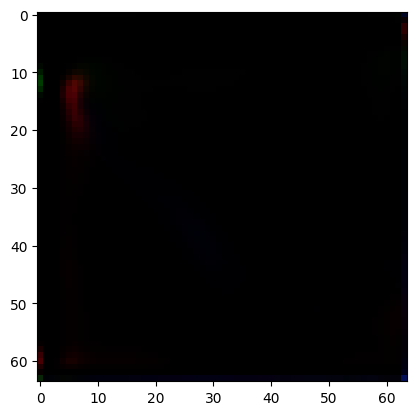

Training Epoch 7:   0%|          | 1/377 [00:12<1:21:27, 13.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:   1%|          | 2/377 [00:23<1:12:00, 11.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 7:   1%|          | 3/377 [00:37<1:19:22, 12.73s/it]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 7:   1%|          | 4/377 [00:51<1:22:40, 13.30s/it]

Epoch 6, G Loss: 0.008195901289582253, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 7:   1%|▏         | 5/377 [01:01<1:13:13, 11.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   2%|▏         | 6/377 [01:13<1:15:30, 12.21s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 7:   2%|▏         | 7/377 [01:28<1:20:01, 12.98s/it]

Epoch 6, G Loss: 0.011424333788454533, D Loss: 0.09172957390546799
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 7:   2%|▏         | 8/377 [01:37<1:11:35, 11.64s/it]

Batch Classes: [0, 1, 2, 4, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 1, 7, 0, 0, 4, 0, 7, 2, 7, 5, 8, 4, 4, 8, 8, 1, 4, 2, 2, 7,
        1, 4, 8, 5, 5, 4, 7, 0, 2, 0, 7, 5, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 7:   2%|▏         | 9/377 [01:49<1:11:39, 11.68s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   3%|▎         | 10/377 [02:00<1:10:34, 11.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

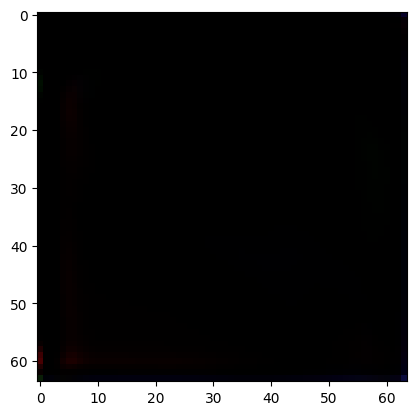

Training Epoch 7:   3%|▎         | 11/377 [02:10<1:06:57, 10.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   3%|▎         | 12/377 [02:23<1:11:37, 11.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:   3%|▎         | 13/377 [02:35<1:10:59, 11.70s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   4%|▎         | 14/377 [02:44<1:06:38, 11.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:   4%|▍         | 15/377 [02:58<1:12:23, 12.00s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   4%|▍         | 16/377 [03:10<1:11:20, 11.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:   5%|▍         | 17/377 [03:20<1:08:43, 11.46s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:   5%|▍         | 18/377 [03:32<1:09:36, 11.63s/it]

Epoch 6, G Loss: 0.019749172031879425, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 7:   5%|▌         | 19/377 [03:42<1:05:59, 11.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:   5%|▌         | 20/377 [03:56<1:10:32, 11.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

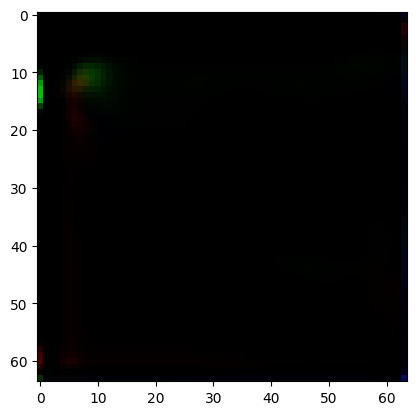

Training Epoch 7:   6%|▌         | 21/377 [04:08<1:11:34, 12.06s/it]

Batch Classes: [0, 2, 3, 4, 5, 7, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:   6%|▌         | 22/377 [04:17<1:05:21, 11.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:   6%|▌         | 23/377 [04:29<1:06:56, 11.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 7:   6%|▋         | 24/377 [04:40<1:06:14, 11.26s/it]

Epoch 6, G Loss: 0.005936541594564915, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .......

Training Epoch 7:   7%|▋         | 25/377 [04:51<1:04:34, 11.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:   7%|▋         | 26/377 [05:02<1:05:28, 11.19s/it]

Epoch 6, G Loss: 0.0092315087094903, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 7, 1, 0, 0, 6, 0, 6, 1, 3, 7, 2, 7, 1, 2, 0, 3, 2, 1, 2, 7, 1, 3,
        7, 6, 3, 2, 6, 0, 2, 0, 6, 3, 3, 2, 6, 1, 2, 1, 7, 2, 0, 6, 1, 2, 7, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .....................

Training Epoch 7:   7%|▋         | 27/377 [05:12<1:02:02, 10.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   7%|▋         | 28/377 [05:25<1:07:24, 11.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 7:   8%|▊         | 29/377 [05:37<1:08:00, 11.73s/it]

Epoch 6, G Loss: 0.01589631661772728, D Loss: 0.08134908974170685
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention

Training Epoch 7:   8%|▊         | 30/377 [05:46<1:02:51, 10.87s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

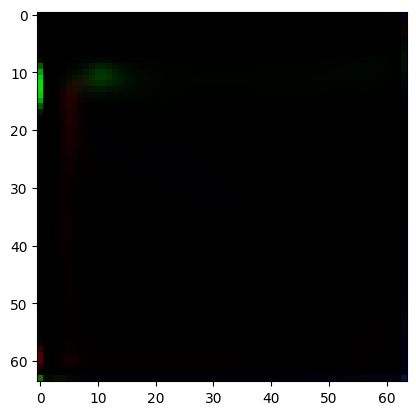

Training Epoch 7:   8%|▊         | 31/377 [06:01<1:09:05, 11.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:   8%|▊         | 32/377 [06:14<1:10:05, 12.19s/it]

Epoch 6, G Loss: -0.009598923847079277, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 7:   9%|▉         | 33/377 [06:23<1:05:44, 11.47s/it]

Epoch 6, G Loss: 0.013116037473082542, D Loss: 0.09504509717226028
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 7:   9%|▉         | 34/377 [06:36<1:08:05, 11.91s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:   9%|▉         | 35/377 [06:50<1:11:00, 12.46s/it]

Epoch 6, G Loss: 0.016674673184752464, D Loss: 0.08368953317403793
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 7:  10%|▉         | 36/377 [06:59<1:04:54, 11.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:  10%|▉         | 37/377 [07:12<1:07:17, 11.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:  10%|█         | 38/377 [07:25<1:08:34, 12.14s/it]

Epoch 6, G Loss: 0.014768022112548351, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 7:  10%|█         | 39/377 [07:34<1:03:28, 11.27s/it]

FID Score at Epoch 7: 1194.6527099609375
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 6
Adversarial Loss: -0.0060
Auxiliary Loss: 0.9948
Feature Matching Loss: 0.0315
Diversity Loss: -0.9998
Generator Gradient Norm for label_embedding.weight: 5.134769253345439e-06
Generator Gradient Norm for label_embedding.bias: 7.450476005033124e-06
Generator Gradient Norm for fc.0.weight: 0.0002537689288146794
Generator Gradient Norm for fc.0.bias: 1.2116460311517585e-05
Generator Gradient Norm for fc.1.weight: 5.866277660970809e-06
Generator Gradient Norm for fc.1.bias: 6.165096692711813e-06
Generator Gradient Norm for downsample.weight: 0.1231788843870163
Generator Gradient Norm for downsample.bias: 0.022512895986437798
Generator Gradient Norm for res_blocks.0.block.0.weight: 2.46389163294225e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 4.594720692807641e-08
Gene

Training Epoch 7:  11%|█         | 40/377 [07:49<1:09:08, 12.31s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

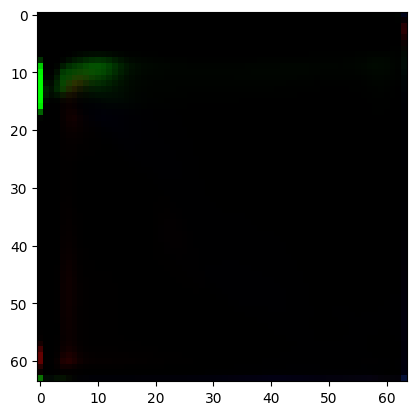

Training Epoch 7:  11%|█         | 41/377 [08:02<1:10:54, 12.66s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:  11%|█         | 42/377 [08:11<1:04:40, 11.58s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 7:  11%|█▏        | 43/377 [08:24<1:06:33, 11.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:  12%|█▏        | 44/377 [08:38<1:09:25, 12.51s/it]

Epoch 6, G Loss: 0.011478195898234844, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 7:  12%|█▏        | 45/377 [08:47<1:04:04, 11.58s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:  12%|█▏        | 46/377 [09:00<1:06:30, 12.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 7:  12%|█▏        | 47/377 [09:15<1:10:25, 12.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:  13%|█▎        | 48/377 [09:27<1:08:47, 12.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 7:  13%|█▎        | 49/377 [09:37<1:05:08, 11.92s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 7:  13%|█▎        | 50/377 [09:50<1:05:57, 12.10s/it]

Epoch 6, G Loss: 0.017819475382566452, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generato

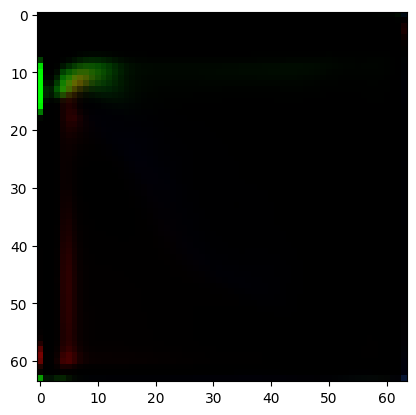

Training Epoch 7:  14%|█▎        | 51/377 [10:00<1:02:08, 11.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:  14%|█▍        | 52/377 [10:14<1:06:01, 12.19s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 7:  14%|█▍        | 53/377 [10:27<1:07:47, 12.56s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:  14%|█▍        | 54/377 [10:39<1:05:53, 12.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 7:  15%|█▍        | 55/377 [10:49<1:03:17, 11.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 7:  15%|█▍        | 56/377 [11:01<1:03:27, 11.86s/it]

Epoch 6, G Loss: 0.01584155298769474, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Genera

Training Epoch 7:  15%|█▌        | 57/377 [11:11<59:35, 11.17s/it]  

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 7:  15%|█▌        | 58/377 [11:22<59:18, 11.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 7:  16%|█▌        | 59/377 [11:33<59:15, 11.18s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 7:  16%|█▌        | 60/377 [11:43<56:50, 10.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 7:  16%|█▌        | 60/377 [11:44<1:01:59, 11.73s/it]


Epoch 8/50


Training Epoch 8:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 9, 3, 3, 9, 9, 1, 3, 2, 2, 5,
        1, 3, 9, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 9, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

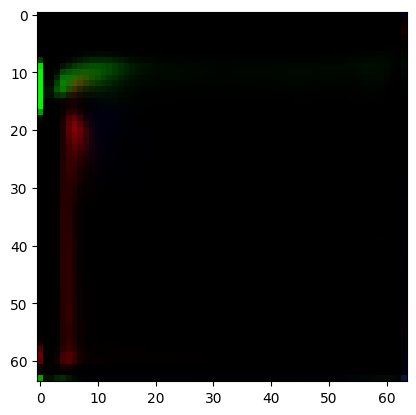

Training Epoch 8:   0%|          | 1/377 [00:14<1:31:11, 14.55s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 10], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise

Training Epoch 8:   1%|          | 2/377 [00:28<1:28:10, 14.11s/it]

Epoch 7, G Loss: -0.003230466041713953, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 8:   1%|          | 3/377 [00:37<1:13:38, 11.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:   1%|          | 4/377 [00:50<1:16:38, 12.33s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 7, 3, 3, 7, 7, 1, 3, 2, 2, 6,
        1, 3, 7, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 8:   1%|▏         | 5/377 [01:04<1:21:01, 13.07s/it]

Epoch 7, G Loss: 0.013186376541852951, D Loss: 0.08185754716396332
Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention blo

Training Epoch 8:   2%|▏         | 6/377 [01:13<1:12:12, 11.68s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:   2%|▏         | 7/377 [01:26<1:13:46, 11.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 8:   2%|▏         | 8/377 [01:37<1:12:04, 11.72s/it]

Epoch 7, G Loss: 0.016958031803369522, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .......

Training Epoch 8:   2%|▏         | 9/377 [01:47<1:08:26, 11.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 8:   3%|▎         | 10/377 [02:00<1:11:54, 11.76s/it]

Epoch 7, G Loss: 0.018375687301158905, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

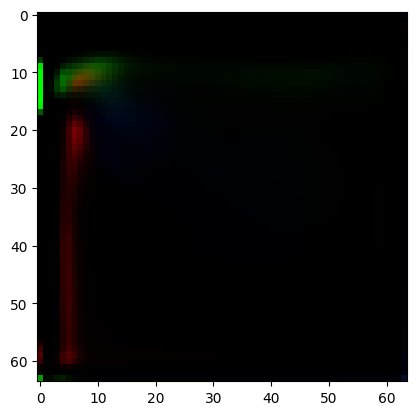

Training Epoch 8:   3%|▎         | 11/377 [02:10<1:07:43, 11.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 8:   3%|▎         | 12/377 [02:23<1:10:49, 11.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 8:   3%|▎         | 13/377 [02:37<1:16:04, 12.54s/it]

Epoch 7, G Loss: 0.013668099418282509, D Loss: 0.08693056553602219
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Sh

Training Epoch 8:   4%|▎         | 14/377 [02:46<1:09:00, 11.41s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], Counts: [5, 4, 3, 4, 5, 4, 3, 5, 3, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 0,  6,  6,  1,  3,  1,  0,  9,  5,  9,  9, 10,  3,  1,  3,  4,  6,  7,
         5,  2,  0,  9,  7,  5,  8,  0,  4,  0, 10,  7,  7,  4,  8,  2,  4,  3,
        10,  4,  1,  8,  2,  5, 10,  7], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([44, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([44, 3, 64, 64])
Shape of labels: torch.Size([44, 12, 64, 64])
Input Shape to initial_conv: torch.Size([44, 15, 64, 64])
Validity Shape: torch.Size([44, 1])
Auxiliary Prediction Shape: torch.Size([44, 12])
Validity Shape: torch.Size([44, 1])
Auxiliary Prediction Shape: torch.Size([44, 12])
Inside Generator .......

Training Epoch 8:   4%|▍         | 15/377 [02:58<1:10:31, 11.69s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 8:   4%|▍         | 16/377 [03:10<1:09:20, 11.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:   5%|▍         | 17/377 [03:20<1:07:48, 11.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:   5%|▍         | 18/377 [03:33<1:10:05, 11.71s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:   5%|▌         | 19/377 [03:44<1:08:42, 11.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:   5%|▌         | 20/377 [03:56<1:09:45, 11.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

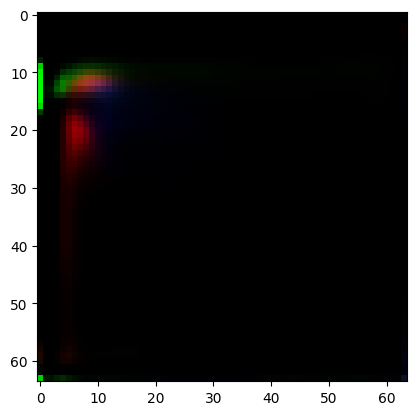

Training Epoch 8:   6%|▌         | 21/377 [04:09<1:11:46, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:   6%|▌         | 22/377 [04:19<1:06:40, 11.27s/it]

Batch Classes: [0, 1, 2, 3, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 7, 0, 1, 7, 0, 0, 3, 0, 7, 2, 7, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 7,
        1, 3, 8, 5, 5, 3, 7, 0, 2, 0, 7, 5, 3, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 8:   6%|▌         | 23/377 [04:31<1:08:33, 11.62s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 8:   6%|▋         | 24/377 [04:45<1:11:39, 12.18s/it]

Epoch 7, G Loss: 0.016418905928730965, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 8:   7%|▋         | 25/377 [04:54<1:06:02, 11.26s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 8:   7%|▋         | 26/377 [05:06<1:07:47, 11.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 8:   7%|▋         | 27/377 [05:21<1:13:23, 12.58s/it]

Epoch 7, G Loss: 0.0144347557798028, D Loss: 0.08290445804595947
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape afte

Training Epoch 8:   7%|▋         | 28/377 [05:30<1:07:02, 11.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 8:   8%|▊         | 29/377 [05:43<1:09:07, 11.92s/it]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:   8%|▊         | 30/377 [05:54<1:08:34, 11.86s/it]

Epoch 7, G Loss: 0.014859119430184364, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

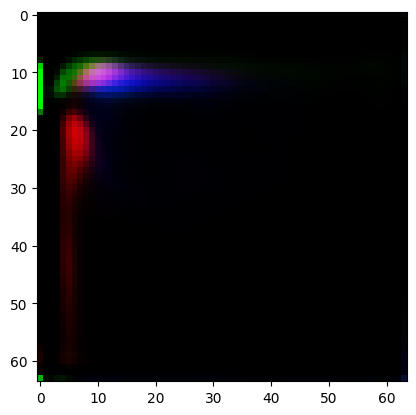

Training Epoch 8:   8%|▊         | 31/377 [06:04<1:05:04, 11.29s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:   8%|▊         | 32/377 [06:19<1:10:23, 12.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 8:   9%|▉         | 33/377 [06:30<1:08:16, 11.91s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 8:   9%|▉         | 34/377 [06:40<1:05:35, 11.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:   9%|▉         | 35/377 [06:53<1:07:23, 11.82s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  10%|▉         | 36/377 [07:02<1:02:53, 11.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:  10%|▉         | 37/377 [07:16<1:07:08, 11.85s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  10%|█         | 38/377 [07:28<1:07:44, 11.99s/it]

Epoch 7, G Loss: 0.011784952133893967, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 8, 0, 2, 7, 1, 0, 5, 0, 7, 2, 8, 6, 8, 5, 5, 9, 9, 2, 3, 3, 3, 7,
        1, 5, 9, 7, 6, 5, 7, 0, 3, 0, 8, 6, 6, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 5,
        8, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 8:  10%|█         | 39/377 [07:38<1:03:22, 11.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  11%|█         | 40/377 [07:51<1:06:22, 11.82s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 7, 2, 0, 0, 6, 0, 6, 2, 5, 7, 3, 7, 2, 3, 0, 5, 3, 2, 3, 7, 2, 5,
        7, 6, 5, 3, 6, 0, 3, 0, 6, 5, 5, 3, 6, 2, 3, 2, 7, 3, 0, 6, 2, 3, 7, 5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

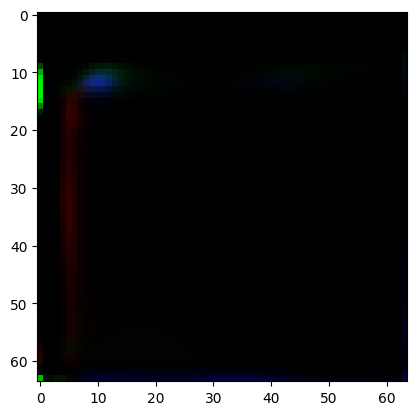

Training Epoch 8:  11%|█         | 41/377 [08:04<1:08:11, 12.18s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 8:  11%|█         | 42/377 [08:13<1:03:00, 11.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 8:  11%|█▏        | 43/377 [08:28<1:07:47, 12.18s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  12%|█▏        | 44/377 [08:40<1:08:33, 12.35s/it]

Epoch 7, G Loss: 0.017267704010009766, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .......

Training Epoch 8:  12%|█▏        | 45/377 [08:49<1:03:01, 11.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 8:  12%|█▏        | 46/377 [09:04<1:07:27, 12.23s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 8:  12%|█▏        | 47/377 [09:16<1:07:55, 12.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  13%|█▎        | 48/377 [09:26<1:03:28, 11.58s/it]

Epoch 7, G Loss: 0.007906735874712467, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Genera

Training Epoch 8:  13%|█▎        | 49/377 [09:40<1:06:56, 12.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  13%|█▎        | 50/377 [09:53<1:07:33, 12.40s/it]

Epoch 7, G Loss: 0.014905452728271484, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

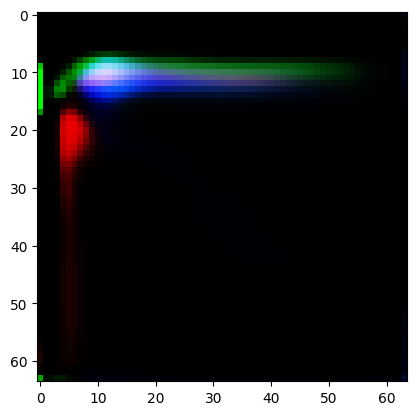

Training Epoch 8:  14%|█▎        | 51/377 [10:02<1:02:52, 11.57s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  14%|█▍        | 52/377 [10:16<1:05:47, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:  14%|█▍        | 53/377 [10:30<1:08:11, 12.63s/it]

Epoch 7, G Loss: 0.01742197386920452, D Loss: 0.08793006837368011
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape aft

Training Epoch 8:  14%|█▍        | 54/377 [10:39<1:02:35, 11.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 8:  15%|█▍        | 55/377 [10:50<1:02:05, 11.57s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  15%|█▍        | 56/377 [11:03<1:03:33, 11.88s/it]

Epoch 7, G Loss: 0.008674870245158672, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 9, 3, 3, 9, 9, 1, 3, 2, 2, 6,
        1, 3, 9, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .......

Training Epoch 8:  15%|█▌        | 57/377 [11:12<59:41, 11.19s/it]  

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  15%|█▌        | 58/377 [11:27<1:04:23, 12.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 8:  16%|█▌        | 59/377 [11:38<1:03:07, 11.91s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 8:  16%|█▌        | 60/377 [11:49<1:00:39, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12


Training Epoch 8:  16%|█▌        | 60/377 [11:49<1:02:28, 11.82s/it]


Epoch 9/50


Training Epoch 9:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 7, 0, 1, 7, 0, 0, 3, 0, 7, 2, 7, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 7,
        1, 3, 8, 5, 5, 3, 7, 0, 2, 0, 7, 5, 3, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

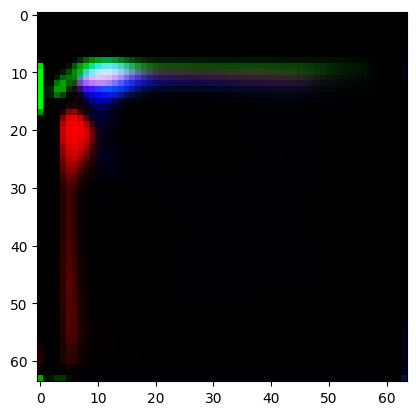

Training Epoch 9:   0%|          | 1/377 [00:14<1:33:36, 14.94s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   1%|          | 2/377 [00:27<1:25:10, 13.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:   1%|          | 3/377 [00:37<1:13:19, 11.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:   1%|          | 4/377 [00:50<1:16:29, 12.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 9:   1%|▏         | 5/377 [01:01<1:14:02, 11.94s/it]

Epoch 8, G Loss: 0.019299112260341644, D Loss: 0.09084270894527435
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 9:   2%|▏         | 6/377 [01:11<1:09:29, 11.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:   2%|▏         | 7/377 [01:24<1:12:05, 11.69s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 9:   2%|▏         | 8/377 [01:33<1:08:17, 11.10s/it]

Epoch 8, G Loss: 0.014862945303320885, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generato

Training Epoch 9:   2%|▏         | 9/377 [01:47<1:12:59, 11.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:   3%|▎         | 10/377 [01:59<1:13:32, 12.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

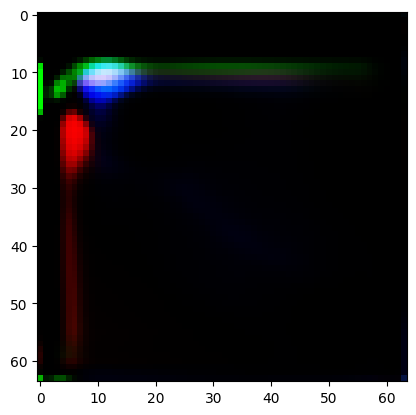

Training Epoch 9:   3%|▎         | 11/377 [02:09<1:09:33, 11.40s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   3%|▎         | 12/377 [02:23<1:13:27, 12.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:   3%|▎         | 13/377 [02:36<1:15:27, 12.44s/it]

Epoch 8, G Loss: 0.015889562666416168, D Loss: 0.08681625872850418
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attentio

Training Epoch 9:   4%|▎         | 14/377 [02:45<1:08:57, 11.40s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:   4%|▍         | 15/377 [02:58<1:10:56, 11.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 9:   4%|▍         | 16/377 [03:09<1:09:00, 11.47s/it]

Epoch 8, G Loss: 0.016227364540100098, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generato

Training Epoch 9:   5%|▍         | 17/377 [03:19<1:07:17, 11.21s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   5%|▍         | 18/377 [03:31<1:07:32, 11.29s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 9:   5%|▌         | 19/377 [03:41<1:04:58, 10.89s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], Counts: [5, 4, 3, 4, 5, 4, 3, 5, 3, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([44, 12])
Label embedding input shape: torch.Size([44, 12])
Shape after embedded_labels: torch.Size([44, 100])
Shape of combined (noise + embedded labels): torch.Size([44, 200])
Shape after self.fc: torch.Size([44, 4096])
Shape after reshaping out: torch.Size([44, 256, 4, 4])
Shape after downsampling out: torch.Size([44, 128, 4, 4])
Shape after residual block: torch.Size([44, 128, 4, 4])
Shape after Attention block: torch.Size([44, 128, 4, 4])
Shape

Training Epoch 9:   5%|▌         | 20/377 [03:54<1:09:08, 11.62s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

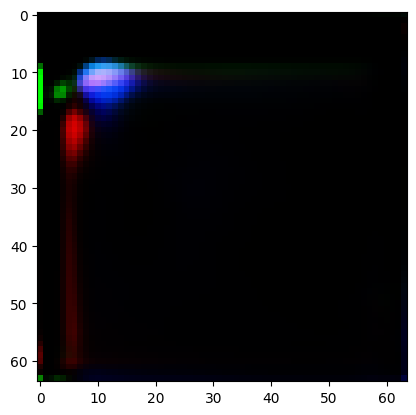

Training Epoch 9:   6%|▌         | 21/377 [04:08<1:12:35, 12.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:   6%|▌         | 22/377 [04:17<1:06:35, 11.26s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 9:   6%|▌         | 23/377 [04:29<1:07:47, 11.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   6%|▋         | 24/377 [04:40<1:07:58, 11.55s/it]

Epoch 8, G Loss: 0.009847231209278107, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generato

Training Epoch 9:   7%|▋         | 25/377 [04:50<1:04:35, 11.01s/it]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   7%|▋         | 26/377 [05:05<1:10:23, 12.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:   7%|▋         | 27/377 [05:18<1:13:25, 12.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:   7%|▋         | 28/377 [05:27<1:06:53, 11.50s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 9:   8%|▊         | 29/377 [05:41<1:09:39, 12.01s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   8%|▊         | 30/377 [05:52<1:07:52, 11.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

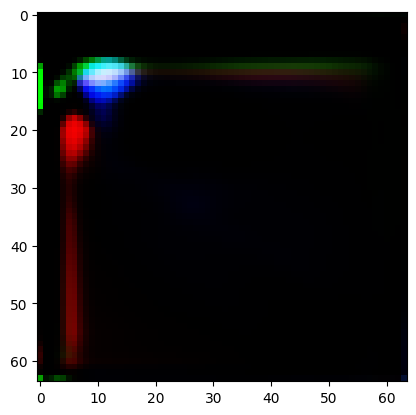

Training Epoch 9:   8%|▊         | 31/377 [06:03<1:06:35, 11.55s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 9:   8%|▊         | 32/377 [06:15<1:07:49, 11.80s/it]

Batch Classes: [0, 1, 2, 3, 5, 7, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 8, 0, 2, 8, 1, 0, 5, 0, 7, 2, 8, 7, 8, 3, 3, 9, 9, 1, 3, 3, 3, 7,
        1, 5, 9, 7, 5, 3, 7, 8, 0, 2, 0, 9, 5, 5, 2, 8, 1, 2, 2, 9, 2, 0, 7, 1,
        3, 8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 9:   9%|▉         | 33/377 [06:25<1:04:21, 11.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:   9%|▉         | 34/377 [06:39<1:09:15, 12.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 9:   9%|▉         | 35/377 [06:53<1:10:58, 12.45s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:  10%|▉         | 36/377 [07:02<1:05:16, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 9:  10%|▉         | 37/377 [07:14<1:06:56, 11.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:  10%|█         | 38/377 [07:26<1:06:11, 11.71s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 9:  10%|█         | 39/377 [07:36<1:03:42, 11.31s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], Counts: [5, 4, 3, 4, 5, 4, 3, 5, 3, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([44, 12])
Label embedding input shape: torch.Size([44, 12])
Shape after embedded_labels: torch.Size([44, 100])
Shape of combined (noise + embedded labels): torch.Size([44, 200])
Shape after self.fc: torch.Size([44, 4096])
Shape after reshaping out: torch.Size([44, 256, 4, 4])
Shape after downsampling out: torch.Size([44, 128, 4, 4])
Shape after residual block: torch.Size([44, 128, 4, 4])
Shape after Attention block: torch.Size([44, 128, 4, 4])
Shape

Training Epoch 9:  11%|█         | 40/377 [07:49<1:06:09, 11.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

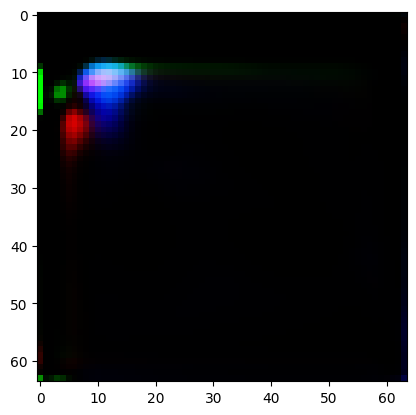

Training Epoch 9:  11%|█         | 41/377 [07:59<1:02:16, 11.12s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:  11%|█         | 42/377 [08:11<1:04:08, 11.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:  11%|█▏        | 43/377 [08:22<1:03:29, 11.41s/it]

Epoch 8, G Loss: 0.01471391599625349, D Loss: 0.08483373373746872
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Att

Training Epoch 9:  12%|█▏        | 44/377 [08:32<1:00:50, 10.96s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 9:  12%|█▏        | 45/377 [08:46<1:05:53, 11.91s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 9:  12%|█▏        | 46/377 [08:58<1:04:59, 11.78s/it]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 1, 7, 0, 0, 5, 0, 7, 2, 7, 6, 8, 5, 5, 8, 8, 1, 5, 2, 2, 7,
        1, 5, 8, 6, 6, 5, 7, 0, 2, 0, 7, 6, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1, 5,
        7, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 9:  12%|█▏        | 47/377 [09:09<1:03:09, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 9:  13%|█▎        | 48/377 [09:22<1:05:39, 11.97s/it]

Epoch 8, G Loss: 0.010253733024001122, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 9:  13%|█▎        | 49/377 [09:32<1:02:22, 11.41s/it]

Epoch 8, G Loss: 0.016019199043512344, D Loss: 0.08881808072328568
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 9:  13%|█▎        | 50/377 [09:43<1:02:32, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

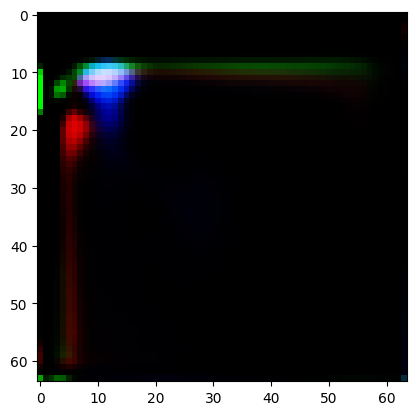

Training Epoch 9:  14%|█▎        | 51/377 [09:58<1:08:14, 12.56s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:  14%|█▍        | 52/377 [10:08<1:02:19, 11.51s/it]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 6, 1, 0, 0, 5, 0, 5, 1, 3, 6, 2, 6, 1, 2, 0, 3, 2, 1, 2, 6, 1, 3,
        6, 5, 3, 2, 5, 0, 2, 0, 5, 3, 3, 2, 5, 1, 2, 1, 6, 2, 0, 5, 1, 2, 6, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 9:  14%|█▍        | 53/377 [10:20<1:04:03, 11.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:  14%|█▍        | 54/377 [10:33<1:05:06, 12.09s/it]

Epoch 8, G Loss: 0.01599019393324852, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Genera

Training Epoch 9:  15%|█▍        | 55/377 [10:42<1:00:55, 11.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 9:  15%|█▍        | 56/377 [10:56<1:03:35, 11.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 9:  15%|█▌        | 57/377 [11:06<1:01:09, 11.47s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 9:  15%|█▌        | 58/377 [11:18<1:02:16, 11.71s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 9:  16%|█▌        | 59/377 [11:32<1:04:36, 12.19s/it]

Epoch 8, G Loss: 0.010979569517076015, D Loss: 0.07967814058065414
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attentio

Training Epoch 9:  16%|█▌        | 60/377 [11:41<1:00:02, 11.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 9:  16%|█▌        | 60/377 [11:42<1:01:49, 11.70s/it]


Epoch 10/50
Freezing Discriminator for this epoch...


Training Epoch 10:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

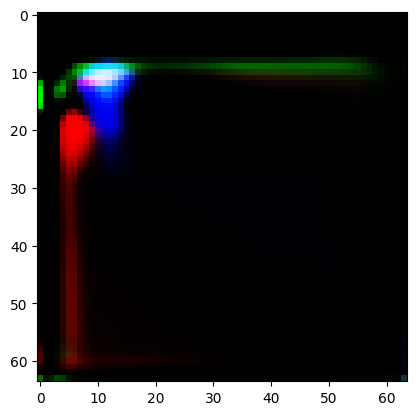

Training Epoch 10:   0%|          | 1/377 [00:14<1:31:11, 14.55s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   1%|          | 2/377 [00:27<1:24:30, 13.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   1%|          | 3/377 [00:36<1:10:35, 11.32s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 10:   1%|          | 4/377 [00:48<1:12:20, 11.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 10:   1%|▏         | 5/377 [00:59<1:10:36, 11.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   2%|▏         | 6/377 [01:09<1:08:06, 11.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   2%|▏         | 7/377 [01:22<1:11:35, 11.61s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   2%|▏         | 8/377 [01:31<1:06:20, 10.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 10:   2%|▏         | 9/377 [01:43<1:09:34, 11.34s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:   3%|▎         | 10/377 [01:55<1:09:17, 11.33s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

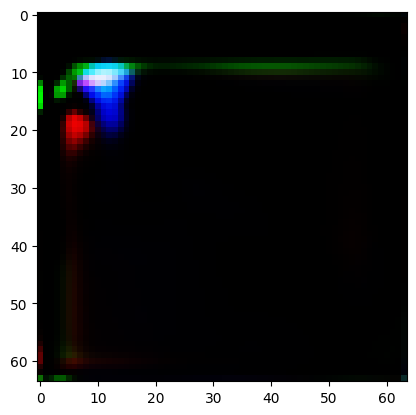

Training Epoch 10:   3%|▎         | 11/377 [02:05<1:07:30, 11.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   3%|▎         | 12/377 [02:18<1:10:52, 11.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   3%|▎         | 13/377 [02:27<1:05:51, 10.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   4%|▎         | 14/377 [02:39<1:07:09, 11.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   4%|▍         | 15/377 [02:50<1:06:53, 11.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 10:   4%|▍         | 16/377 [03:00<1:04:51, 10.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   5%|▍         | 17/377 [03:12<1:07:35, 11.26s/it]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   5%|▍         | 18/377 [03:21<1:03:12, 10.56s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   5%|▌         | 19/377 [03:34<1:07:02, 11.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   5%|▌         | 20/377 [03:45<1:06:05, 11.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

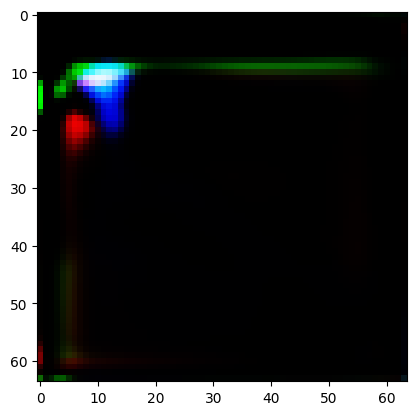

Training Epoch 10:   6%|▌         | 21/377 [03:56<1:05:10, 10.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   6%|▌         | 22/377 [04:09<1:09:33, 11.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   6%|▌         | 23/377 [04:19<1:05:16, 11.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   6%|▋         | 24/377 [04:32<1:09:20, 11.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   7%|▋         | 25/377 [04:45<1:10:58, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   7%|▋         | 26/377 [04:54<1:05:56, 11.27s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   7%|▋         | 27/377 [05:07<1:07:43, 11.61s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   7%|▋         | 28/377 [05:21<1:12:48, 12.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:   8%|▊         | 29/377 [05:30<1:06:15, 11.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:   8%|▊         | 30/377 [05:44<1:09:35, 12.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

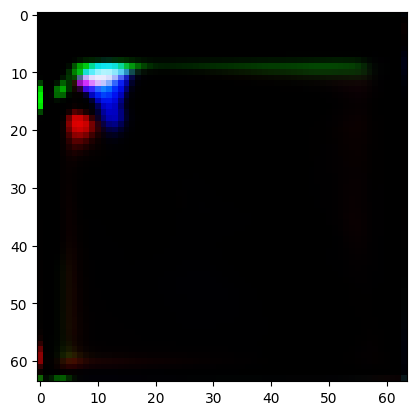

Training Epoch 10:   8%|▊         | 31/377 [05:58<1:14:15, 12.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   8%|▊         | 32/377 [06:07<1:07:10, 11.68s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   9%|▉         | 33/377 [06:20<1:08:16, 11.91s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:   9%|▉         | 34/377 [06:31<1:06:17, 11.60s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:   9%|▉         | 35/377 [06:41<1:03:27, 11.13s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  10%|▉         | 36/377 [06:54<1:07:21, 11.85s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:  10%|▉         | 37/377 [07:04<1:03:11, 11.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:  10%|█         | 38/377 [07:17<1:06:51, 11.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  10%|█         | 39/377 [07:30<1:07:35, 12.00s/it]

Batch Classes: [0, 1, 2, 3, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:  11%|█         | 40/377 [07:38<1:01:53, 11.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9, 10], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after

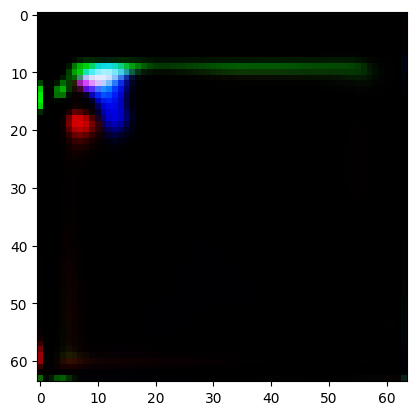

Training Epoch 10:  11%|█         | 41/377 [07:51<1:04:56, 11.60s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  11%|█         | 42/377 [08:02<1:03:46, 11.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  11%|█▏        | 43/377 [08:13<1:02:22, 11.21s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  12%|█▏        | 44/377 [08:26<1:05:39, 11.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  12%|█▏        | 45/377 [08:36<1:01:34, 11.13s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  12%|█▏        | 46/377 [08:48<1:03:26, 11.50s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  12%|█▏        | 47/377 [08:59<1:02:38, 11.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  13%|█▎        | 48/377 [09:09<1:00:05, 10.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:  13%|█▎        | 49/377 [09:24<1:05:55, 12.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  13%|█▎        | 50/377 [09:35<1:04:31, 11.84s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

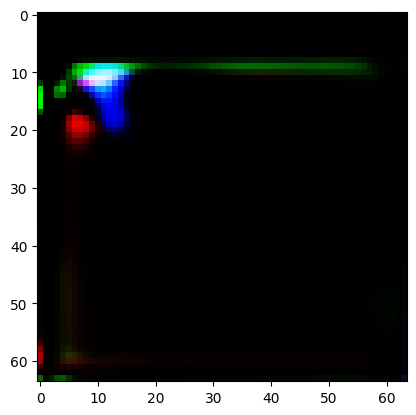

Training Epoch 10:  14%|█▎        | 51/377 [09:45<1:01:52, 11.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  14%|█▍        | 52/377 [09:57<1:02:29, 11.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  14%|█▍        | 53/377 [10:06<58:01, 10.75s/it]  

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 10:  14%|█▍        | 54/377 [10:20<1:03:22, 11.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 10:  15%|█▍        | 55/377 [10:34<1:06:42, 12.43s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  15%|█▍        | 56/377 [10:44<1:01:24, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  15%|█▌        | 57/377 [10:56<1:02:03, 11.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  15%|█▌        | 58/377 [11:09<1:04:37, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  16%|█▌        | 59/377 [11:18<59:48, 11.28s/it]  

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 10:  16%|█▌        | 60/377 [11:32<1:03:17, 11.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12


Training Epoch 10:  16%|█▌        | 60/377 [11:32<1:01:00, 11.55s/it]


Epoch 11/50


Training Epoch 11:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

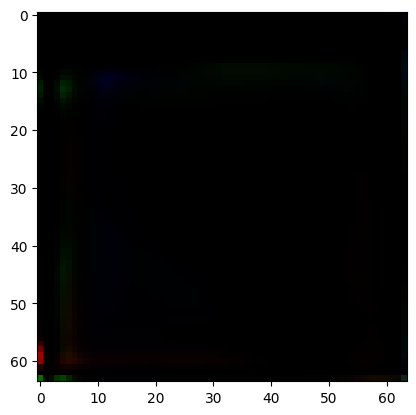

Training Epoch 11:   0%|          | 1/377 [00:14<1:32:33, 14.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:   1%|          | 2/377 [00:24<1:13:56, 11.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 11:   1%|          | 3/377 [00:37<1:15:45, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 11:   1%|          | 4/377 [00:51<1:20:08, 12.89s/it]

Epoch 10, G Loss: 0.009791417978703976, D Loss: 0.0
Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 4, 4, 8, 8, 1, 4, 4, 4, 6,
        1, 5, 8, 6, 5, 4, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        4, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 11:   1%|▏         | 5/377 [01:00<1:12:41, 11.73s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 11:   2%|▏         | 6/377 [01:12<1:13:31, 11.89s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 11:   2%|▏         | 7/377 [01:27<1:19:02, 12.82s/it]

Epoch 10, G Loss: 0.013654421083629131, D Loss: 0.0820242241024971
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attentio

Training Epoch 11:   2%|▏         | 8/377 [01:36<1:11:15, 11.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:   2%|▏         | 9/377 [01:50<1:14:45, 12.19s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 11:   3%|▎         | 10/377 [02:02<1:14:44, 12.22s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

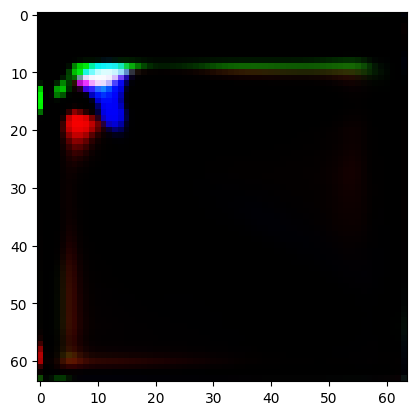

Training Epoch 11:   3%|▎         | 11/377 [02:12<1:10:34, 11.57s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:   3%|▎         | 12/377 [02:26<1:15:07, 12.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:   3%|▎         | 13/377 [02:39<1:16:03, 12.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:   4%|▎         | 14/377 [02:48<1:09:57, 11.56s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 11:   4%|▍         | 15/377 [03:02<1:12:26, 12.01s/it]

Epoch 10, G Loss: 0.01609998568892479, D Loss: 0.09402523934841156
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attentio

Training Epoch 11:   4%|▍         | 16/377 [03:11<1:07:14, 11.18s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 4, 8, 6, 4, 3, 6, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:   5%|▍         | 17/377 [03:23<1:09:11, 11.53s/it]

FID Score at Epoch 11: 1861.2691650390625
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 10
Adversarial Loss: -0.0066
Auxiliary Loss: 0.8405
Feature Matching Loss: 0.0187
Diversity Loss: -0.9998
Generator Gradient Norm for label_embedding.weight: 1.4162028492137324e-05
Generator Gradient Norm for label_embedding.bias: 2.9048454962321557e-05
Generator Gradient Norm for fc.0.weight: 0.00021969784575048834
Generator Gradient Norm for fc.0.bias: 1.3794665392197203e-05
Generator Gradient Norm for fc.1.weight: 5.821116701554274e-06
Generator Gradient Norm for fc.1.bias: 5.705754574591992e-06
Generator Gradient Norm for downsample.weight: 0.13180235028266907
Generator Gradient Norm for downsample.bias: 0.024098843336105347
Generator Gradient Norm for res_blocks.0.block.0.weight: 2.5639574232627638e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 4.841903233909761e

Training Epoch 11:   5%|▍         | 18/377 [03:35<1:09:32, 11.62s/it]

Epoch 10, G Loss: 0.01733899489045143, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 11:   5%|▌         | 19/377 [03:45<1:07:17, 11.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:   5%|▌         | 20/377 [03:58<1:09:13, 11.64s/it]

Epoch 10, G Loss: 0.012357275001704693, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

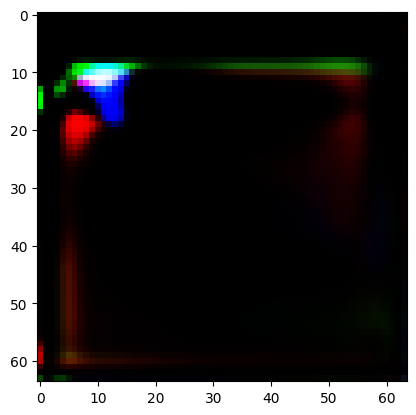

Training Epoch 11:   6%|▌         | 21/377 [04:08<1:06:22, 11.19s/it]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 11:   6%|▌         | 22/377 [04:22<1:10:54, 11.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 11:   6%|▌         | 23/377 [04:36<1:13:43, 12.50s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:   6%|▋         | 24/377 [04:45<1:08:34, 11.66s/it]

Epoch 10, G Loss: 0.009242565371096134, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 11:   7%|▋         | 25/377 [04:59<1:12:09, 12.30s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 11:   7%|▋         | 26/377 [05:12<1:13:23, 12.55s/it]

Epoch 10, G Loss: 0.019093310460448265, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 11:   7%|▋         | 27/377 [05:22<1:08:14, 11.70s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 11:   7%|▋         | 28/377 [05:33<1:07:17, 11.57s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 9, 9, 1, 3, 3, 3, 6,
        1, 5, 9, 6, 5, 3, 6, 7, 0, 2, 0, 9, 5, 5, 2, 7, 1, 2, 2, 9, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:   8%|▊         | 29/377 [05:46<1:09:19, 11.95s/it]

Epoch 10, G Loss: 0.01911044493317604, D Loss: 0.09438081085681915
Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 11:   8%|▊         | 30/377 [05:55<1:04:25, 11.14s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

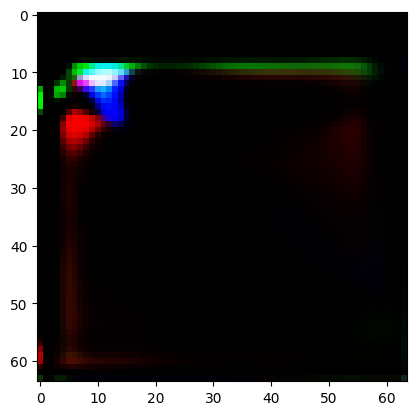

Training Epoch 11:   8%|▊         | 31/377 [06:10<1:10:10, 12.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 11:   8%|▊         | 32/377 [06:24<1:13:49, 12.84s/it]

Epoch 10, G Loss: -0.010952407494187355, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gen

Training Epoch 11:   9%|▉         | 33/377 [06:34<1:08:01, 11.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 11:   9%|▉         | 34/377 [06:47<1:09:32, 12.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 4, 8, 6, 4, 3, 6, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:   9%|▉         | 35/377 [07:01<1:13:05, 12.82s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:  10%|▉         | 36/377 [07:11<1:07:30, 11.88s/it]

Epoch 10, G Loss: 0.015147856436669827, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 11:  10%|▉         | 37/377 [07:23<1:08:39, 12.12s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:  10%|█         | 38/377 [07:38<1:12:43, 12.87s/it]

Epoch 10, G Loss: 0.013121253810822964, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 11:  10%|█         | 39/377 [07:48<1:08:25, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 11:  11%|█         | 40/377 [08:03<1:11:52, 12.80s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

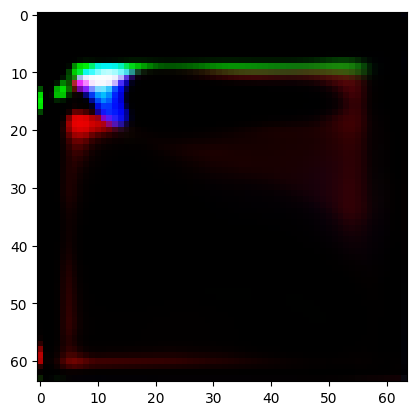

Training Epoch 11:  11%|█         | 41/377 [08:17<1:14:46, 13.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 11:  11%|█         | 42/377 [08:29<1:11:11, 12.75s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 5,  0,  9,  2,  1,  1,  6,  0,  8,  3,  5, 10,  4, 10,  2,  4,  1,  5,
         4,  2,  4, 10,  1,  5,  9,  6,  6,  4,  8,  0,  3,  0,  8,  6,  5,  3,
         9,  1,  3,  3, 10,  3,  1,  8,  2,  4,  9,  6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generat

Training Epoch 11:  11%|█▏        | 43/377 [08:40<1:09:01, 12.40s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 11:  12%|█▏        | 44/377 [08:53<1:09:15, 12.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:  12%|█▏        | 45/377 [09:03<1:05:26, 11.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:  12%|█▏        | 46/377 [09:17<1:08:47, 12.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 11:  12%|█▏        | 47/377 [09:32<1:13:00, 13.27s/it]

FID Score at Epoch 11: 1634.8009033203125
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 10
Adversarial Loss: -0.0052
Auxiliary Loss: 1.0384
Feature Matching Loss: 0.0098
Diversity Loss: -0.9995
Generator Gradient Norm for label_embedding.weight: 2.8574557290994562e-05
Generator Gradient Norm for label_embedding.bias: 6.23183996140142e-06
Generator Gradient Norm for fc.0.weight: 0.0004947019042447209
Generator Gradient Norm for fc.0.bias: 2.6177633117185906e-05
Generator Gradient Norm for fc.1.weight: 1.1705964425345883e-05
Generator Gradient Norm for fc.1.bias: 1.1947762686759233e-05
Generator Gradient Norm for downsample.weight: 0.13287357985973358
Generator Gradient Norm for downsample.bias: 0.02429160475730896
Generator Gradient Norm for res_blocks.0.block.0.weight: 5.474809768202249e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 1.2854765429892723e-0

Training Epoch 11:  13%|█▎        | 48/377 [09:47<1:15:41, 13.80s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:  13%|█▎        | 49/377 [09:57<1:09:03, 12.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 11:  13%|█▎        | 50/377 [10:09<1:07:52, 12.45s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

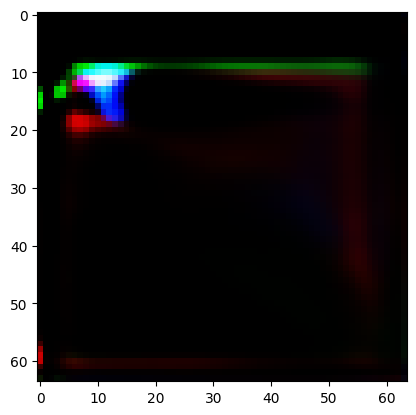

Training Epoch 11:  14%|█▎        | 51/377 [10:25<1:11:55, 13.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 11:  14%|█▍        | 52/377 [10:34<1:05:21, 12.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 11:  14%|█▍        | 53/377 [10:49<1:09:40, 12.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 11:  14%|█▍        | 54/377 [11:02<1:10:52, 13.17s/it]

Epoch 10, G Loss: 0.013304517604410648, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 11:  15%|█▍        | 55/377 [11:13<1:06:16, 12.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:  15%|█▍        | 56/377 [11:27<1:08:40, 12.84s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 8, 1, 0, 4, 0, 6, 2, 8, 6, 8, 3, 3, 9, 9, 1, 3, 3, 3, 6,
        1, 4, 9, 6, 4, 3, 6, 8, 0, 2, 0, 9, 4, 4, 2, 8, 1, 2, 2, 9, 2, 0, 6, 1,
        3, 8, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 11:  15%|█▌        | 57/377 [11:41<1:09:52, 13.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 11:  15%|█▌        | 58/377 [11:52<1:07:43, 12.74s/it]

Epoch 10, G Loss: 0.013863793574273586, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 11:  16%|█▌        | 59/377 [12:04<1:04:59, 12.26s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 11:  16%|█▌        | 60/377 [12:17<1:05:59, 12.49s/it]

Epoch 10, G Loss: 0.014998497441411018, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12


Training Epoch 11:  16%|█▌        | 60/377 [12:17<1:04:57, 12.30s/it]


Epoch 12/50


Training Epoch 12:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

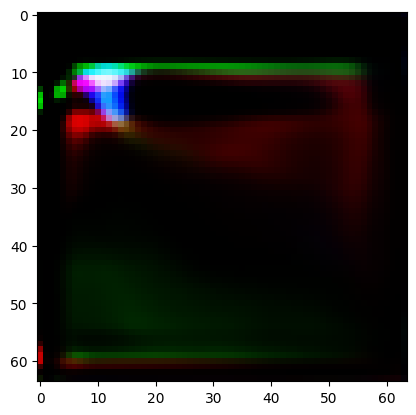

Training Epoch 12:   0%|          | 1/377 [00:14<1:33:54, 14.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 12:   1%|          | 2/377 [00:24<1:13:29, 11.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:   1%|          | 3/377 [00:39<1:22:09, 13.18s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 12:   1%|          | 4/377 [00:54<1:26:11, 13.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 12:   1%|▏         | 5/377 [01:04<1:16:50, 12.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   2%|▏         | 6/377 [01:15<1:15:14, 12.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:   2%|▏         | 7/377 [01:30<1:19:41, 12.92s/it]

Epoch 11, G Loss: 0.013576189987361431, D Loss: 0.07912595570087433
Batch Classes: [0, 1, 2, 3, 4, 5, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attenti

Training Epoch 12:   2%|▏         | 8/377 [01:39<1:12:05, 11.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 4, 8, 6, 4, 3, 6, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:   2%|▏         | 9/377 [01:53<1:15:46, 12.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   3%|▎         | 10/377 [02:07<1:19:02, 12.92s/it]

Epoch 11, G Loss: 0.01294521614909172, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

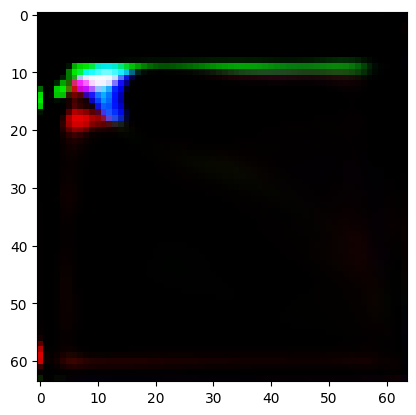

Training Epoch 12:   3%|▎         | 11/377 [02:17<1:13:23, 12.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 12:   3%|▎         | 12/377 [02:29<1:12:51, 11.98s/it]

Batch Classes: [0, 2, 3, 5, 7, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 0, 0, 7, 0, 7, 2, 5, 8, 3, 8, 2, 3, 0, 5, 3, 2, 3, 8, 2, 5,
        8, 7, 5, 3, 7, 0, 3, 0, 7, 5, 5, 3, 7, 2, 3, 2, 8, 3, 0, 7, 2, 3, 8, 5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 12:   3%|▎         | 13/377 [02:44<1:17:58, 12.85s/it]

Epoch 11, G Loss: 0.00812496617436409, D Loss: 0.0847860723733902
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Att

Training Epoch 12:   4%|▎         | 14/377 [02:53<1:11:08, 11.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9, 10], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 5,  0,  9,  2,  1,  1,  6,  0,  8,  3,  5, 10,  4, 10,  2,  4,  1,  5,
         4,  2,  4, 10,  1,  5,  9,  6,  6,  4,  8,  0,  3,  0,  8,  6,  5,  3,
         9,  1,  3,  3, 10,  3,  1,  8,  2,  4,  9,  6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generat

Training Epoch 12:   4%|▍         | 15/377 [03:08<1:16:50, 12.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 12:   4%|▍         | 16/377 [03:21<1:16:37, 12.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 12:   5%|▍         | 17/377 [03:31<1:11:44, 11.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 12:   5%|▍         | 18/377 [03:42<1:10:40, 11.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 12:   5%|▌         | 19/377 [03:57<1:16:16, 12.78s/it]

Epoch 11, G Loss: 0.01066614966839552, D Loss: 0.08396637439727783
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 12:   5%|▌         | 20/377 [04:06<1:09:44, 11.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

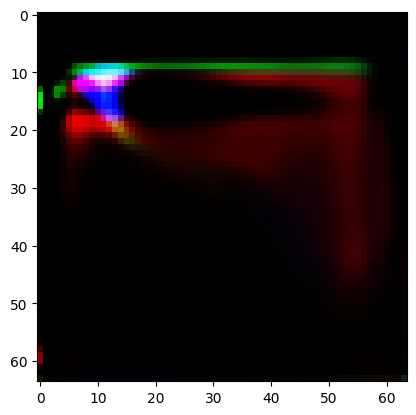

Training Epoch 12:   6%|▌         | 21/377 [04:21<1:13:39, 12.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   6%|▌         | 22/377 [04:34<1:16:11, 12.88s/it]

Epoch 11, G Loss: -0.010568564757704735, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gen

Training Epoch 12:   6%|▌         | 23/377 [04:44<1:09:47, 11.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   6%|▋         | 24/377 [04:58<1:13:12, 12.44s/it]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 1, 7, 0, 0, 5, 0, 7, 2, 7, 6, 8, 5, 5, 8, 8, 1, 5, 2, 2, 7,
        1, 5, 8, 6, 6, 5, 7, 0, 2, 0, 7, 6, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1, 5,
        7, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 12:   7%|▋         | 25/377 [05:12<1:17:03, 13.14s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   7%|▋         | 26/377 [05:22<1:09:56, 11.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 9, 9, 1, 3, 3, 3, 6,
        1, 4, 9, 6, 4, 3, 6, 7, 0, 2, 0, 9, 4, 4, 2, 7, 1, 2, 2, 9, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:   7%|▋         | 27/377 [05:36<1:13:02, 12.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 12:   7%|▋         | 28/377 [05:48<1:13:14, 12.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:   8%|▊         | 29/377 [05:58<1:08:40, 11.84s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   8%|▊         | 30/377 [06:11<1:09:28, 12.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

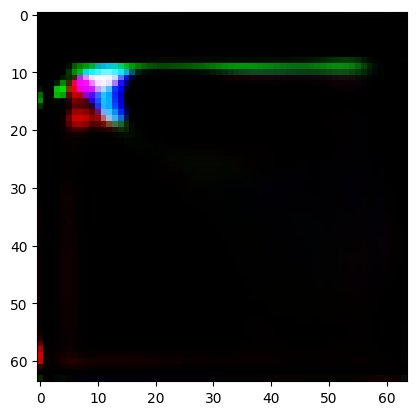

Training Epoch 12:   8%|▊         | 31/377 [06:22<1:07:57, 11.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   8%|▊         | 32/377 [06:35<1:09:53, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:   9%|▉         | 33/377 [06:49<1:13:11, 12.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:   9%|▉         | 34/377 [07:01<1:10:50, 12.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 12:   9%|▉         | 35/377 [07:12<1:07:59, 11.93s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:  10%|▉         | 36/377 [07:26<1:12:44, 12.80s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 12:  10%|▉         | 37/377 [07:38<1:11:00, 12.53s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 12:  10%|█         | 38/377 [07:50<1:08:45, 12.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 12:  10%|█         | 39/377 [08:04<1:12:29, 12.87s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:  11%|█         | 40/377 [08:16<1:10:28, 12.55s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

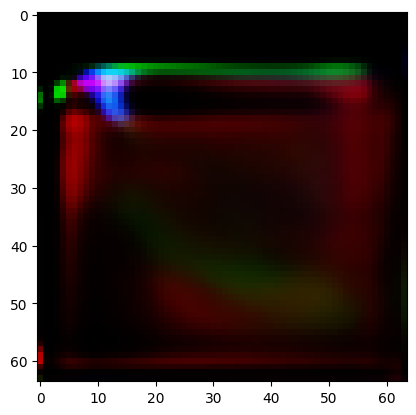

Training Epoch 12:  11%|█         | 41/377 [08:28<1:08:36, 12.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 12:  11%|█         | 42/377 [08:42<1:12:10, 12.93s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 12:  11%|█▏        | 43/377 [08:54<1:10:00, 12.58s/it]

Epoch 11, G Loss: 0.00863121822476387, D Loss: 0.08460620790719986
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 12:  12%|█▏        | 44/377 [09:04<1:05:27, 11.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 8, 1, 0, 4, 0, 6, 2, 8, 6, 8, 3, 3, 9, 9, 1, 3, 3, 3, 6,
        1, 4, 9, 6, 4, 3, 6, 8, 0, 2, 0, 9, 4, 4, 2, 8, 1, 2, 2, 9, 2, 0, 6, 1,
        3, 8, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:  12%|█▏        | 45/377 [09:18<1:08:54, 12.45s/it]

Batch Classes: [0, 1, 2, 3, 5, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 12:  12%|█▏        | 46/377 [09:29<1:06:58, 12.14s/it]

Epoch 11, G Loss: 0.01061971578747034, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 12:  12%|█▏        | 47/377 [09:40<1:04:47, 11.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:  13%|█▎        | 48/377 [09:53<1:06:27, 12.12s/it]

Epoch 11, G Loss: 0.013799527660012245, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 12:  13%|█▎        | 49/377 [10:03<1:02:51, 11.50s/it]

Epoch 11, G Loss: 0.013806967064738274, D Loss: 0.07902006804943085
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
S

Training Epoch 12:  13%|█▎        | 50/377 [10:17<1:06:37, 12.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

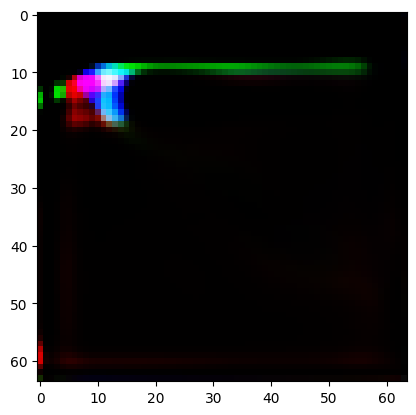

Training Epoch 12:  14%|█▎        | 51/377 [10:30<1:08:09, 12.55s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:  14%|█▍        | 52/377 [10:40<1:03:47, 11.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 12:  14%|█▍        | 53/377 [10:55<1:07:55, 12.58s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 12:  14%|█▍        | 54/377 [11:08<1:08:35, 12.74s/it]

Epoch 11, G Loss: 0.013607189990580082, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 12:  15%|█▍        | 55/377 [11:17<1:03:21, 11.81s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 12:  15%|█▍        | 56/377 [11:30<1:03:37, 11.89s/it]

FID Score at Epoch 12: 1768.2020263671875
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 11
Adversarial Loss: -0.0050
Auxiliary Loss: 0.9392
Feature Matching Loss: 0.0038
Diversity Loss: -0.9998
Generator Gradient Norm for label_embedding.weight: 1.1468660886748694e-05
Generator Gradient Norm for label_embedding.bias: 9.134295396506786e-06
Generator Gradient Norm for fc.0.weight: 0.0002428148582112044
Generator Gradient Norm for fc.0.bias: 2.2767602786188945e-05
Generator Gradient Norm for fc.1.weight: 9.067958671948873e-06
Generator Gradient Norm for fc.1.bias: 1.0144307452719659e-05
Generator Gradient Norm for downsample.weight: 0.13641180098056793
Generator Gradient Norm for downsample.bias: 0.02502291463315487
Generator Gradient Norm for res_blocks.0.block.0.weight: 2.8733888939314056e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 6.357122828148931e-0

Training Epoch 12:  15%|█▌        | 57/377 [11:43<1:06:24, 12.45s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 12:  15%|█▌        | 58/377 [11:53<1:01:05, 11.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 12:  16%|█▌        | 59/377 [12:06<1:04:37, 12.19s/it]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 12:  16%|█▌        | 60/377 [12:19<1:05:37, 12.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12


Training Epoch 12:  16%|█▌        | 60/377 [12:20<1:05:12, 12.34s/it]


Epoch 13/50


Training Epoch 13:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

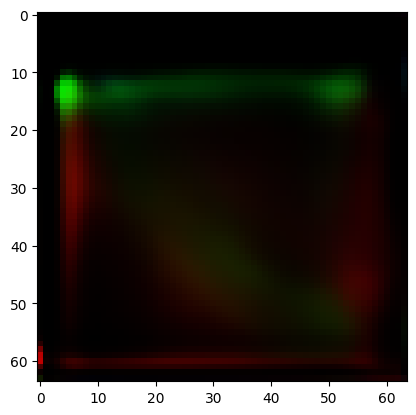

Training Epoch 13:   0%|          | 1/377 [00:13<1:26:39, 13.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:   1%|          | 2/377 [00:26<1:22:54, 13.26s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:   1%|          | 3/377 [00:41<1:27:20, 14.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:   1%|          | 4/377 [00:52<1:20:22, 12.93s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:   1%|▏         | 5/377 [01:04<1:17:07, 12.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   2%|▏         | 6/377 [01:16<1:16:58, 12.45s/it]

Epoch 12, G Loss: 0.013349427841603756, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 13:   2%|▏         | 7/377 [01:26<1:11:14, 11.55s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   2%|▏         | 8/377 [01:39<1:13:18, 11.92s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 13:   2%|▏         | 9/377 [01:54<1:19:06, 12.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   3%|▎         | 10/377 [02:03<1:11:59, 11.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

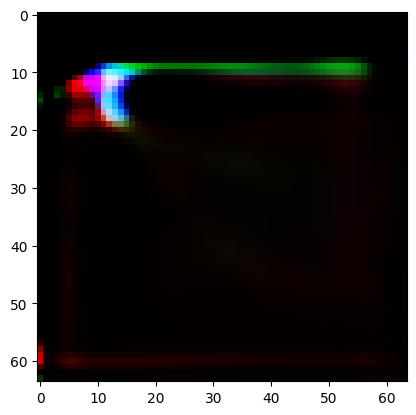

Training Epoch 13:   3%|▎         | 11/377 [02:17<1:16:25, 12.53s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   3%|▎         | 12/377 [02:32<1:20:17, 13.20s/it]

Epoch 12, G Loss: -0.01097897905856371, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 13:   3%|▎         | 13/377 [02:42<1:14:05, 12.21s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 13:   4%|▎         | 14/377 [02:54<1:14:06, 12.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:   4%|▍         | 15/377 [03:10<1:19:16, 13.14s/it]

Epoch 12, G Loss: 0.01043661404401064, D Loss: 0.08347494900226593
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 13:   4%|▍         | 16/377 [03:19<1:12:11, 12.00s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:   5%|▍         | 17/377 [03:33<1:15:06, 12.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:   5%|▍         | 18/377 [03:46<1:16:56, 12.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 13:   5%|▌         | 19/377 [03:56<1:11:01, 11.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:   5%|▌         | 20/377 [04:10<1:14:07, 12.46s/it]

FID Score at Epoch 13: 1758.21875
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 12
Adversarial Loss: -0.0049
Auxiliary Loss: 1.1554
Feature Matching Loss: 0.0025
Diversity Loss: -0.9993
Generator Gradient Norm for label_embedding.weight: 4.5400716771837324e-05
Generator Gradient Norm for label_embedding.bias: 0.0001175792858703062
Generator Gradient Norm for fc.0.weight: 0.0005547111504711211
Generator Gradient Norm for fc.0.bias: 4.698985139839351e-05
Generator Gradient Norm for fc.1.weight: 1.9360049918759614e-05
Generator Gradient Norm for fc.1.bias: 1.9157048882334493e-05
Generator Gradient Norm for downsample.weight: 0.1375921666622162
Generator Gradient Norm for downsample.bias: 0.025282783433794975
Generator Gradient Norm for res_blocks.0.block.0.weight: 6.084366759750992e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 1.3637099982588552e-07
Genera

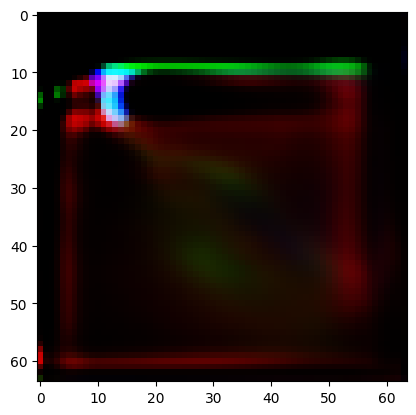

Training Epoch 13:   6%|▌         | 21/377 [04:25<1:18:25, 13.22s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 13:   6%|▌         | 22/377 [04:34<1:11:20, 12.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 1,  4,  8,  0,  2,  6,  1,  0,  4,  0,  6,  2,  8,  5,  8,  4,  4, 11,
        11,  2,  3,  3,  3,  6,  1,  4, 11,  6,  5,  4,  6,  0,  3,  0,  8,  5,
         5,  3,  8,  1,  3,  2, 11,  2,  1,  6,  2,  4,  8,  5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Insid

Training Epoch 13:   6%|▌         | 23/377 [04:48<1:14:17, 12.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   6%|▋         | 24/377 [05:03<1:17:37, 13.20s/it]

Epoch 12, G Loss: 0.005273016169667244, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 13:   7%|▋         | 25/377 [05:13<1:11:50, 12.25s/it]

Epoch 12, G Loss: 0.01624215766787529, D Loss: 0.09064775705337524
Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attentio

Training Epoch 13:   7%|▋         | 26/377 [05:25<1:11:37, 12.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:   7%|▋         | 27/377 [05:40<1:15:55, 13.02s/it]

Epoch 12, G Loss: 0.010525424033403397, D Loss: 0.08255291730165482
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape a

Training Epoch 13:   7%|▋         | 28/377 [05:49<1:09:08, 11.89s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 13:   8%|▊         | 29/377 [06:02<1:11:25, 12.31s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   8%|▊         | 30/377 [06:16<1:13:10, 12.65s/it]

Epoch 12, G Loss: 0.007482497952878475, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

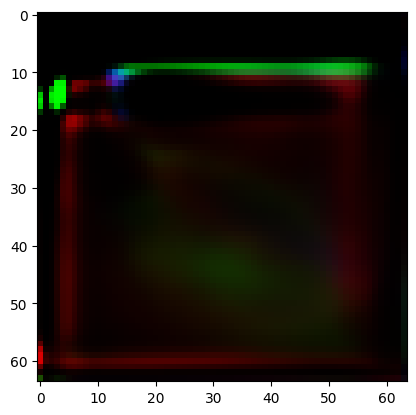

Training Epoch 13:   8%|▊         | 31/377 [06:26<1:08:36, 11.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:   8%|▊         | 32/377 [06:39<1:10:26, 12.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:   9%|▉         | 33/377 [06:54<1:14:34, 13.01s/it]

Epoch 12, G Loss: 0.01342987921088934, D Loss: 0.08388545364141464
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 13:   9%|▉         | 34/377 [07:03<1:07:56, 11.89s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 13:   9%|▉         | 35/377 [07:17<1:11:37, 12.57s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:  10%|▉         | 36/377 [07:31<1:14:15, 13.06s/it]

Epoch 12, G Loss: 0.009320216253399849, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 8, 0, 2, 7, 1, 0, 5, 0, 7, 2, 8, 6, 8, 5, 5, 9, 9, 2, 3, 3, 3, 7,
        1, 5, 9, 7, 6, 5, 7, 0, 3, 0, 8, 6, 6, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 5,
        8, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 13:  10%|▉         | 37/377 [07:41<1:08:07, 12.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 13:  10%|█         | 38/377 [07:54<1:09:28, 12.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 9, 9, 1, 3, 3, 3, 6,
        1, 4, 9, 6, 4, 3, 6, 7, 0, 2, 0, 9, 4, 4, 2, 7, 1, 2, 2, 9, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:  10%|█         | 39/377 [08:08<1:12:18, 12.83s/it]

Epoch 12, G Loss: 0.022107070311903954, D Loss: 0.08924052119255066
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape a

Training Epoch 13:  11%|█         | 40/377 [08:17<1:06:00, 11.75s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

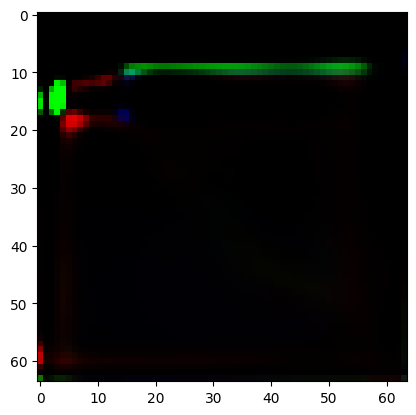

Training Epoch 13:  11%|█         | 41/377 [08:30<1:08:19, 12.20s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:  11%|█         | 42/377 [08:45<1:12:27, 12.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:  11%|█▏        | 43/377 [08:56<1:08:28, 12.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:  12%|█▏        | 44/377 [09:10<1:10:39, 12.73s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 13:  12%|█▏        | 45/377 [09:23<1:11:43, 12.96s/it]

Epoch 12, G Loss: 0.013901165686547756, D Loss: 0.08530293405056
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Atte

Training Epoch 13:  12%|█▏        | 46/377 [09:32<1:05:28, 11.87s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 9, 9, 1, 3, 3, 3, 5,
        1, 4, 9, 5, 4, 3, 5, 6, 0, 2, 0, 9, 4, 4, 2, 6, 1, 2, 2, 9, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:  12%|█▏        | 47/377 [09:45<1:06:40, 12.12s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:  13%|█▎        | 48/377 [09:57<1:06:02, 12.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:  13%|█▎        | 49/377 [10:07<1:03:11, 11.56s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 13:  13%|█▎        | 50/377 [10:22<1:08:18, 12.53s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

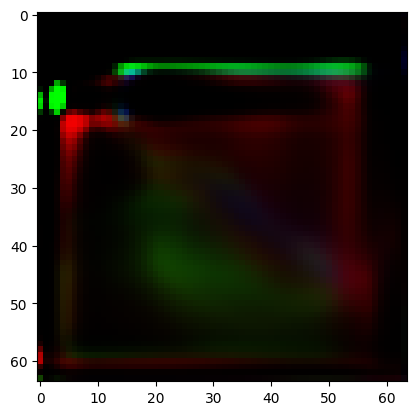

Training Epoch 13:  14%|█▎        | 51/377 [10:35<1:07:44, 12.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:  14%|█▍        | 52/377 [10:46<1:05:45, 12.14s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 13:  14%|█▍        | 53/377 [11:01<1:09:59, 12.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 13:  14%|█▍        | 54/377 [11:13<1:08:06, 12.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 4, 4, 3, 6, 0, 2, 0, 6, 4, 3, 2, 6, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 13:  15%|█▍        | 55/377 [11:24<1:06:18, 12.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:  15%|█▍        | 56/377 [11:39<1:10:16, 13.14s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 13:  15%|█▌        | 57/377 [11:55<1:13:59, 13.87s/it]

Epoch 12, G Loss: 0.019256211817264557, D Loss: 0.08753447979688644
Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 13:  15%|█▌        | 58/377 [12:05<1:06:58, 12.60s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 13:  16%|█▌        | 59/377 [12:17<1:06:59, 12.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 13:  16%|█▌        | 60/377 [12:32<1:10:14, 13.29s/it]

Epoch 12, G Loss: 0.019025709480047226, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 13:  16%|█▌        | 60/377 [12:33<1:06:19, 12.55s/it]


Epoch 14/50


Training Epoch 14:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

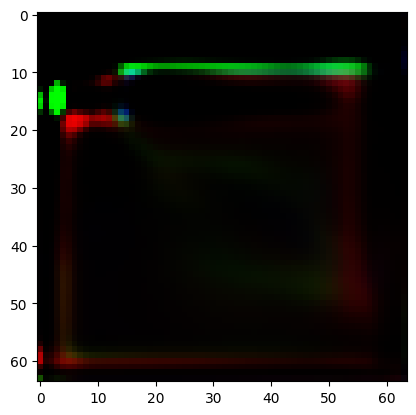

Training Epoch 14:   0%|          | 1/377 [00:14<1:28:15, 14.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:   1%|          | 2/377 [00:24<1:15:55, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 8, 0, 2, 7, 1, 0, 5, 0, 7, 2, 8, 6, 8, 5, 5, 9, 9, 2, 3, 3, 3, 7,
        1, 5, 9, 7, 6, 5, 7, 0, 3, 0, 8, 6, 6, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 5,
        8, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:   1%|          | 3/377 [00:39<1:23:48, 13.45s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:   1%|          | 4/377 [00:51<1:18:53, 12.69s/it]

Batch Classes: [0, 1, 2, 4, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 1, 7, 0, 0, 4, 0, 7, 2, 7, 5, 8, 4, 4, 8, 8, 1, 4, 2, 2, 7,
        1, 4, 8, 5, 5, 4, 7, 0, 2, 0, 7, 5, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 14:   1%|▏         | 5/377 [01:02<1:15:22, 12.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:   2%|▏         | 6/377 [01:15<1:16:54, 12.44s/it]

Epoch 13, G Loss: 0.017065539956092834, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 14:   2%|▏         | 7/377 [01:26<1:12:50, 11.81s/it]

Epoch 13, G Loss: 0.005541112273931503, D Loss: 0.08494552224874496
Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention bl

Training Epoch 14:   2%|▏         | 8/377 [01:40<1:16:46, 12.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 14:   2%|▏         | 9/377 [01:53<1:17:41, 12.67s/it]

Epoch 13, G Loss: 0.01677202805876732, D Loss: 0.08690875768661499
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 14:   3%|▎         | 10/377 [02:02<1:12:02, 11.78s/it]

Epoch 13, G Loss: 0.014518298208713531, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

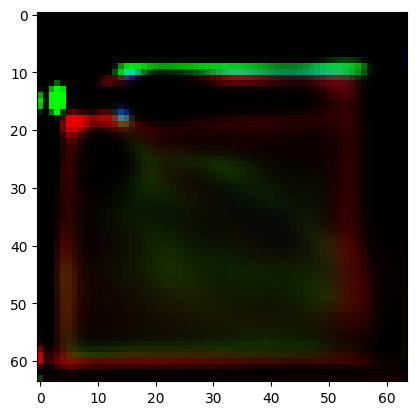

Training Epoch 14:   3%|▎         | 11/377 [02:16<1:14:38, 12.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 14:   3%|▎         | 12/377 [02:30<1:17:25, 12.73s/it]

Epoch 13, G Loss: -0.011130307801067829, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gen

Training Epoch 14:   3%|▎         | 13/377 [02:40<1:12:53, 12.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:   4%|▎         | 14/377 [02:54<1:17:13, 12.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 14:   4%|▍         | 15/377 [03:09<1:19:50, 13.23s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:   4%|▍         | 16/377 [03:21<1:17:25, 12.87s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 14:   5%|▍         | 17/377 [03:31<1:13:20, 12.22s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 14:   5%|▍         | 18/377 [03:44<1:14:23, 12.43s/it]

Epoch 13, G Loss: 0.010013766586780548, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 14:   5%|▌         | 19/377 [03:54<1:10:01, 11.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:   5%|▌         | 20/377 [04:07<1:11:00, 11.93s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

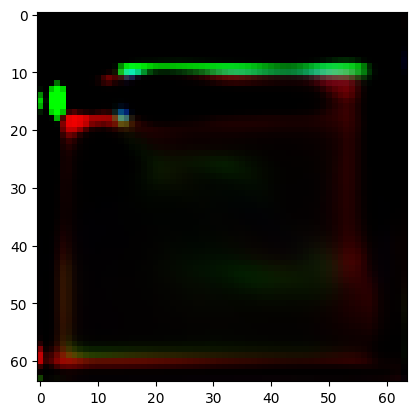

Training Epoch 14:   6%|▌         | 21/377 [04:22<1:15:52, 12.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:   6%|▌         | 22/377 [04:31<1:09:12, 11.70s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:   6%|▌         | 23/377 [04:45<1:13:00, 12.37s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 14:   6%|▋         | 24/377 [04:56<1:11:09, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:   7%|▋         | 25/377 [05:07<1:08:21, 11.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 14:   7%|▋         | 26/377 [05:22<1:13:39, 12.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:   7%|▋         | 27/377 [05:33<1:11:26, 12.25s/it]

Epoch 13, G Loss: 0.012599153444170952, D Loss: 0.08945761620998383
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 14:   7%|▋         | 28/377 [05:45<1:09:54, 12.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:   8%|▊         | 29/377 [05:59<1:14:37, 12.86s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:   8%|▊         | 30/377 [06:11<1:12:13, 12.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

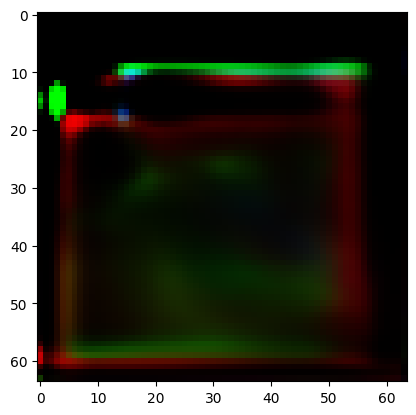

Training Epoch 14:   8%|▊         | 31/377 [06:22<1:09:28, 12.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 14:   8%|▊         | 32/377 [06:35<1:11:41, 12.47s/it]

Epoch 13, G Loss: -0.01124727912247181, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 14:   9%|▉         | 33/377 [06:46<1:08:04, 11.87s/it]

Epoch 13, G Loss: 0.0105241434648633, D Loss: 0.08196146041154861
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Att

Training Epoch 14:   9%|▉         | 34/377 [06:58<1:07:40, 11.84s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 14:   9%|▉         | 35/377 [07:12<1:11:05, 12.47s/it]

Epoch 13, G Loss: 0.013056575320661068, D Loss: 0.08850707113742828
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 14:  10%|▉         | 36/377 [07:21<1:05:17, 11.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 8, 3, 3, 8, 8, 1, 3, 2, 2, 5,
        1, 3, 8, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 8, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 14:  10%|▉         | 37/377 [07:34<1:08:35, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:  10%|█         | 38/377 [07:46<1:07:32, 11.95s/it]

Epoch 13, G Loss: 0.010696211829781532, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 14:  10%|█         | 39/377 [07:57<1:06:02, 11.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:  11%|█         | 40/377 [08:12<1:11:02, 12.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

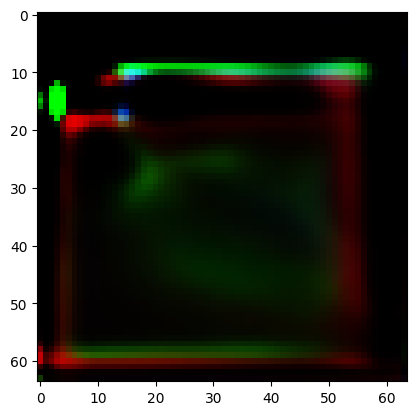

Training Epoch 14:  11%|█         | 41/377 [08:24<1:09:56, 12.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:  11%|█         | 42/377 [08:35<1:06:44, 11.95s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 14:  11%|█▏        | 43/377 [08:50<1:12:09, 12.96s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:  12%|█▏        | 44/377 [09:06<1:16:27, 13.78s/it]

Epoch 13, G Loss: 0.012617389671504498, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 14:  12%|█▏        | 45/377 [09:16<1:10:31, 12.74s/it]

Epoch 13, G Loss: 0.017533646896481514, D Loss: 0.08448687940835953
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 14:  12%|█▏        | 46/377 [09:29<1:10:51, 12.84s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:  12%|█▏        | 47/377 [09:44<1:13:07, 13.29s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 14:  13%|█▎        | 48/377 [09:53<1:06:41, 12.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:  13%|█▎        | 49/377 [10:07<1:09:32, 12.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:  13%|█▎        | 50/377 [10:22<1:12:40, 13.34s/it]

Epoch 13, G Loss: 0.014728707261383533, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

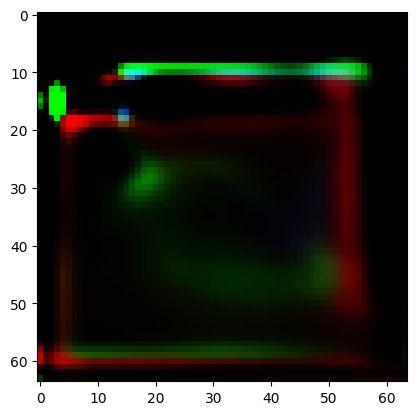

Training Epoch 14:  14%|█▎        | 51/377 [10:33<1:08:05, 12.53s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 14:  14%|█▍        | 52/377 [10:47<1:10:15, 12.97s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:  14%|█▍        | 53/377 [11:02<1:13:31, 13.62s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 14:  14%|█▍        | 54/377 [11:13<1:10:21, 13.07s/it]

Epoch 13, G Loss: 0.008702907711267471, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 14:  15%|█▍        | 55/377 [11:25<1:07:33, 12.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 14:  15%|█▍        | 56/377 [11:38<1:08:36, 12.82s/it]

Epoch 13, G Loss: 0.011652464047074318, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 14:  15%|█▌        | 57/377 [11:50<1:07:09, 12.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 14:  15%|█▌        | 58/377 [12:03<1:07:14, 12.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 14:  16%|█▌        | 59/377 [12:15<1:06:28, 12.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 14:  16%|█▌        | 60/377 [12:25<1:02:02, 11.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 14:  16%|█▌        | 60/377 [12:26<1:05:44, 12.44s/it]


Epoch 15/50
Freezing Discriminator for this epoch...


Training Epoch 15:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

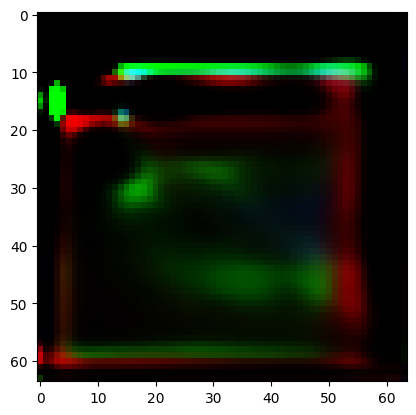

Training Epoch 15:   0%|          | 1/377 [00:14<1:33:37, 14.94s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   1%|          | 2/377 [00:27<1:25:42, 13.71s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   1%|          | 3/377 [00:37<1:14:04, 11.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   1%|          | 4/377 [00:50<1:17:34, 12.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   1%|▏         | 5/377 [01:03<1:18:19, 12.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 15:   2%|▏         | 6/377 [01:12<1:10:31, 11.41s/it]

Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 15:   2%|▏         | 7/377 [01:25<1:12:50, 11.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   2%|▏         | 8/377 [01:36<1:10:55, 11.53s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   2%|▏         | 9/377 [01:47<1:10:24, 11.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   3%|▎         | 10/377 [02:01<1:14:43, 12.22s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

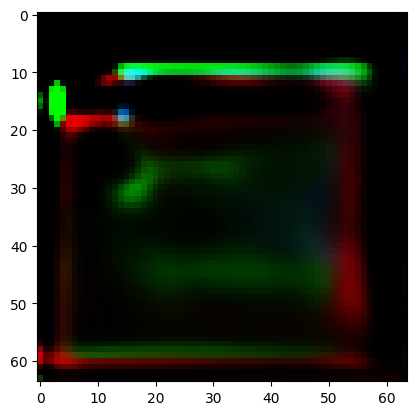

Training Epoch 15:   3%|▎         | 11/377 [02:13<1:13:18, 12.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   3%|▎         | 12/377 [02:25<1:14:33, 12.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   3%|▎         | 13/377 [02:40<1:19:05, 13.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 11], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise injec

Training Epoch 15:   4%|▎         | 14/377 [02:51<1:15:23, 12.46s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   4%|▍         | 15/377 [03:03<1:12:57, 12.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   4%|▍         | 16/377 [03:16<1:15:02, 12.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   5%|▍         | 17/377 [03:25<1:08:56, 11.49s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   5%|▍         | 18/377 [03:39<1:12:30, 12.12s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   5%|▌         | 19/377 [03:54<1:17:27, 12.98s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   5%|▌         | 20/377 [04:04<1:11:29, 12.02s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

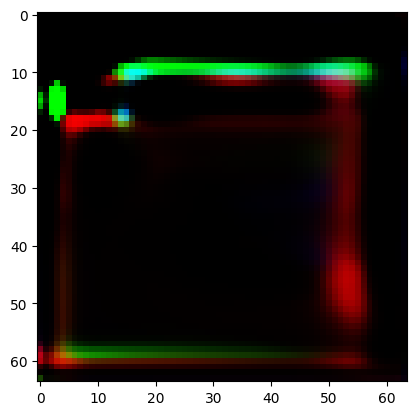

Training Epoch 15:   6%|▌         | 21/377 [04:17<1:13:00, 12.31s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   6%|▌         | 22/377 [04:31<1:17:17, 13.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   6%|▌         | 23/377 [04:41<1:10:05, 11.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   6%|▋         | 24/377 [04:53<1:11:32, 12.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   7%|▋         | 25/377 [05:05<1:10:01, 11.94s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   7%|▋         | 26/377 [05:15<1:06:00, 11.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:   7%|▋         | 27/377 [05:28<1:09:50, 11.97s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   7%|▋         | 28/377 [05:38<1:05:38, 11.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   8%|▊         | 29/377 [05:51<1:08:14, 11.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   8%|▊         | 30/377 [06:02<1:07:03, 11.59s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

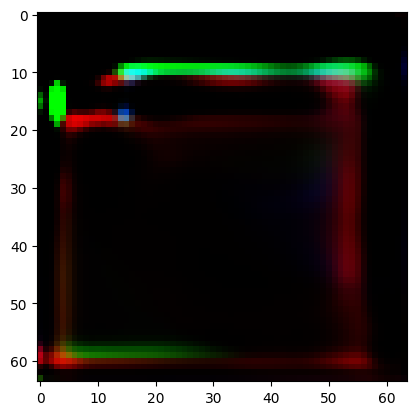

Training Epoch 15:   8%|▊         | 31/377 [06:13<1:06:23, 11.51s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   8%|▊         | 32/377 [06:27<1:09:57, 12.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:   9%|▉         | 33/377 [06:37<1:06:03, 11.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:   9%|▉         | 34/377 [06:50<1:08:33, 11.99s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 15:   9%|▉         | 35/377 [07:03<1:10:43, 12.41s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  10%|▉         | 36/377 [07:13<1:05:34, 11.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  10%|▉         | 37/377 [07:25<1:07:09, 11.85s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  10%|█         | 38/377 [07:39<1:10:24, 12.46s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  10%|█         | 39/377 [07:48<1:04:14, 11.41s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  11%|█         | 40/377 [08:02<1:08:19, 12.16s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

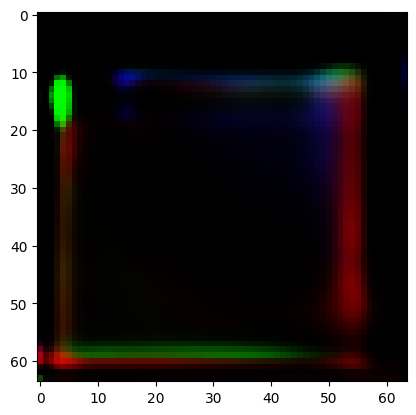

Training Epoch 15:  11%|█         | 41/377 [08:15<1:08:53, 12.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  11%|█         | 42/377 [08:25<1:04:21, 11.53s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:  11%|█▏        | 43/377 [08:37<1:05:19, 11.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  12%|█▏        | 44/377 [08:46<1:01:26, 11.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  12%|█▏        | 45/377 [08:59<1:03:43, 11.52s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:  12%|█▏        | 46/377 [09:12<1:05:36, 11.89s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  12%|█▏        | 47/377 [09:21<1:01:22, 11.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  13%|█▎        | 48/377 [09:36<1:07:46, 12.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  13%|█▎        | 49/377 [09:49<1:08:11, 12.47s/it]

Batch Classes: [0, 2, 3, 5, 7, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 15:  13%|█▎        | 50/377 [09:59<1:03:55, 11.73s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

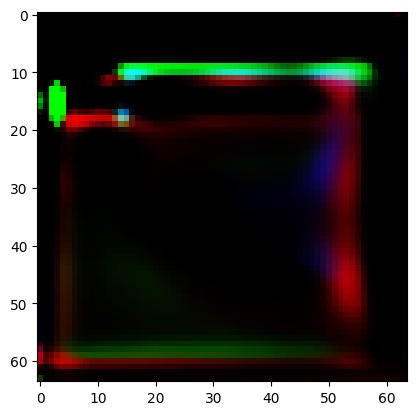

Training Epoch 15:  14%|█▎        | 51/377 [10:13<1:06:56, 12.32s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  14%|█▍        | 52/377 [10:22<1:01:42, 11.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  14%|█▍        | 53/377 [10:36<1:06:30, 12.32s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  14%|█▍        | 54/377 [10:50<1:08:28, 12.72s/it]

Batch Classes: [0, 1, 2, 3, 5, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 15:  15%|█▍        | 55/377 [10:59<1:02:35, 11.66s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 15:  15%|█▍        | 56/377 [11:12<1:04:35, 12.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 15:  15%|█▌        | 57/377 [11:25<1:06:05, 12.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  15%|█▌        | 58/377 [11:35<1:01:08, 11.50s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  16%|█▌        | 59/377 [11:48<1:03:18, 11.94s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 15:  16%|█▌        | 60/377 [11:58<59:54, 11.34s/it]  

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 15:  16%|█▌        | 60/377 [11:59<1:03:19, 11.98s/it]


Epoch 16/50


Training Epoch 16:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

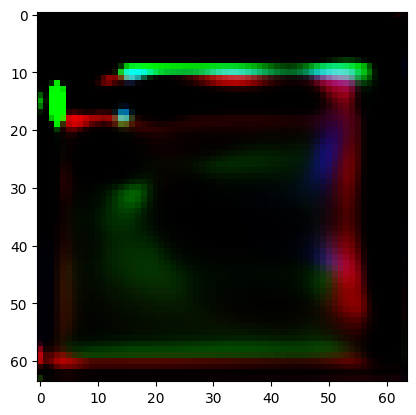

Training Epoch 16:   0%|          | 1/377 [00:16<1:41:55, 16.26s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   1%|          | 2/377 [00:31<1:36:06, 15.38s/it]

FID Score at Epoch 16: 1798.918212890625
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 15
Adversarial Loss: -0.0069
Auxiliary Loss: 0.0008
Feature Matching Loss: 0.0002
Diversity Loss: -0.9996
Generator Gradient Norm for label_embedding.weight: 1.4623811694036704e-05
Generator Gradient Norm for label_embedding.bias: 2.2292446374194697e-05
Generator Gradient Norm for fc.0.weight: 0.0002115563693223521
Generator Gradient Norm for fc.0.bias: 1.7241312889382243e-05
Generator Gradient Norm for fc.1.weight: 6.62388765704236e-06
Generator Gradient Norm for fc.1.bias: 8.342746696143877e-06
Generator Gradient Norm for downsample.weight: 0.14198626577854156
Generator Gradient Norm for downsample.bias: 0.02621343545615673
Generator Gradient Norm for res_blocks.0.block.0.weight: 2.405768327662372e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 4.947874288063758e-08
G

Training Epoch 16:   1%|          | 3/377 [00:43<1:27:44, 14.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   1%|          | 4/377 [00:54<1:18:52, 12.69s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 16:   1%|▏         | 5/377 [01:09<1:24:46, 13.67s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   2%|▏         | 6/377 [01:24<1:27:07, 14.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 16:   2%|▏         | 7/377 [01:34<1:19:22, 12.87s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:   2%|▏         | 8/377 [01:47<1:19:29, 12.92s/it]

Batch Classes: [0, 1, 2, 3, 5, 6], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 6, 1, 0, 0, 5, 0, 5, 1, 3, 6, 2, 6, 1, 2, 0, 3, 2, 1, 2, 6, 1, 3,
        6, 5, 3, 2, 5, 0, 2, 0, 5, 3, 3, 2, 5, 1, 2, 1, 6, 2, 0, 5, 1, 2, 6, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 16:   2%|▏         | 9/377 [02:02<1:22:52, 13.51s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   3%|▎         | 10/377 [02:12<1:15:54, 12.41s/it]

Epoch 15, G Loss: 0.014398242346942425, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

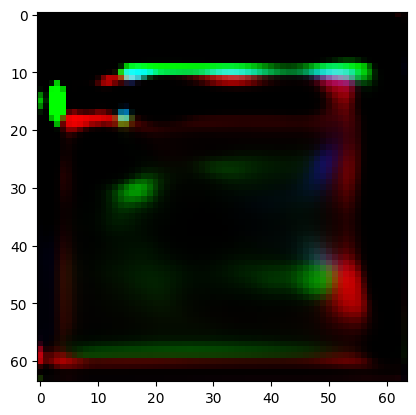

Training Epoch 16:   3%|▎         | 11/377 [02:25<1:17:18, 12.67s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:   3%|▎         | 12/377 [02:40<1:21:06, 13.33s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 16:   3%|▎         | 13/377 [02:50<1:14:49, 12.33s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   4%|▎         | 14/377 [03:03<1:15:02, 12.40s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 16:   4%|▍         | 15/377 [03:18<1:20:29, 13.34s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 16:   4%|▍         | 16/377 [03:28<1:14:00, 12.30s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 16:   5%|▍         | 17/377 [03:41<1:15:02, 12.51s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   5%|▍         | 18/377 [03:56<1:19:28, 13.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 16:   5%|▌         | 19/377 [04:06<1:13:20, 12.29s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:   5%|▌         | 20/377 [04:21<1:17:59, 13.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

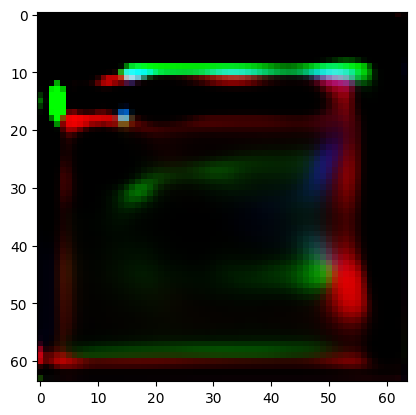

Training Epoch 16:   6%|▌         | 21/377 [04:36<1:20:23, 13.55s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   6%|▌         | 22/377 [04:48<1:17:34, 13.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 16:   6%|▌         | 23/377 [05:00<1:15:24, 12.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   6%|▋         | 24/377 [05:15<1:19:09, 13.45s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 16:   7%|▋         | 25/377 [05:27<1:16:38, 13.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   7%|▋         | 26/377 [05:39<1:13:31, 12.57s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 16:   7%|▋         | 27/377 [05:54<1:18:18, 13.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:   7%|▋         | 28/377 [06:09<1:20:12, 13.79s/it]

Epoch 15, G Loss: 0.011569999158382416, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 16:   8%|▊         | 29/377 [06:19<1:13:15, 12.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 16:   8%|▊         | 30/377 [06:33<1:16:09, 13.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

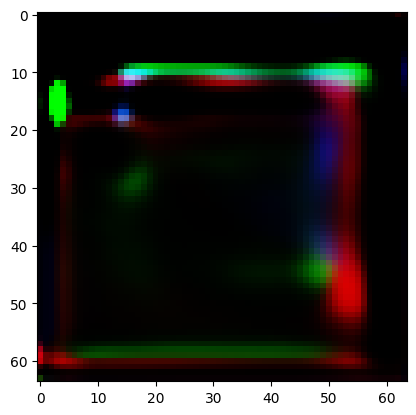

Training Epoch 16:   8%|▊         | 31/377 [06:49<1:20:35, 13.97s/it]

Batch Classes: [0, 1, 2, 4, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 16:   8%|▊         | 32/377 [07:01<1:17:55, 13.55s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 16:   9%|▉         | 33/377 [07:12<1:12:53, 12.71s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:   9%|▉         | 34/377 [07:26<1:15:18, 13.17s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 8, 0, 2, 7, 1, 0, 5, 0, 7, 2, 8, 6, 8, 5, 5, 9, 9, 2, 3, 3, 3, 7,
        1, 5, 9, 7, 6, 5, 7, 0, 3, 0, 8, 6, 6, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 5,
        8, 6], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 16:   9%|▉         | 35/377 [07:42<1:19:10, 13.89s/it]

Epoch 15, G Loss: 0.01884199120104313, D Loss: 0.07842846214771271
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape af

Training Epoch 16:  10%|▉         | 36/377 [07:52<1:11:38, 12.61s/it]

Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 5, 1, 0, 0, 4, 0, 4, 1, 3, 5, 2, 5, 1, 2, 0, 3, 2, 1, 2, 5, 1, 3,
        5, 4, 3, 2, 4, 0, 2, 0, 4, 3, 3, 2, 4, 1, 2, 1, 5, 2, 0, 4, 1, 2, 5, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 16:  10%|▉         | 37/377 [08:05<1:13:23, 12.95s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:  10%|█         | 38/377 [08:17<1:10:57, 12.56s/it]

Epoch 15, G Loss: 0.015525735914707184, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 16:  10%|█         | 39/377 [08:28<1:08:37, 12.18s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:  11%|█         | 40/377 [08:42<1:10:32, 12.56s/it]

Epoch 15, G Loss: 0.011784619651734829, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 4, 8, 6, 4, 3, 6, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

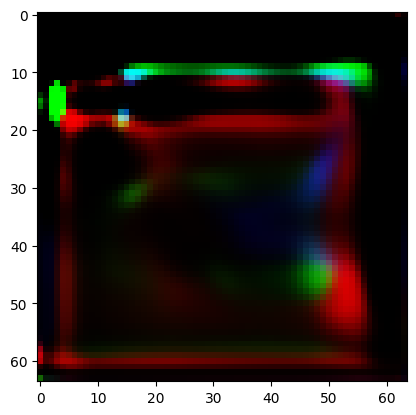

Training Epoch 16:  11%|█         | 41/377 [08:53<1:07:30, 12.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:  11%|█         | 42/377 [09:07<1:10:34, 12.64s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 16:  11%|█▏        | 43/377 [09:21<1:13:24, 13.19s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:  12%|█▏        | 44/377 [09:33<1:10:40, 12.73s/it]

Epoch 15, G Loss: 0.013159293681383133, D Loss: 0.0
Batch Classes: [0, 1, 2, 4, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 1, 7, 0, 0, 4, 0, 7, 2, 7, 5, 8, 4, 4, 8, 8, 1, 4, 2, 2, 7,
        1, 4, 8, 5, 5, 4, 7, 0, 2, 0, 7, 5, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 16:  12%|█▏        | 45/377 [09:45<1:09:09, 12.50s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:  12%|█▏        | 46/377 [09:58<1:10:23, 12.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 16:  12%|█▏        | 47/377 [10:08<1:06:21, 12.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:  13%|█▎        | 48/377 [10:23<1:09:52, 12.74s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 7, 2, 0, 0, 6, 0, 6, 2, 5, 7, 3, 7, 2, 3, 0, 5, 3, 2, 3, 7, 2, 5,
        7, 6, 5, 3, 6, 0, 3, 0, 6, 5, 5, 3, 6, 2, 3, 2, 7, 3, 0, 6, 2, 3, 7, 5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 16:  13%|█▎        | 49/377 [10:37<1:12:07, 13.19s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 16:  13%|█▎        | 50/377 [10:49<1:10:00, 12.85s/it]

Epoch 15, G Loss: 0.009777767583727837, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 10], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 1,  5,  8,  0,  2,  7,  1,  0,  5,  0,  7,  2,  8,  6,  8,  5,  5, 10,
        10,  2,  3,  3,  3,  7,  1,  5, 10,  7,  6,  5,  7,  0,  3,  0,  8,  6,
         6,  3,  8,  1,  3,  2, 10,  2,  1,  7,  2,  5,  8,  6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Au

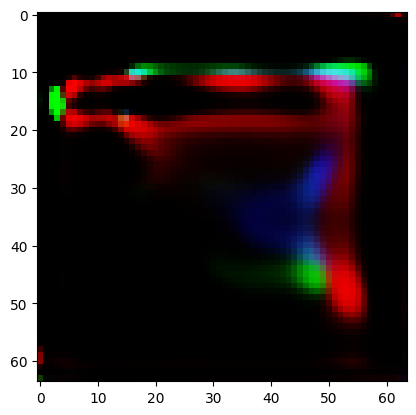

Training Epoch 16:  14%|█▎        | 51/377 [11:00<1:07:05, 12.35s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 16:  14%|█▍        | 52/377 [11:13<1:08:07, 12.58s/it]

Epoch 15, G Loss: -0.01092424988746643, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 16:  14%|█▍        | 53/377 [11:25<1:05:35, 12.15s/it]

Epoch 15, G Loss: 0.009462808258831501, D Loss: 0.07817412912845612
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 16:  14%|█▍        | 54/377 [11:38<1:08:17, 12.69s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

Training Epoch 16:  15%|█▍        | 55/377 [11:54<1:12:10, 13.45s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 16:  15%|█▍        | 56/377 [12:06<1:09:25, 12.98s/it]

Epoch 15, G Loss: 0.013851494528353214, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 16:  15%|█▌        | 57/377 [12:17<1:06:20, 12.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 16:  15%|█▌        | 58/377 [12:32<1:09:55, 13.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 16:  16%|█▌        | 59/377 [12:47<1:13:25, 13.85s/it]

Epoch 15, G Loss: 0.010382989421486855, D Loss: 0.0849052220582962
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after At

Training Epoch 16:  16%|█▌        | 60/377 [12:57<1:07:04, 12.70s/it]

Batch Classes: [0, 1, 2, 4, 5, 6, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 16:  16%|█▌        | 60/377 [12:58<1:08:32, 12.97s/it]


Epoch 17/50


Training Epoch 17:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

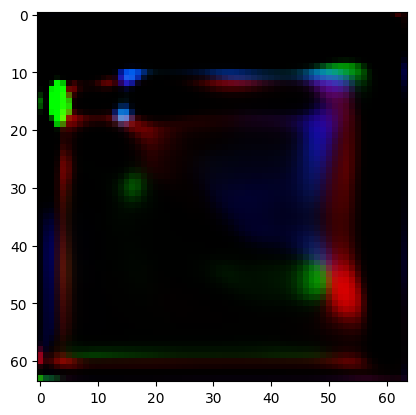

Training Epoch 17:   0%|          | 1/377 [00:16<1:44:25, 16.66s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   1%|          | 2/377 [00:31<1:36:42, 15.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:   1%|          | 3/377 [00:43<1:26:21, 13.85s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise

Training Epoch 17:   1%|          | 4/377 [00:55<1:21:01, 13.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:   1%|▏         | 5/377 [01:09<1:23:25, 13.46s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:   2%|▏         | 6/377 [01:20<1:19:20, 12.83s/it]

Batch Classes: [0, 1, 2, 4, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 1, 7, 0, 0, 4, 0, 7, 2, 7, 5, 8, 4, 4, 8, 8, 1, 4, 2, 2, 7,
        1, 4, 8, 5, 5, 4, 7, 0, 2, 0, 7, 5, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 17:   2%|▏         | 7/377 [01:33<1:18:07, 12.67s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   2%|▏         | 8/377 [01:47<1:20:20, 13.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:   2%|▏         | 9/377 [02:00<1:19:56, 13.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   3%|▎         | 10/377 [02:10<1:14:57, 12.25s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

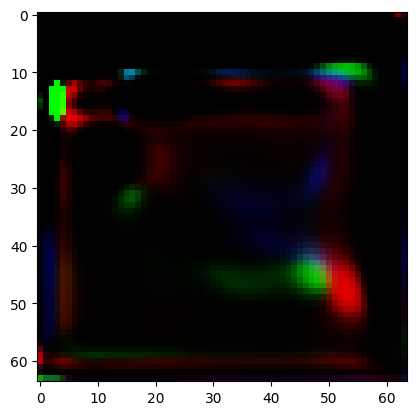

Training Epoch 17:   3%|▎         | 11/377 [02:25<1:20:42, 13.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   3%|▎         | 12/377 [02:37<1:17:37, 12.76s/it]

Epoch 16, G Loss: -0.01106245443224907, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 17:   3%|▎         | 13/377 [02:48<1:14:07, 12.22s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   4%|▎         | 14/377 [03:01<1:15:21, 12.46s/it]

Epoch 16, G Loss: 0.013979234732687473, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 17:   4%|▍         | 15/377 [03:11<1:11:12, 11.80s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   4%|▍         | 16/377 [03:24<1:12:40, 12.08s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:   5%|▍         | 17/377 [03:39<1:17:29, 12.92s/it]

Epoch 16, G Loss: 0.016091765835881233, D Loss: 0.08424049615859985
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape a

Training Epoch 17:   5%|▍         | 18/377 [03:49<1:11:18, 11.92s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:   5%|▌         | 19/377 [04:03<1:16:08, 12.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:   5%|▌         | 20/377 [04:18<1:18:55, 13.27s/it]

Epoch 16, G Loss: 0.019001834094524384, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

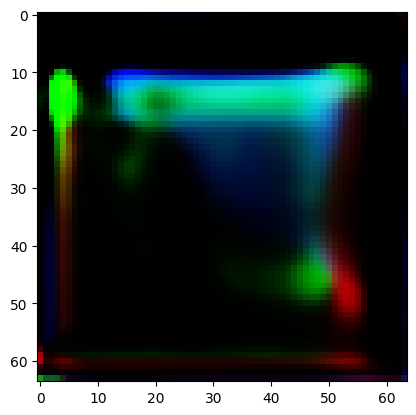

Training Epoch 17:   6%|▌         | 21/377 [04:29<1:15:01, 12.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 17:   6%|▌         | 22/377 [04:42<1:16:19, 12.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:   6%|▌         | 23/377 [04:56<1:17:23, 13.12s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   6%|▋         | 24/377 [05:06<1:11:41, 12.19s/it]

Epoch 16, G Loss: 0.009465821087360382, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 17:   7%|▋         | 25/377 [05:20<1:15:02, 12.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:   7%|▋         | 26/377 [05:35<1:18:33, 13.43s/it]

Epoch 16, G Loss: 0.014300419017672539, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 17:   7%|▋         | 27/377 [05:48<1:17:52, 13.35s/it]

Batch Classes: [0, 2, 3, 5, 7, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 17:   7%|▋         | 28/377 [06:00<1:13:51, 12.70s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:   8%|▊         | 29/377 [06:15<1:18:14, 13.49s/it]

Batch Classes: [0, 2, 3, 5, 6, 7], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 17:   8%|▊         | 30/377 [06:27<1:15:20, 13.03s/it]

Epoch 16, G Loss: 0.013432187028229237, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

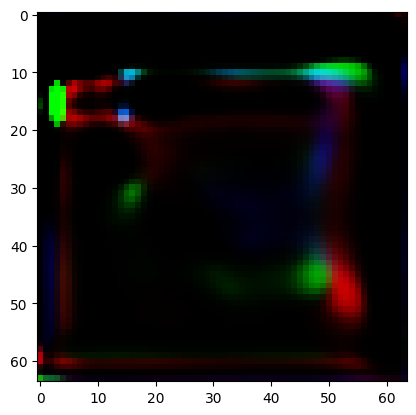

Training Epoch 17:   8%|▊         | 31/377 [06:38<1:11:54, 12.47s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], Counts: [5, 4, 3, 4, 5, 4, 3, 5, 3, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([44, 12])
Label embedding input shape: torch.Size([44, 12])
Shape after embedded_labels: torch.Size([44, 100])
Shape of combined (noise + embedded labels): torch.Size([44, 200])
Shape after self.fc: torch.Size([44, 4096])
Shape after reshaping out: torch.Size([44, 256, 4, 4])
Shape after downsampling out: torch.Size([44, 128, 4, 4])
Shape after residual block: torch.Size([44, 128, 4, 4])
Shape after Attention block: torch.Size([44, 128, 4, 4])
Shape

Training Epoch 17:   8%|▊         | 32/377 [06:52<1:14:42, 12.99s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:   9%|▉         | 33/377 [07:05<1:14:14, 12.95s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:   9%|▉         | 34/377 [07:15<1:09:13, 12.11s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:   9%|▉         | 35/377 [07:30<1:14:18, 13.04s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:  10%|▉         | 36/377 [07:43<1:12:42, 12.79s/it]

Epoch 16, G Loss: 0.014845696277916431, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 5, 1, 0, 0, 4, 0, 4, 1, 3, 5, 2, 5, 1, 2, 0, 3, 2, 1, 2, 5, 1, 3,
        5, 4, 3, 2, 4, 0, 2, 0, 4, 3, 3, 2, 4, 1, 2, 1, 5, 2, 0, 4, 1, 2, 5, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator ..................

Training Epoch 17:  10%|▉         | 37/377 [07:53<1:08:52, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 11], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise injec

Training Epoch 17:  10%|█         | 38/377 [08:08<1:12:24, 12.82s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:  10%|█         | 39/377 [08:23<1:16:37, 13.60s/it]

Epoch 16, G Loss: 0.010989009402692318, D Loss: 0.08228939771652222
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape a

Training Epoch 17:  11%|█         | 40/377 [08:33<1:10:11, 12.50s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

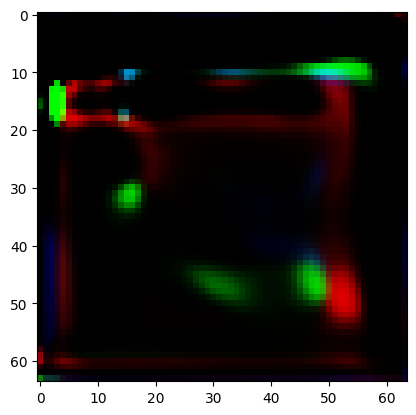

Training Epoch 17:  11%|█         | 41/377 [08:49<1:15:28, 13.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:  11%|█         | 42/377 [09:04<1:17:34, 13.89s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:  11%|█▏        | 43/377 [09:16<1:14:23, 13.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:  12%|█▏        | 44/377 [09:28<1:11:23, 12.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:  12%|█▏        | 45/377 [09:41<1:12:46, 13.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 17:  12%|█▏        | 46/377 [09:56<1:14:34, 13.52s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 7, 3, 3, 7, 7, 1, 3, 2, 2, 6,
        1, 3, 7, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 17:  12%|█▏        | 47/377 [10:06<1:08:40, 12.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:  13%|█▎        | 48/377 [10:20<1:11:07, 12.97s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:  13%|█▎        | 49/377 [10:35<1:14:24, 13.61s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:  13%|█▎        | 50/377 [10:45<1:08:01, 12.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

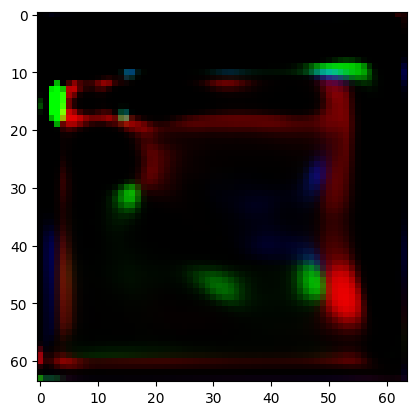

Training Epoch 17:  14%|█▎        | 51/377 [10:59<1:10:46, 13.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:  14%|█▍        | 52/377 [11:14<1:13:02, 13.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:  14%|█▍        | 53/377 [11:24<1:07:52, 12.57s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 17:  14%|█▍        | 54/377 [11:37<1:08:52, 12.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:  15%|█▍        | 55/377 [11:52<1:11:24, 13.31s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 17:  15%|█▍        | 56/377 [12:02<1:06:05, 12.35s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([2, 5, 7, 0, 3, 7, 2, 0, 5, 0, 6, 3, 7, 6, 7, 4, 4, 8, 8, 2, 4, 4, 4, 6,
        2, 5, 8, 6, 5, 4, 6, 7, 0, 3, 0, 8, 5, 5, 3, 7, 2, 3, 3, 8, 3, 0, 6, 2,
        4, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 17:  15%|█▌        | 57/377 [12:17<1:10:11, 13.16s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 17:  15%|█▌        | 58/377 [12:31<1:10:37, 13.28s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 17:  16%|█▌        | 59/377 [12:43<1:09:24, 13.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 17:  16%|█▌        | 60/377 [12:56<1:08:09, 12.90s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12


Training Epoch 17:  16%|█▌        | 60/377 [12:57<1:08:25, 12.95s/it]


Epoch 18/50


Training Epoch 18:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

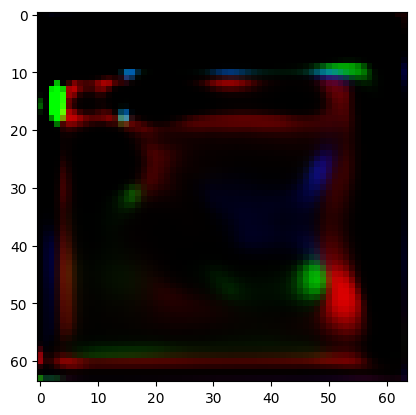

Training Epoch 18:   0%|          | 1/377 [00:16<1:44:02, 16.60s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:   1%|          | 2/377 [00:30<1:34:57, 15.19s/it]

Epoch 17, G Loss: -0.01114720106124878, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator ......

Training Epoch 18:   1%|          | 3/377 [00:41<1:21:46, 13.12s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   1%|          | 4/377 [00:55<1:24:15, 13.55s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 7, 3, 3, 7, 7, 1, 3, 2, 2, 6,
        1, 3, 7, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 18:   1%|▏         | 5/377 [01:10<1:27:11, 14.06s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise

Training Epoch 18:   2%|▏         | 6/377 [01:22<1:22:40, 13.37s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 18:   2%|▏         | 7/377 [01:34<1:19:24, 12.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 18:   2%|▏         | 8/377 [01:47<1:19:11, 12.88s/it]

Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 5, 1, 0, 0, 4, 0, 4, 1, 3, 5, 2, 5, 1, 2, 0, 3, 2, 1, 2, 5, 1, 3,
        5, 4, 3, 2, 4, 0, 2, 0, 4, 3, 3, 2, 4, 1, 2, 1, 5, 2, 0, 4, 1, 2, 5, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

Training Epoch 18:   2%|▏         | 9/377 [01:57<1:14:32, 12.15s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:   3%|▎         | 10/377 [02:10<1:15:29, 12.34s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

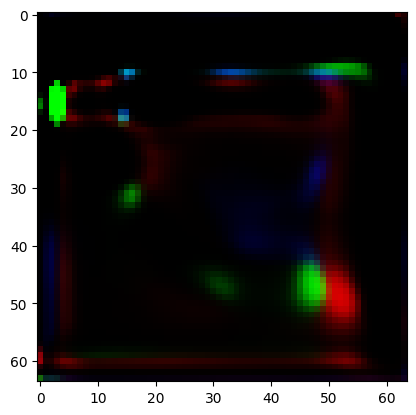

Training Epoch 18:   3%|▎         | 11/377 [02:26<1:21:06, 13.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   3%|▎         | 12/377 [02:38<1:18:23, 12.89s/it]

Epoch 17, G Loss: -0.011169548146426678, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .....

Training Epoch 18:   3%|▎         | 13/377 [02:50<1:16:38, 12.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 18:   4%|▎         | 14/377 [03:03<1:17:47, 12.86s/it]

Epoch 17, G Loss: 0.014680111780762672, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 18:   4%|▍         | 15/377 [03:15<1:16:02, 12.60s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 18:   4%|▍         | 16/377 [03:28<1:17:02, 12.80s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:   5%|▍         | 17/377 [03:43<1:20:54, 13.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   5%|▍         | 18/377 [03:55<1:17:29, 12.95s/it]

Epoch 17, G Loss: 0.010684809647500515, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generat

Training Epoch 18:   5%|▌         | 19/377 [04:08<1:16:16, 12.78s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   5%|▌         | 20/377 [04:21<1:17:35, 13.04s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

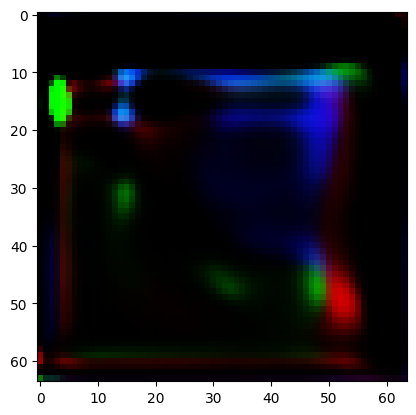

Training Epoch 18:   6%|▌         | 21/377 [04:37<1:22:52, 13.97s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   6%|▌         | 22/377 [04:47<1:15:27, 12.75s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 18:   6%|▌         | 23/377 [05:01<1:17:47, 13.19s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   6%|▋         | 24/377 [05:17<1:20:58, 13.76s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 18:   7%|▋         | 25/377 [05:27<1:15:06, 12.80s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   7%|▋         | 26/377 [05:40<1:15:53, 12.97s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 18:   7%|▋         | 27/377 [05:55<1:17:38, 13.31s/it]

Epoch 17, G Loss: 0.016217771917581558, D Loss: 0.08285665512084961
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 18:   7%|▋         | 28/377 [06:06<1:14:13, 12.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:   8%|▊         | 29/377 [06:20<1:16:38, 13.21s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:   8%|▊         | 30/377 [06:35<1:19:11, 13.69s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

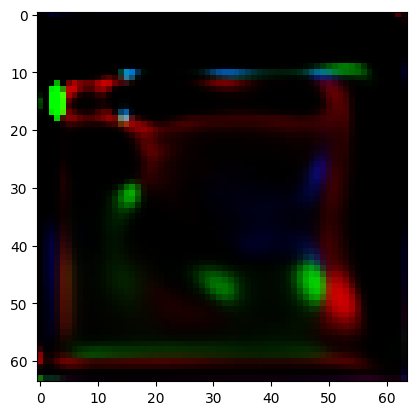

Training Epoch 18:   8%|▊         | 31/377 [06:49<1:18:45, 13.66s/it]

Batch Classes: [0, 1, 2, 3, 5, 7, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:   8%|▊         | 32/377 [06:59<1:13:15, 12.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:   9%|▉         | 33/377 [07:14<1:16:25, 13.33s/it]

FID Score at Epoch 18: 1646.84423828125
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 17
Adversarial Loss: -0.0068
Auxiliary Loss: 0.9957
Feature Matching Loss: 0.0012
Diversity Loss: -0.9996
Generator Gradient Norm for label_embedding.weight: 2.282557397847995e-05
Generator Gradient Norm for label_embedding.bias: 3.574480797396973e-05
Generator Gradient Norm for fc.0.weight: 0.00041276024421676993
Generator Gradient Norm for fc.0.bias: 2.425534330541268e-05
Generator Gradient Norm for fc.1.weight: 1.1523696230142377e-05
Generator Gradient Norm for fc.1.bias: 1.2071507626387756e-05
Generator Gradient Norm for downsample.weight: 0.14969713985919952
Generator Gradient Norm for downsample.bias: 0.027418356388807297
Generator Gradient Norm for res_blocks.0.block.0.weight: 3.725422175193671e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 7.051480110931152e-08


Training Epoch 18:   9%|▉         | 34/377 [07:28<1:17:49, 13.61s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:   9%|▉         | 35/377 [07:38<1:11:05, 12.47s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:  10%|▉         | 36/377 [07:52<1:12:54, 12.83s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:  10%|▉         | 37/377 [08:08<1:17:49, 13.74s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 18:  10%|█         | 38/377 [08:18<1:11:18, 12.62s/it]

Epoch 17, G Loss: 0.011458870954811573, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gene

Training Epoch 18:  10%|█         | 39/377 [08:32<1:13:48, 13.10s/it]

Batch Classes: [0, 1, 2, 5, 6, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 18:  11%|█         | 40/377 [08:45<1:14:10, 13.21s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

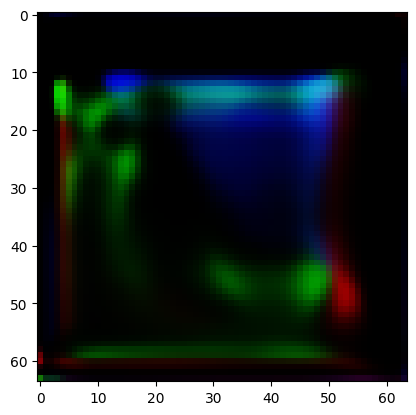

Training Epoch 18:  11%|█         | 41/377 [08:56<1:09:41, 12.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:  11%|█         | 42/377 [09:09<1:10:39, 12.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:  11%|█▏        | 43/377 [09:24<1:13:35, 13.22s/it]

Epoch 17, G Loss: 0.010045255534350872, D Loss: 0.08024514466524124
Batch Classes: [0, 1, 2, 3, 4, 5, 7, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after A

Training Epoch 18:  12%|█▏        | 44/377 [09:34<1:08:36, 12.36s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:  12%|█▏        | 45/377 [09:48<1:11:38, 12.95s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:  12%|█▏        | 46/377 [10:01<1:11:33, 12.97s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 18:  12%|█▏        | 47/377 [10:12<1:07:15, 12.23s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:  13%|█▎        | 48/377 [10:26<1:10:29, 12.86s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 18:  13%|█▎        | 49/377 [10:41<1:13:29, 13.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10], Counts: [5, 4, 3, 4, 5, 4, 3, 5, 3, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([44, 12])
Label embedding input shape: torch.Size([44, 12])
Shape after embedded_labels: torch.Size([44, 100])
Shape of combined (noise + embedded labels): torch.Size([44, 200])
Shape after self.fc: torch.Size([44, 4096])
Shape after reshaping out: torch.Size([44, 256, 4, 4])
Shape after downsampling out: torch.Size([44, 128, 4, 4])
Shape after residual block: torch.Size([44, 128, 4, 4])
Shape after Attention block: torch.Size([44, 128, 4, 4])
Shape

Training Epoch 18:  13%|█▎        | 50/377 [10:53<1:10:09, 12.87s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

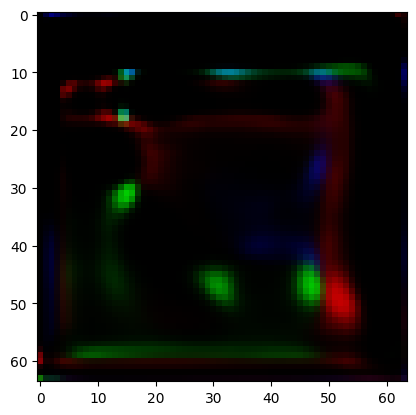

Training Epoch 18:  14%|█▎        | 51/377 [11:04<1:08:09, 12.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:  14%|█▍        | 52/377 [11:18<1:09:35, 12.85s/it]

Epoch 17, G Loss: -0.011335253715515137, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Genera

Training Epoch 18:  14%|█▍        | 53/377 [11:29<1:06:35, 12.33s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 18:  14%|█▍        | 54/377 [11:41<1:06:15, 12.31s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 18:  15%|█▍        | 55/377 [11:55<1:08:15, 12.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise

Training Epoch 18:  15%|█▍        | 56/377 [12:06<1:05:29, 12.24s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 18:  15%|█▌        | 57/377 [12:21<1:09:12, 12.98s/it]

Batch Classes: [0, 1, 2, 3, 5, 8], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 18:  15%|█▌        | 58/377 [12:35<1:11:31, 13.45s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 18:  16%|█▌        | 59/377 [12:47<1:08:25, 12.91s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 18:  16%|█▌        | 60/377 [12:59<1:07:02, 12.69s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12


Training Epoch 18:  16%|█▌        | 60/377 [13:00<1:08:43, 13.01s/it]


Epoch 19/50


Training Epoch 19:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

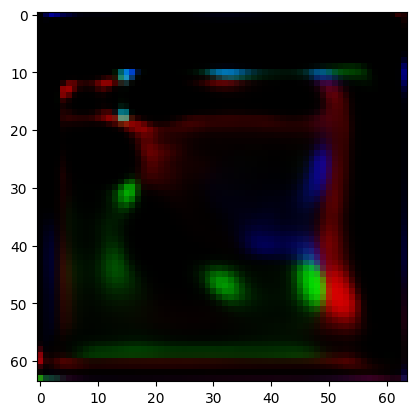

Training Epoch 19:   0%|          | 1/377 [00:16<1:43:08, 16.46s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:   1%|          | 2/377 [00:31<1:36:12, 15.39s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:   1%|          | 3/377 [00:42<1:23:53, 13.46s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:   1%|          | 4/377 [00:56<1:25:01, 13.68s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 7, 3, 3, 7, 7, 1, 3, 2, 2, 5,
        1, 3, 7, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 7, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 19:   1%|▏         | 5/377 [01:10<1:25:18, 13.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   2%|▏         | 6/377 [01:22<1:22:08, 13.29s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 11], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([ 1,  4,  8,  0,  2,  6,  1,  0,  4,  0,  6,  2,  8,  5,  8,  4,  4, 11,
        11,  2,  3,  3,  3,  6,  1,  4, 11,  6,  5,  4,  6,  0,  3,  0,  8,  5,
         5,  3,  8,  1,  3,  2, 11,  2,  1,  6,  2,  4,  8,  5],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Insid

Training Epoch 19:   2%|▏         | 7/377 [01:34<1:18:53, 12.79s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   2%|▏         | 8/377 [01:48<1:22:16, 13.38s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:   2%|▏         | 9/377 [02:01<1:20:58, 13.20s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   3%|▎         | 10/377 [02:14<1:20:07, 13.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

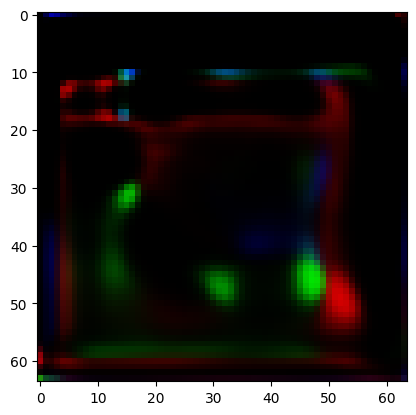

Training Epoch 19:   3%|▎         | 11/377 [02:30<1:24:59, 13.93s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 19:   3%|▎         | 12/377 [02:45<1:27:01, 14.31s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:   3%|▎         | 13/377 [02:55<1:18:49, 12.99s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   4%|▎         | 14/377 [03:10<1:21:54, 13.54s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:   4%|▍         | 15/377 [03:26<1:25:34, 14.18s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   4%|▍         | 16/377 [03:38<1:21:22, 13.53s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:   5%|▍         | 17/377 [03:49<1:18:04, 13.01s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:   5%|▍         | 18/377 [04:05<1:21:39, 13.65s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:   5%|▌         | 19/377 [04:19<1:22:08, 13.77s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   5%|▌         | 20/377 [04:28<1:14:29, 12.52s/it]

Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([3, 0, 5, 1, 0, 0, 4, 0, 4, 1, 3, 5, 2, 5, 1, 2, 0, 3, 2, 1, 2, 5, 1, 3,
        5, 4, 3, 2, 4, 0, 2, 0, 4, 3, 3, 2, 4, 1, 2, 1, 5, 2, 0, 4, 1, 2, 5, 3],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels before processing: torch

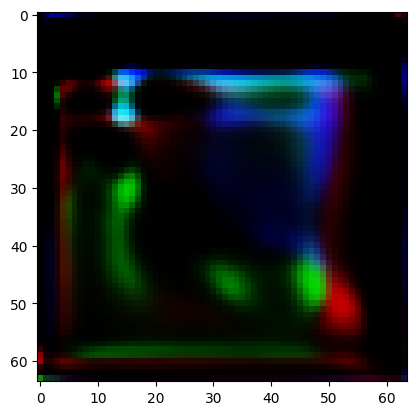

Training Epoch 19:   6%|▌         | 21/377 [04:43<1:18:09, 13.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5], Counts: [8, 8, 10, 8, 7, 7]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after Noise injection: torch.

Training Epoch 19:   6%|▌         | 22/377 [04:57<1:19:44, 13.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:   6%|▌         | 23/377 [05:07<1:14:07, 12.56s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 19:   6%|▋         | 24/377 [05:21<1:15:16, 12.79s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 6, 0, 1, 6, 0, 0, 3, 0, 6, 2, 6, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 6,
        1, 3, 8, 5, 5, 3, 6, 0, 2, 0, 6, 5, 3, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        6, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 19:   7%|▋         | 25/377 [05:37<1:20:21, 13.70s/it]

Epoch 18, G Loss: 0.012636091560125351, D Loss: 0.08695711195468903
Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape a

Training Epoch 19:   7%|▋         | 26/377 [05:47<1:14:26, 12.73s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:   7%|▋         | 27/377 [06:02<1:18:17, 13.42s/it]

Batch Classes: [0, 1, 2, 3, 4, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:   7%|▋         | 28/377 [06:18<1:21:44, 14.05s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 7, 1, 0, 4, 0, 5, 2, 7, 5, 7, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 7, 0, 2, 0, 8, 4, 4, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 7, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:   8%|▊         | 29/377 [06:33<1:23:21, 14.37s/it]

Epoch 18, G Loss: 0.006434404291212559, D Loss: 0.08715831488370895
Batch Classes: [0, 1, 2, 3, 4, 5, 7], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attenti

Training Epoch 19:   8%|▊         | 30/377 [06:42<1:14:54, 12.95s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

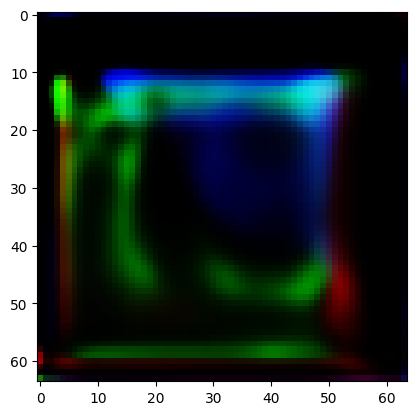

Training Epoch 19:   8%|▊         | 31/377 [06:59<1:21:41, 14.17s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:   8%|▊         | 32/377 [07:13<1:20:40, 14.03s/it]

Epoch 18, G Loss: -0.0114015843719244, D Loss: 0.0
Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Gener

Training Epoch 19:   9%|▉         | 33/377 [07:25<1:16:03, 13.27s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:   9%|▉         | 34/377 [07:39<1:17:03, 13.48s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:   9%|▉         | 35/377 [07:54<1:20:18, 14.09s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:  10%|▉         | 36/377 [08:08<1:19:47, 14.04s/it]

Batch Classes: [0, 1, 2, 3, 5, 7, 8, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 8, 0, 2, 8, 1, 0, 5, 0, 7, 2, 8, 7, 8, 3, 3, 9, 9, 1, 3, 3, 3, 7,
        1, 5, 9, 7, 5, 3, 7, 8, 0, 2, 0, 9, 5, 5, 2, 8, 1, 2, 2, 9, 2, 0, 7, 1,
        3, 8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:  10%|▉         | 37/377 [08:20<1:15:33, 13.33s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:  10%|█         | 38/377 [08:34<1:17:13, 13.67s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:  10%|█         | 39/377 [08:50<1:20:34, 14.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:  11%|█         | 40/377 [09:05<1:21:02, 14.43s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([5, 0, 8, 2, 1, 1, 6, 0, 7, 3, 5, 9, 4, 9, 2, 4, 1, 5, 4, 2, 4, 9, 1, 5,
        8, 6, 6, 4, 7, 0, 3, 0, 7, 6, 5, 3, 8, 1, 3, 3, 9, 3, 1, 7, 2, 4, 8, 6],
       device='cuda:0')
Shape of Real Images (with Noise): torch.Size([48, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([48, 3, 64, 64])
Shape of labels: torch.Size([48, 12, 64, 64])
Input Shape to initial_conv: torch.Size([48, 15, 64, 64])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Validity Shape: torch.Size([48, 1])
Auxiliary Prediction Shape: torch.Size([48, 12])
Inside Generator .............................
Shape of labels b

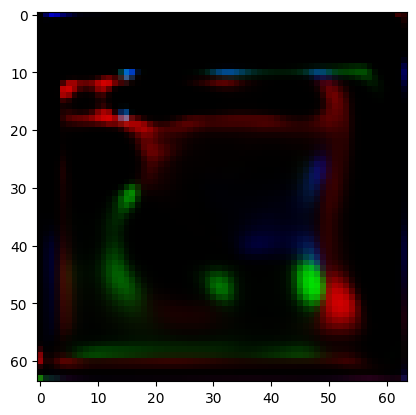

Training Epoch 19:  11%|█         | 41/377 [09:15<1:13:56, 13.20s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:  11%|█         | 42/377 [09:28<1:13:21, 13.14s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 7, 0, 2, 6, 1, 0, 4, 0, 6, 2, 7, 5, 7, 4, 4, 8, 8, 2, 3, 3, 3, 6,
        1, 4, 8, 6, 5, 4, 6, 0, 3, 0, 7, 5, 5, 3, 7, 1, 3, 2, 8, 2, 1, 6, 2, 4,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:  11%|█▏        | 43/377 [09:40<1:12:04, 12.95s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:  12%|█▏        | 44/377 [09:51<1:07:09, 12.10s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 7, 7, 1, 3, 3, 3, 5,
        1, 4, 7, 5, 4, 3, 5, 6, 0, 2, 0, 7, 4, 4, 2, 6, 1, 2, 2, 7, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:  12%|█▏        | 45/377 [10:06<1:12:05, 13.03s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

Training Epoch 19:  12%|█▏        | 46/377 [10:18<1:10:09, 12.72s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 6, 0, 2, 6, 1, 0, 4, 0, 5, 2, 6, 5, 6, 3, 3, 8, 8, 1, 3, 3, 3, 5,
        1, 4, 8, 5, 4, 3, 5, 6, 0, 2, 0, 8, 4, 4, 2, 6, 1, 2, 2, 8, 2, 0, 5, 1,
        3, 6, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:  12%|█▏        | 47/377 [10:29<1:07:39, 12.30s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 19:  13%|█▎        | 48/377 [10:44<1:11:54, 13.11s/it]

FID Score at Epoch 19: 1561.769775390625
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 18
Adversarial Loss: -0.0065
Auxiliary Loss: 0.9046
Feature Matching Loss: 0.0008
Diversity Loss: -0.9995
Generator Gradient Norm for label_embedding.weight: 2.7474363378132693e-05
Generator Gradient Norm for label_embedding.bias: 3.446745176916011e-05
Generator Gradient Norm for fc.0.weight: 0.0004738488350994885
Generator Gradient Norm for fc.0.bias: 2.8751597710652277e-05
Generator Gradient Norm for fc.1.weight: 1.369893470837269e-05
Generator Gradient Norm for fc.1.bias: 1.4719403225171845e-05
Generator Gradient Norm for downsample.weight: 0.1583893597126007
Generator Gradient Norm for downsample.bias: 0.029333263635635376
Generator Gradient Norm for res_blocks.0.block.0.weight: 5.018512638343964e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 6.42675459516795e-08
G

Training Epoch 19:  13%|█▎        | 49/377 [10:56<1:09:57, 12.80s/it]

Epoch 18, G Loss: 0.0159623846411705, D Loss: 0.09130404144525528
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention

Training Epoch 19:  13%|█▎        | 50/377 [11:09<1:09:11, 12.70s/it]

Batch Classes: [0, 1, 2, 3, 5, 7, 8], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 7, 0, 1, 7, 0, 0, 3, 0, 7, 2, 7, 5, 8, 3, 3, 8, 8, 1, 3, 2, 2, 7,
        1, 3, 8, 5, 5, 3, 7, 0, 2, 0, 7, 5, 3, 2, 7, 1, 2, 2, 8, 2, 0, 5, 1, 3,
        7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

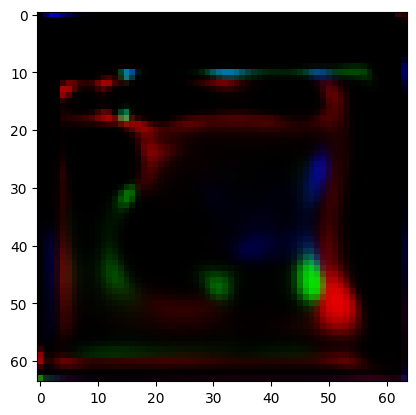

Training Epoch 19:  14%|█▎        | 51/377 [11:24<1:14:03, 13.63s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:  14%|█▍        | 52/377 [11:37<1:12:27, 13.38s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 3, 5, 0, 1, 5, 0, 0, 3, 0, 5, 2, 5, 4, 6, 3, 3, 6, 6, 1, 3, 2, 2, 5,
        1, 3, 6, 4, 4, 3, 5, 0, 2, 0, 5, 4, 3, 2, 5, 1, 2, 2, 6, 2, 0, 4, 1, 3,
        5, 4], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels before proce

Training Epoch 19:  14%|█▍        | 53/377 [11:48<1:08:43, 12.73s/it]

FID Score at Epoch 19: 1764.1424560546875
adv_loss requires_grad: True
aux_loss requires_grad: True
feature_matching_loss requires_grad: True
diversity_loss requires_grad: True
g_loss requires_grad: True
Epoch 18
Adversarial Loss: -0.0059
Auxiliary Loss: 0.7474
Feature Matching Loss: 0.0008
Diversity Loss: -0.9995
Generator Gradient Norm for label_embedding.weight: 4.2885440052486956e-05
Generator Gradient Norm for label_embedding.bias: 5.21377514814958e-05
Generator Gradient Norm for fc.0.weight: 0.00048644596245139837
Generator Gradient Norm for fc.0.bias: 3.301328615634702e-05
Generator Gradient Norm for fc.1.weight: 1.4523331628879532e-05
Generator Gradient Norm for fc.1.bias: 1.5546567738056183e-05
Generator Gradient Norm for downsample.weight: 0.15951287746429443
Generator Gradient Norm for downsample.bias: 0.029593748971819878
Generator Gradient Norm for res_blocks.0.block.0.weight: 4.613393230101792e-06
Generator Gradient Norm for res_blocks.0.block.0.bias: 7.175366079081869e-0

Training Epoch 19:  14%|█▍        | 54/377 [12:03<1:10:55, 13.18s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 6, 1, 0, 4, 0, 6, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 6,
        1, 4, 9, 6, 5, 4, 6, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 6, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:  15%|█▍        | 55/377 [12:18<1:14:45, 13.93s/it]

Epoch 18, G Loss: 0.012534305453300476, D Loss: 0.08453743159770966
Batch Classes: [0, 1, 2, 3, 4, 5, 6], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attenti

Training Epoch 19:  15%|█▍        | 56/377 [12:29<1:08:33, 12.81s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 7, 8, 9], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 4, 8, 0, 2, 7, 1, 0, 4, 0, 7, 2, 8, 5, 8, 4, 4, 9, 9, 2, 3, 3, 3, 7,
        1, 4, 9, 7, 5, 4, 7, 0, 3, 0, 8, 5, 5, 3, 8, 1, 3, 2, 9, 2, 1, 7, 2, 4,
        8, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([50, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([50, 3, 64, 64])
Shape of labels: torch.Size([50, 12, 64, 64])
Input Shape to initial_conv: torch.Size([50, 15, 64, 64])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Validity Shape: torch.Size([50, 1])
Auxiliary Prediction Shape: torch.Size([50, 12])
Inside Generator .............................
Shape of labels 

Training Epoch 19:  15%|█▌        | 57/377 [12:44<1:12:25, 13.58s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8, 9], Counts: [4, 6, 4, 6, 6, 5, 5, 4, 4, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([48, 12])
Label embedding input shape: torch.Size([48, 12])
Shape after embedded_labels: torch.Size([48, 100])
Shape of combined (noise + embedded labels): torch.Size([48, 200])
Shape after self.fc: torch.Size([48, 4096])
Shape after reshaping out: torch.Size([48, 256, 4, 4])
Shape after downsampling out: torch.Size([48, 128, 4, 4])
Shape after residual block: torch.Size([48, 128, 4, 4])
Shape after Attention block: torch.Size([48, 128, 4, 4])
Shape after 

Training Epoch 19:  15%|█▌        | 58/377 [12:58<1:12:27, 13.63s/it]

Batch Classes: [0, 1, 2, 3, 5, 6, 7, 8], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
all_labels------------------------>12
labels------------------------>tensor([1, 5, 7, 0, 2, 7, 1, 0, 5, 0, 6, 2, 7, 6, 7, 3, 3, 8, 8, 1, 3, 3, 3, 6,
        1, 5, 8, 6, 5, 3, 6, 7, 0, 2, 0, 8, 5, 5, 2, 7, 1, 2, 2, 8, 2, 0, 6, 1,
        3, 7, 5], device='cuda:0')
Shape of Real Images (with Noise): torch.Size([51, 3, 64, 64])
Inside Discriminator ..............................
Shape of images: torch.Size([51, 3, 64, 64])
Shape of labels: torch.Size([51, 12, 64, 64])
Input Shape to initial_conv: torch.Size([51, 15, 64, 64])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Validity Shape: torch.Size([51, 1])
Auxiliary Prediction Shape: torch.Size([51, 12])
Inside Generator .............................
Shape of labels bef

Training Epoch 19:  16%|█▌        | 59/377 [13:11<1:11:12, 13.44s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

Training Epoch 19:  16%|█▌        | 60/377 [13:22<1:07:25, 12.76s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12


Training Epoch 19:  16%|█▌        | 60/377 [13:23<1:10:43, 13.39s/it]


Epoch 20/50
Freezing Discriminator for this epoch...


Training Epoch 20:   0%|          | 0/377 [00:00<?, ?it/s]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7, 8], Counts: [5, 5, 6, 6, 7, 5, 6, 6, 4]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise 

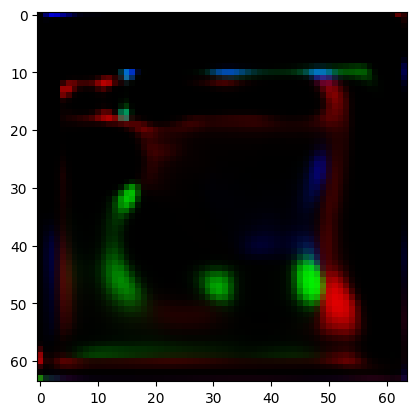

Training Epoch 20:   0%|          | 1/377 [00:15<1:37:38, 15.58s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 20:   1%|          | 2/377 [00:28<1:27:56, 14.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 7], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 20:   1%|          | 3/377 [00:40<1:21:27, 13.07s/it]

Batch Classes: [0, 1, 2, 3, 4, 5, 6, 9], Counts: [6, 6, 7, 7, 7, 6, 7, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([51, 12])
Label embedding input shape: torch.Size([51, 12])
Shape after embedded_labels: torch.Size([51, 100])
Shape of combined (noise + embedded labels): torch.Size([51, 200])
Shape after self.fc: torch.Size([51, 4096])
Shape after reshaping out: torch.Size([51, 256, 4, 4])
Shape after downsampling out: torch.Size([51, 128, 4, 4])
Shape after residual block: torch.Size([51, 128, 4, 4])
Shape after Attention block: torch.Size([51, 128, 4, 4])
Shape after Noise inject

Training Epoch 20:   1%|          | 4/377 [00:55<1:26:03, 13.84s/it]

Batch Classes: [0, 2, 3, 4, 5, 6, 9], Counts: [7, 6, 8, 9, 6, 9, 5]
Observed unique classes: 12
.......................................................
Training Discrimnator
.......................................................
Discriminator frozen. Retaining previous d_loss: 0.0
.......................................................
Training Generator...............
.......................................................
Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: t

In [ ]:
train_dir = "/content/dataset/train"
val_dir = "/content/dataset/val"
d_losses, g_losses, val_d_losses, val_g_losses = train_gan(mean_real_data, std_real_data, train_loader, val_loader, epochs=50, device='cuda', accumulation_steps=4)

Inside Generator .............................
Shape of labels before processing: torch.Size([50, 12])
Label embedding input shape: torch.Size([50, 12])
Shape after embedded_labels: torch.Size([50, 100])
Shape of combined (noise + embedded labels): torch.Size([50, 200])
Shape after self.fc: torch.Size([50, 4096])
Shape after reshaping out: torch.Size([50, 256, 4, 4])
Shape after downsampling out: torch.Size([50, 128, 4, 4])
Shape after residual block: torch.Size([50, 128, 4, 4])
Shape after Attention block: torch.Size([50, 128, 4, 4])
Shape after Noise injection: torch.Size([50, 128, 4, 4])
Shape before deconvolution: torch.Size([50, 128, 4, 4])
Final shape deconvolution: torch.Size([50, 3, 128, 128])
Min pixel value: -0.9838283658027649
Max pixel value: 0.995931088924408
Shape after Deconvolution layers: torch.Size([50, 3, 128, 128])
Generated fake images shape: torch.Size([50, 3, 128, 128])
Generated fake images shape: torch.Size([50, 3, 128, 128])


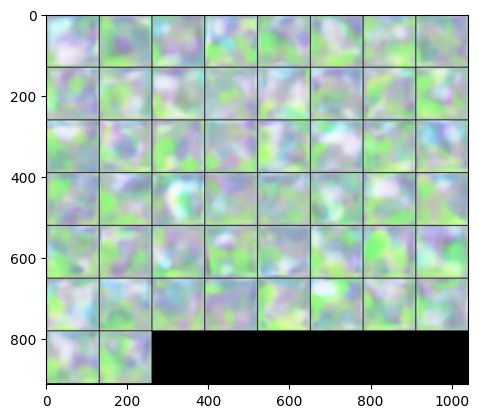

In [ ]:
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
generator = Generator(noise_dim=100, output_dim=3, label_dim=12)
real_images, labels = next(iter(train_loader))  # real_images.size(0) = 51
batch_size = real_images.size(0)
device = "cpu"
# Generate noise and labels
noise = torch.randn(batch_size, 100).to(device)
labels_one_hot = torch.eye(12)[labels].to(device)

# Forward pass through the generator
fake_images = generator(noise, labels_one_hot)

# Check output shape
print("Generated fake images shape:", fake_images.shape)  # Should match [batch_size, 3, 128, 128]
print("Generated fake images shape:", real_images.shape)
assert fake_images.shape == real_images.shape, "Mismatch between fake and real images shape!"
fake_images = (fake_images + 1) / 2.0
fake_images = fake_images.clamp(0, 1)

for name, param in generator.named_parameters():
    if "label_embedding" in name and param.grad is not None:
        print(f"{name} gradient norm: {param.grad.norm()}")


# Convert to a grid for visualization
fake_images = (fake_images + 1) / 2  # Scale from [-1, 1] to [0, 1]
grid = make_grid(fake_images)

# Show the generated image
plt.imshow(grid.permute(1, 2, 0).cpu().numpy())
plt.show()


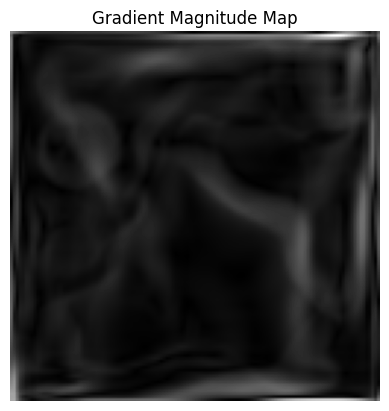

In [ ]:
from torch.nn.functional import conv2d

# Define a Sobel filter for gradient computation
sobel_filter = torch.tensor([[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]], dtype=torch.float32).unsqueeze(0).unsqueeze(0)

# Expand Sobel filter to process RGB images
sobel_filter = sobel_filter.repeat(1, 3, 1, 1).to(fake_images.device)  # Shape: [1, 3, 3, 3]
# Compute gradients for a single image (e.g., the first one in the batch)
image = fake_images[0].unsqueeze(0)  # Shape: [1, 3, 128, 128]
grad_x = conv2d(image, sobel_filter)  # Horizontal gradients
grad_y = conv2d(image, sobel_filter.transpose(-2, -1))  # Vertical gradients

# Compute gradient magnitude
grad_magnitude = torch.sqrt(grad_x**2 + grad_y**2).squeeze().detach().numpy()

# Visualize the gradient map
plt.imshow(grad_magnitude, cmap='gray')
plt.title("Gradient Magnitude Map")
plt.axis('off')
plt.show()

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9379140734672546
Max pixel value: 0.6641180515289307
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


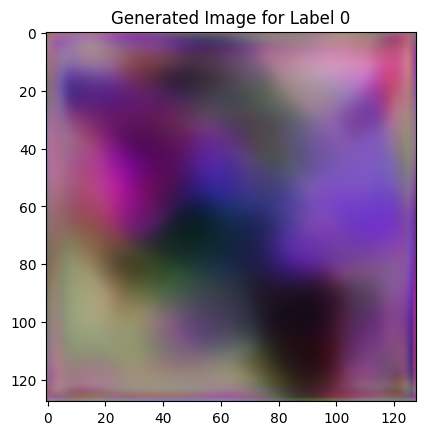

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.8928086161613464
Max pixel value: 0.5790268182754517
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


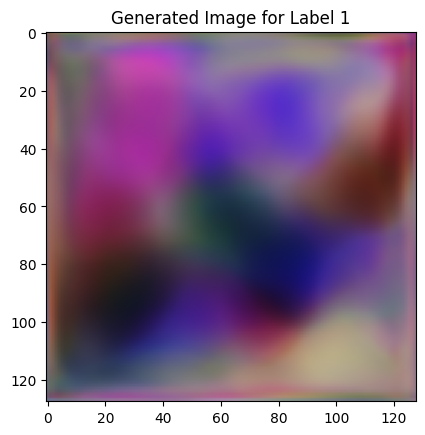

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9563055038452148
Max pixel value: 0.6042082905769348
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


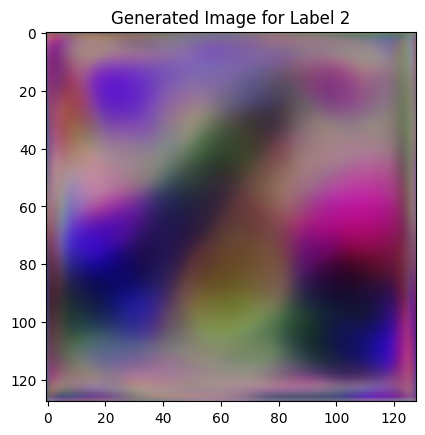

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9899636507034302
Max pixel value: 0.46172434091567993
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


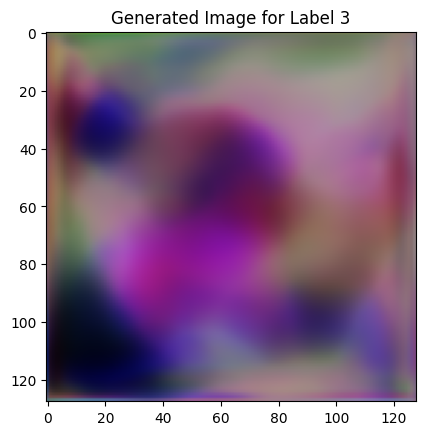

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9849135875701904
Max pixel value: 0.7597855925559998
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


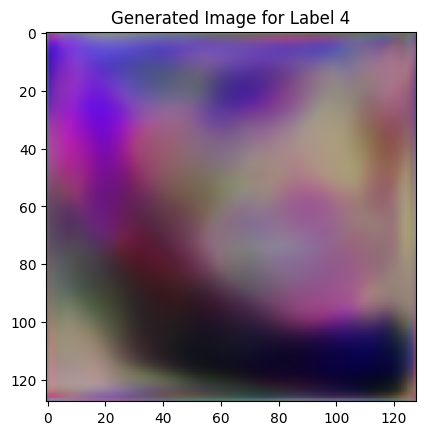

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9463988542556763
Max pixel value: 0.772365391254425
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


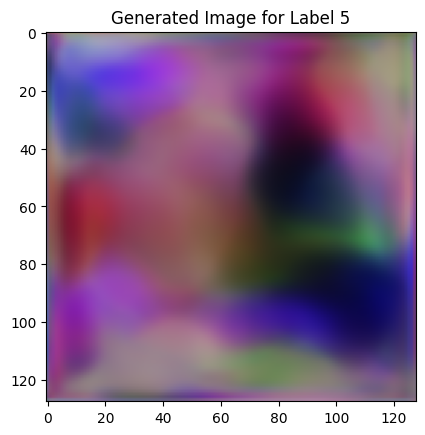

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9381959438323975
Max pixel value: 0.5956711173057556
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


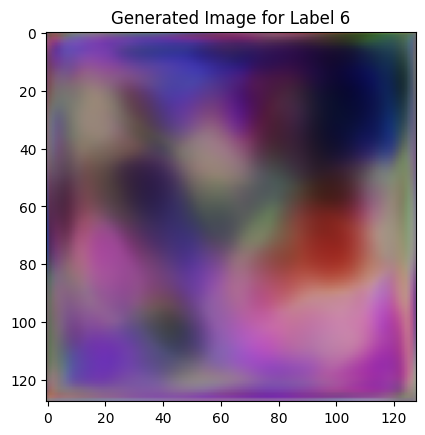

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9749035835266113
Max pixel value: 0.6616538763046265
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


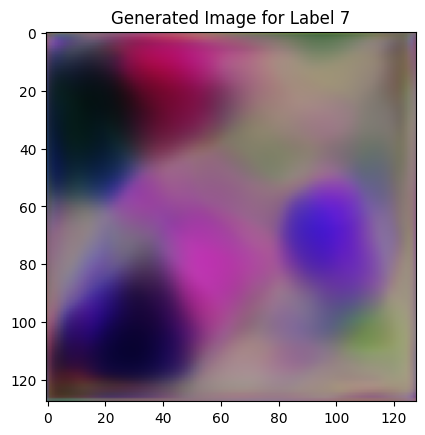

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9625632762908936
Max pixel value: 0.5448834300041199
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


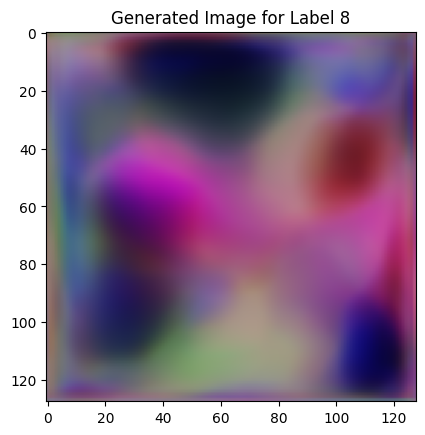

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9266015291213989
Max pixel value: 0.6984332799911499
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


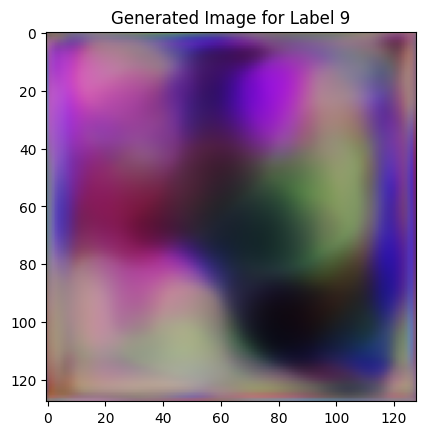

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.946190357208252
Max pixel value: 0.7109823822975159
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


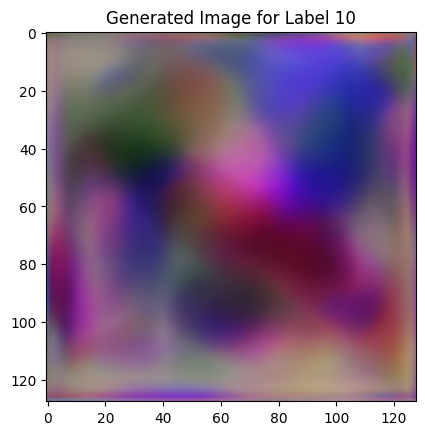

Inside Generator .............................
Shape of labels before processing: torch.Size([1, 12])
Label embedding input shape: torch.Size([1, 12])
Shape after embedded_labels: torch.Size([1, 100])
Shape of combined (noise + embedded labels): torch.Size([1, 200])
Shape after self.fc: torch.Size([1, 4096])
Shape after reshaping out: torch.Size([1, 256, 4, 4])
Shape after downsampling out: torch.Size([1, 128, 4, 4])
Shape after residual block: torch.Size([1, 128, 4, 4])
Shape after Attention block: torch.Size([1, 128, 4, 4])
Shape after Noise injection: torch.Size([1, 128, 4, 4])
Shape before deconvolution: torch.Size([1, 128, 4, 4])
Final shape deconvolution: torch.Size([1, 3, 128, 128])
Min pixel value: -0.9784590005874634
Max pixel value: 0.643826425075531
Shape after Deconvolution layers: torch.Size([1, 3, 128, 128])


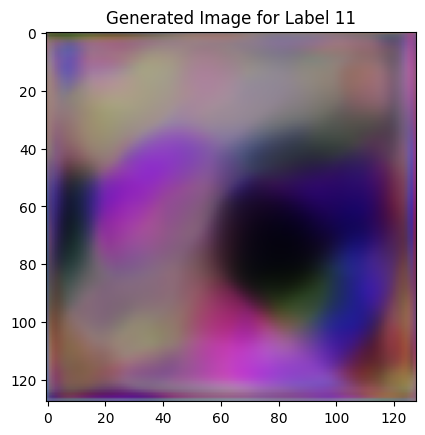

In [ ]:
label_dim = 12
noise_dim = 100
device="cpu"
generator = Generator(noise_dim=100, output_dim=3, label_dim=12)
for label in range(label_dim):  # Iterate over unique classes
    labels_one_hot = torch.zeros((1, label_dim)).to(device)  # Create one-hot vector
    labels_one_hot[0, label] = 1  # Set the corresponding class to 1
    noise = torch.randn(1, noise_dim).to(device)  # Generate random noise
    fake_image = generator(noise, labels_one_hot)  # Generate the fake image

    # Visualize the generated image
    plt.imshow((fake_image[0].permute(1, 2, 0).cpu().detach().numpy() + 1) / 2)
    plt.title(f"Generated Image for Label {label}")
    plt.show()